**last update: 08/19/2024**  

This notebook is for Bayesian Gaussian process regression test.

Dataset: 5*5 spatial average in latitude(-15,-10) longitude(35,40). CMIP6 annually, 1850 -2100. 16 models. Short-term oscillations(<10years). Consider long-term trend.

Goal: Select proper kernel structures for CMIP6 data.

Design: Test different kernel structures with CMIP6 annual data and give evaluations(log marginal likelihood, recorded in the markdown cell), for sum of periods & poly(periodic transform). Also for some kernels, consider the evolving uncertainty with more observation years.

Note: In this notebook, there is cross validation(leave-one-out) for 2 rounds(one for kernel structure's selection, one for hyperparameter tuning(not included in this notebook)). Use the mean value of other models as prior, one model as the virtual observation and plot. Each model will be taken as the virtual observation once(1 round), and the total lml for all the models(all rounds) is used as the evaluation.

# Package

In [9]:
import numpy as np
from sklearn.model_selection import GridSearchCV
from tqdm import tqdm
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.gaussian_process.kernels import RBF, WhiteKernel, ExpSineSquared, ConstantKernel as C
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import RandomizedSearchCV, ParameterGrid
from scipy.optimize import minimize
from pyswarm import pso
from bayes_opt import BayesianOptimization
from scipy.linalg import cholesky, cho_solve,cho_factor,solve_triangular
from scipy.signal import periodogram, welch
from scipy.fft import fft
from statsmodels.tsa.stattools import acf
from sklearn.gaussian_process.kernels import Kernel, WhiteKernel, Matern, RationalQuadratic as RQ, ConstantKernel as C
from sklearn.preprocessing import PolynomialFeatures
from sklearn.gaussian_process import GaussianProcessRegressor
import pywt
from sklearn.gaussian_process.kernels import RBF, ConstantKernel as C, Matern, RationalQuadratic, DotProduct
from sklearn.preprocessing import PolynomialFeatures
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
from statsmodels.graphics.tsaplots import plot_acf
from bayes_opt import BayesianOptimization, UtilityFunction
from properscoring import crps_gaussian
from sklearn.preprocessing import StandardScaler
from sklearn.gaussian_process.kernels import RBF, WhiteKernel

# Data

In [6]:
rainfall = pd.read_csv('../data/CMIP5_s/s_annual_pr_1850-2099.csv')
rainfall = rainfall.set_index('years',drop=True)
rainfall.columns = [i+1 for i in range(rainfall.shape[1])]

## detrend

In [10]:
rainfall_yearly = rainfall.copy()

for column in rainfall.columns:
    # Filter data before 1950
    historical_data = rainfall.loc[rainfall.index < 1950, column]
    
    # Calculate mean and std
    mean_value = historical_data.mean()
    std_value = historical_data.std()
    
    # Standardize the column using mean and std
    rainfall_yearly[column] = (rainfall[column] - mean_value) / std_value

# Save the standardized data to a new CSV file
# export_path = "../data/CMIP5_s/scaled_s_annual_pr_1850-2100.csv"
# rainfall_yearly.to_csv(export_path)

In [11]:
rainfall_yearly

,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16
years,,,,,,,,,,,,,,,,
1850,0.564701,-0.954973,0.805075,0.883522,0.408721,1.033045,0.323265,0.907077,-1.747807,-0.615323,-0.416121,0.927181,0.448216,-0.395735,0.320778,2.340198
1851,0.492328,0.205289,0.979917,-0.226115,-0.435929,0.719702,0.067075,1.834414,-0.523527,-0.386419,0.550706,-1.051017,0.514671,-1.398234,0.459281,2.664433
1852,0.946445,0.916011,0.385936,0.229262,-0.508718,1.305073,0.434112,-0.576242,0.784074,-0.484144,-0.250587,-0.946392,-0.623163,0.314186,0.433215,-0.460535
1853,0.584740,1.301670,-0.398833,-0.664563,1.070098,0.143495,-1.839704,-1.274652,-0.091335,-3.159363,0.547587,0.614313,-0.751967,-0.751419,-0.471728,1.558306
1854,0.652209,0.669318,0.752729,0.845128,-1.750147,-2.176522,0.454248,-0.516035,0.149882,-0.601625,-0.875747,-0.746138,-1.263021,-0.477946,0.507692,0.146323
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2095,0.513079,2.385927,-0.635235,-1.194065,1.171497,0.600308,-0.963112,-0.434212,-0.726360,-1.275698,0.249687,-0.575514,-0.430957,-0.713208,-1.398685,-0.219123
2096,-0.523259,-0.222206,1.655021,2.267893,1.323304,-0.018935,-1.439923,1.749815,-2.840558,-0.510423,0.738514,0.883885,-1.234700,1.630735,0.431471,-1.174150
2097,0.613384,1.315963,-0.514259,-0.927190,-1.481462,0.020787,0.271282,-0.017440,0.956462,0.617658,1.155792,0.379757,3.008620,-0.768478,0.185402,-1.143826


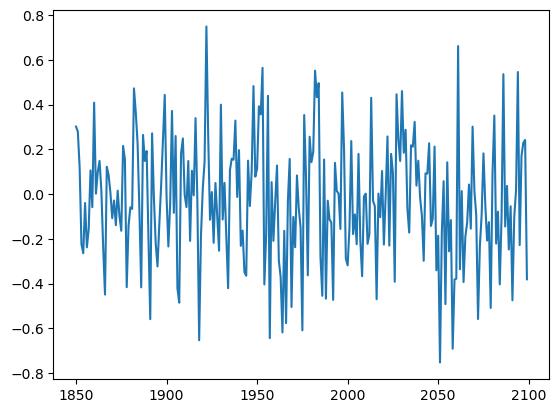

In [12]:
plt.plot(rainfall_yearly.T.mean())

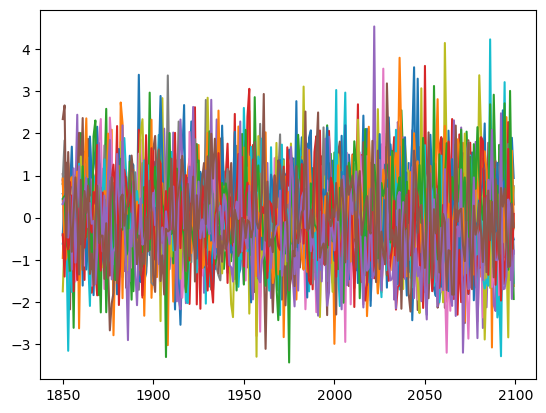

In [13]:
plt.plot(rainfall_yearly)

In [11]:
mod_ids = range(0, rainfall_yearly.shape[1])
Nobs = 166 # 1850-2015
year = np.array(rainfall_yearly.index)

# Periodic Analysis

In [17]:
# Function to plot and return the top 3 periodicities for each method
def analyze_periodicity(data):
    results = {}
    
    # Convert data to numpy array for FFT
    data = np.asarray(data)
    
    # Fourier Transform
    N = len(data)
    T = 1.0
    yf = fft(data)
    xf = np.fft.fftfreq(N, T)[:N//2]
    fft_amplitudes = 2.0/N * np.abs(yf[0:N//2])
    
    # Avoid division by zero
    non_zero_freqs = xf != 0
    xf = xf[non_zero_freqs]
    fft_amplitudes = fft_amplitudes[non_zero_freqs]
    
    fft_peaks = np.argsort(fft_amplitudes)[-3:]
    fft_periods = 1 / xf[fft_peaks]
    results['FFT'] = fft_periods
    
    # Wavelet Transform
    widths = np.arange(1, 31)
    cwt_matr = pywt.cwt(data, widths, 'mexh')[0]
    wavelet_power = np.sum(cwt_matr**2, axis=1)
    wavelet_peaks = np.argsort(wavelet_power)[-3:]
    wavelet_periods = widths[wavelet_peaks]
    results['Wavelet'] = wavelet_periods
    
    # Autocorrelation
    autocorr = acf(data, nlags=N//2)
    autocorr_peaks = np.argsort(autocorr)[-3:]
    results['Autocorrelation'] = autocorr_peaks
    
    # Power Spectral Density
    freqs, psd = periodogram(data)
    non_zero_freqs = freqs != 0
    freqs = freqs[non_zero_freqs]
    psd = psd[non_zero_freqs]
    
    psd_peaks = np.argsort(psd)[-3:]
    psd_periods = 1 / freqs[psd_peaks]
    results['PSD'] = psd_periods
    
    return results

# Perform the analysis for each of the 16 models
all_results = []
for col in rainfall_yearly.columns:
    data = rainfall_yearly[col]
    results = analyze_periodicity(data)
    all_results.append(results)

# Aggregate and print the results
for method in ['FFT', 'Wavelet', 'Autocorrelation', 'PSD']:
    print(f"Top 3 periodicities for {method}:")
    for i, result in enumerate(all_results):
        print(f"Model {i+1}: {result[method]}")
    print("\n")

Top 3 periodicities for FFT:
Model 1: [ 5.55555556  4.54545455 41.66666667]
Model 2: [ 2.7173913   2.52525253 50.        ]
Model 3: [2.04918033 2.65957447 3.01204819]
Model 4: [2.10084034 2.55102041 2.5       ]
Model 5: [2.57731959 5.81395349 5.        ]
Model 6: [ 3.37837838 83.33333333 41.66666667]
Model 7: [  2.55102041   4.16666667 125.        ]
Model 8: [5.55555556 4.71698113 2.15517241]
Model 9: [5.95238095 2.19298246 2.52525253]
Model 10: [2.55102041 5.95238095 3.67647059]
Model 11: [17.85714286  4.38596491 62.5       ]
Model 12: [  6.09756098 250.           2.87356322]
Model 13: [ 2.27272727 27.77777778  4.03225806]
Model 14: [  2.5         17.85714286 250.        ]
Model 15: [  8.62068966   8.06451613 250.        ]
Model 16: [6.57894737 2.84090909 9.25925926]


Top 3 periodicities for Wavelet:
Model 1: [14 13 12]
Model 2: [30 11 10]
Model 3: [4 3 2]
Model 4: [11  9 10]
Model 5: [28 29 30]
Model 6: [13 11 12]
Model 7: [28 29 30]
Model 8: [4 2 3]
Model 9: [10 12 11]
Model 10: [2

# Function

In [12]:
def log_marginal_likelihood_manual(kernel, y_train):
    L = np.linalg.cholesky(kernel)
    alpha = cho_solve((L, True), y_train)
    log_likelihood = -0.5 * np.dot(y_train.T, alpha)
    log_likelihood -= np.sum(np.log(np.diag(L)))
    log_likelihood -= len(y_train) / 2 * np.log(2 * np.pi)
    return log_likelihood

def Choleskey_trick(A, diff, K_os):
    L = np.linalg.cholesky(A)
    alpha = np.linalg.solve(L.T, np.linalg.solve(L, diff))
    v = np.linalg.solve(L, K_os)
    return alpha, v, L

def compute_prior_and_posterior(K_full, y_train, y_test, Nobs):#y_train is all series of training models
    K_o = K_full[:Nobs, :Nobs]
    K_s = K_full[Nobs:, Nobs:]
    K_os = K_full[:Nobs, Nobs:]

    tmp = np.vstack((y_train.iloc[:Nobs, :], y_train))
    smoothedMean = np.mean(tmp, axis=1)
    mu = smoothedMean[:Nobs]
    mu_s = smoothedMean[Nobs:]

    y = y_test[:Nobs].values
    diff = y - mu
    if diff.ndim == 1:
        diff = diff[:, np.newaxis]

    A = K_o+ 1e-6 * np.eye(K_o.shape[0])
    eigenvalues = np.linalg.eigvalsh(A)
    assert np.all(eigenvalues >= 0)
    alpha, v, L = Choleskey_trick(A, diff ,K_os)
        # Compute the posterior mean f
    f = mu_s + np.dot(K_os.T, alpha).ravel()    
        # Compute the posterior covariance Sigma_s
    Sigma_s = K_s - np.dot(v.T, v)
        #compute log marginal likelihood
    lml = -0.5 * (np.dot(diff.T, alpha) + 2*np.sum(np.log(np.diag(L)))).item()  #convert to a scaler 

    prior_mu = mu_s
    prior_cov = K_s
    post_mu = f
    post_cov = Sigma_s

    return prior_mu, prior_cov, post_mu, post_cov, lml

In [13]:
def kernel_selection(mod_ids, Nobs, data, pbounds, kernel_func):
    np.float = np.float64

    def compute_KGCM(training_data, Nobs):
        tmp = np.vstack((training_data.iloc[:Nobs, :], training_data))
        smoothedCov = np.cov(tmp, rowvar=True)
        KGCM = (16 / 15) * smoothedCov
        return KGCM

    def gp_target(train_data, KGCM, current_mod_ids, **params):
        total_lml = 0.0
        kernel = kernel_func(params)
        for mod_id in current_mod_ids:
            if mod_id >= train_data.shape[1]:
                print(f"mod_id {mod_id} is out of bounds for train_data with {train_data.shape[1]} columns.")
                continue
            try:
                oos_gcm = train_data.iloc[:, mod_id].values
            except IndexError as e:
                print(f"IndexError for mod_id {mod_id}: {e}")
                continue

            X_train = np.arange(Nobs).reshape(-1, 1)
            y_train = oos_gcm[:Nobs]

            try:
                K_kernel = kernel(X_train, X_train)
                K_combined = K_kernel + KGCM + 1e-6 * np.eye(K_kernel.shape[0])
                lml = log_marginal_likelihood_manual(K_combined, y_train)
                
                if np.isreal(lml):
                    total_lml += lml
                else:
                    total_lml -= np.inf
            except (TypeError, np.linalg.LinAlgError) as e:
                print("Error in kernel construction or GP fitting:", e)
                total_lml -= np.inf

        return total_lml

    total_lml_sum = 0.0
    
    for i in range(len(mod_ids)):
        print(f"Starting iteration {i+1} out of {len(mod_ids)}")
        
        train_mod_ids = [mod_id for idx, mod_id in enumerate(mod_ids) if idx != i]
        test_mod_id = mod_ids[i]
        
        if test_mod_id >= len(data.columns):
            print(f"Test mod_id {test_mod_id} is out of bounds for data with {len(data.columns)} columns.")
            continue
        
        train_data = data.iloc[:, train_mod_ids]
        test_data = data.iloc[:, test_mod_id]
        KGCM = compute_KGCM(train_data, Nobs)
        KGCM_o = KGCM[:Nobs, :Nobs]
        
        optimizer = BayesianOptimization(
            f=lambda **params: gp_target(train_data, KGCM_o, list(range(len(train_mod_ids))), **params), 
            pbounds=pbounds, 
            random_state=90
        )

        init_points = 50
        n_iter = 50

        best_params = None

        with tqdm(total=init_points + n_iter, desc=f"Optimization Progress (iteration {i+1})") as pbar:
            try:
                optimizer.maximize(init_points=init_points, n_iter=n_iter)
                pbar.update(init_points + n_iter)
            except Exception as e:
                print("An error occurred during optimization:", e)
                if 'params' in optimizer.max:
                    best_params = optimizer.max['params']
                    kernel = kernel_func(best_params)
                else:
                    best_params = None

                    
        print(f"Iteration {i+1} - Best objective function value: {optimizer.max['target']}")
        
        if best_params is not None:
            try:
                kernel = kernel_func(best_params)
                print("Best kernel is:", kernel)

                X_full = np.arange(data.shape[0]+Nobs).reshape(-1, 1)
                K_full = kernel(X_full, X_full)
                prior_mu, prior_cov, post_mu, post_cov, lml_all = compute_prior_and_posterior(K_full, train_data, test_data, Nobs)

                if np.isreal(lml_all):
                    total_lml_sum += lml_all
                    print(f"Iteration {i+1} - test lml: {lml_all}")
                else:
                    total_lml_sum -= np.inf

                plot_prior_posterior(year, test_data, prior_mu, prior_cov, post_mu, post_cov)

            except KeyError:
                print("No valid parameters found after the optimization process.")
                continue
            
    print(f"Total log marginal likelihood sum for the kernel structure: {total_lml_sum}")
    return total_lml_sum


week8_s_CMIP6_test

In [14]:
def plot_prior_posterior(X, obs, prior_mu, prior_cov, post_mu, post_cov):
    std_prior = np.sqrt(np.diag(prior_cov))
    std_post = np.sqrt(np.diag(post_cov))
    
    def rgb_to_normalized(rgb):
        return [x / 255.0 for x in rgb]
    
    plt.figure(figsize=(10, 6))
    plt.fill_between(X.flatten(), post_mu - 1.96*std_post, post_mu + 1.96*std_post, alpha=0.2, color=rgb_to_normalized((164, 81, 79)), label='Posterior 95% CI')
    plt.plot(X, obs, color=rgb_to_normalized((191, 177, 208)), label='Virtual Observation')
    plt.plot(X, prior_mu, color=rgb_to_normalized((255, 235, 173)), label='Prior Mean')
    # plt.fill_between(X.flatten(), prior_mu - 1.96*std_prior, prior_mu + 1.96*std_prior, alpha=0.2, color='blue', label='Prior 95% CI')
    plt.plot(X, post_mu, color=rgb_to_normalized((164, 81, 79)), label='Posterior Mean')
    plt.axvline(x=year[Nobs], color='grey', linestyle='--', label='Historical/Future Split')
    plt.title('Prior vs Posterior')
    plt.xlabel('X')
    plt.ylabel('y')
    plt.legend()
    plt.show()



# Kernel Selection

Test different kernels. Note that '_' means the sum of kernel, and kernel1kernel2 means kernel1*kernel2. Number means how many kernels we use of the same structure.

With other kernels to be implementation. Such as some kernels to make an addition or product.

## sum of periods

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.462e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.114e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.695e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.353e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.634e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.118e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -7.119e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.153e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2693.4771144023803
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 1 - test lml: -96.49994842430844


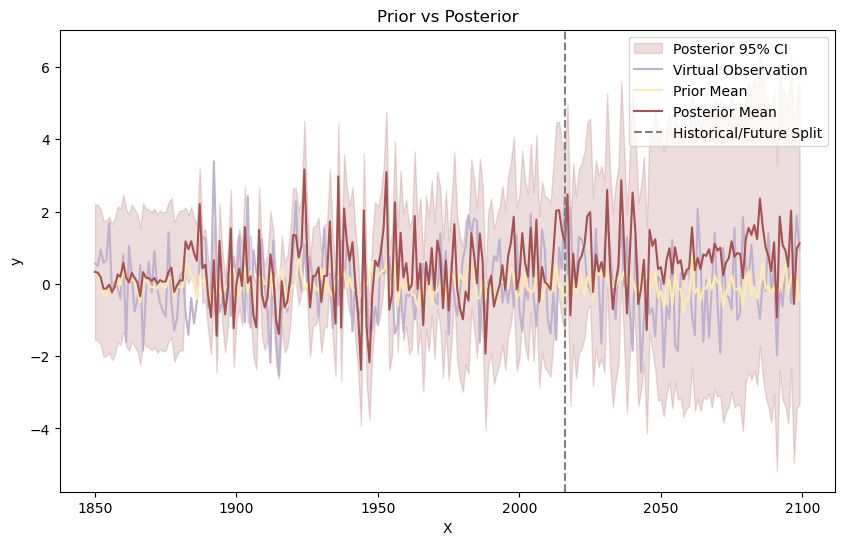

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.415e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.102e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.524e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.386e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.676e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.422e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 2 - Best objective function value: -2681.9934485616805
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 2 - test lml: -94.98229776720576


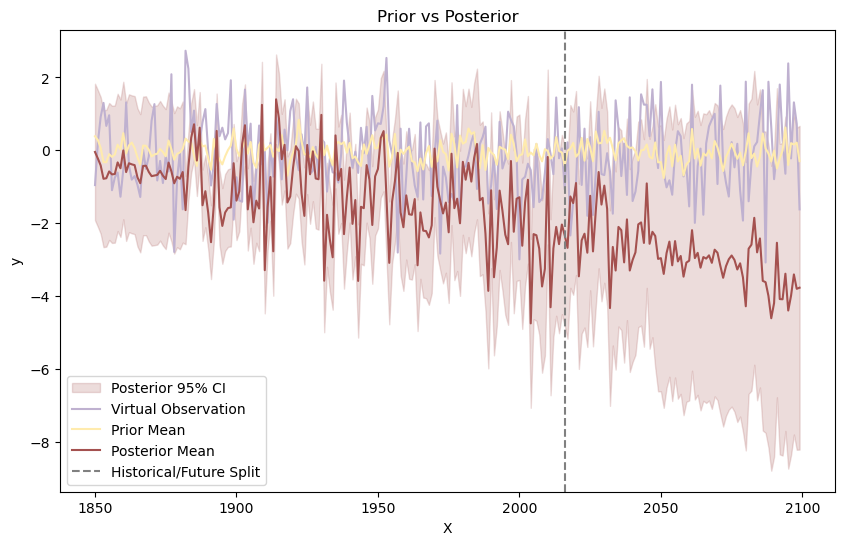

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.653e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.412e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.83e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.642e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.037e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.585e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.57e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.59e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2685.562578085824
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 3 - test lml: -80.09353700635324


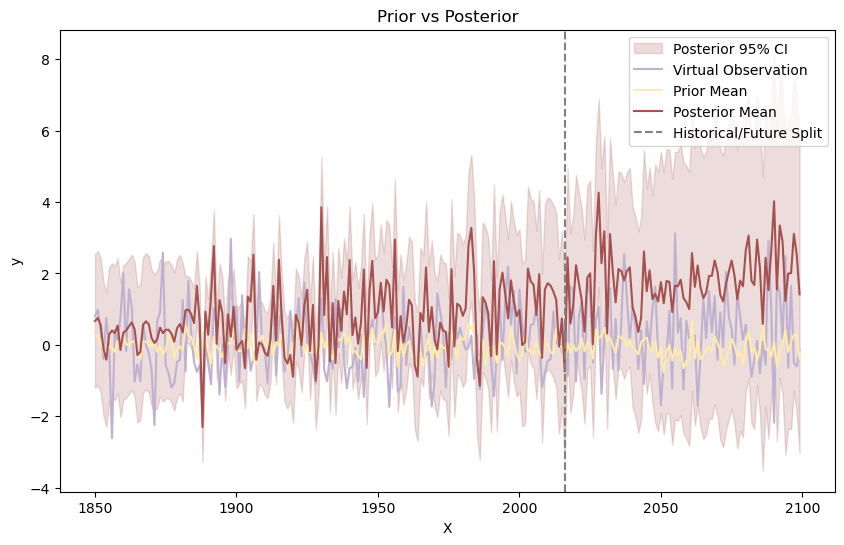

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.266e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.932e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.306e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.237e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.541e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.287e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.261e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.159e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2679.9000493391345
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 4 - test lml: -102.67059124687846


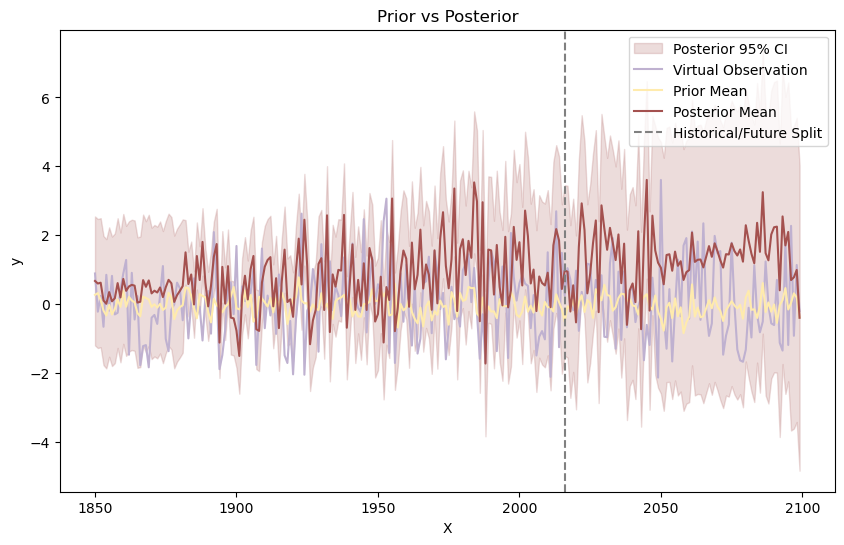

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.761e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.649e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.996e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.016e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.256e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.063e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 5 - Best objective function value: -2687.4914439214876
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 5 - test lml: -89.87107503879672


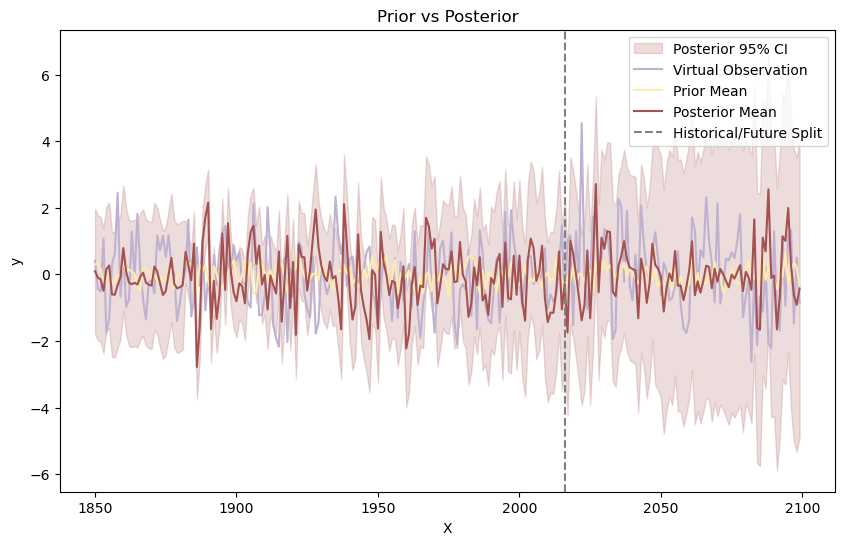

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.706e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.215e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.598e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.531e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.905e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.66e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 6 - Best objective function value: -2684.442080688189
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 6 - test lml: -107.08072123229255


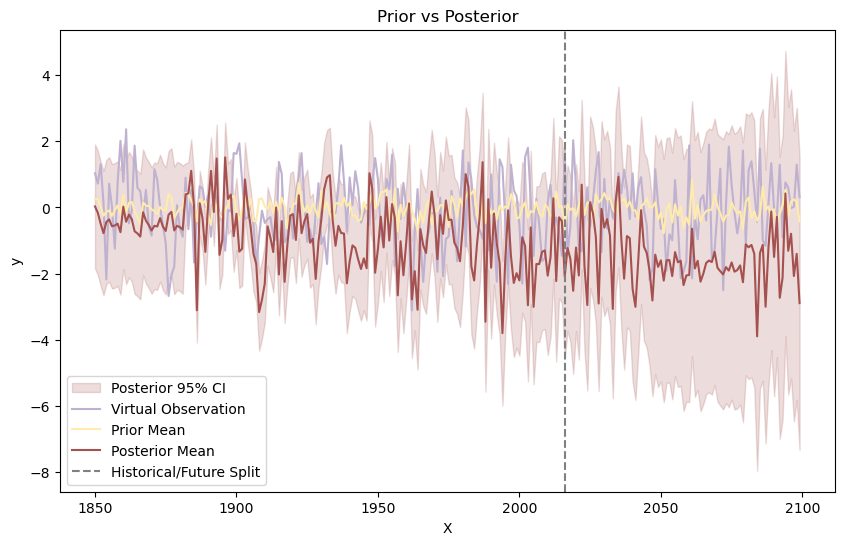

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.993e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.559e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.879e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.639e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.115e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.981e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.76e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.922e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2688.287253487359
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 7 - test lml: -105.21421008293133


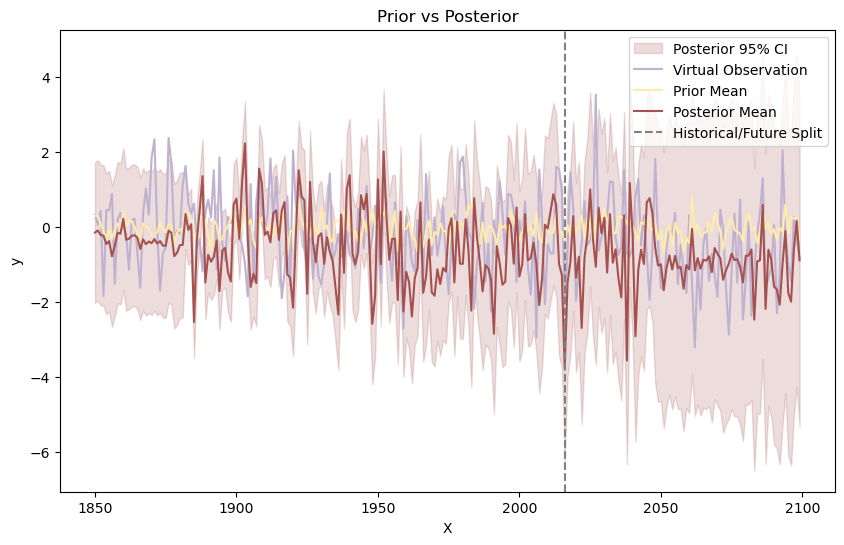

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.247e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.547e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.074e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.63e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.636e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.97e+07 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.988e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.229e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.195e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2692.461132308962
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 8 - test lml: -84.72401304585188


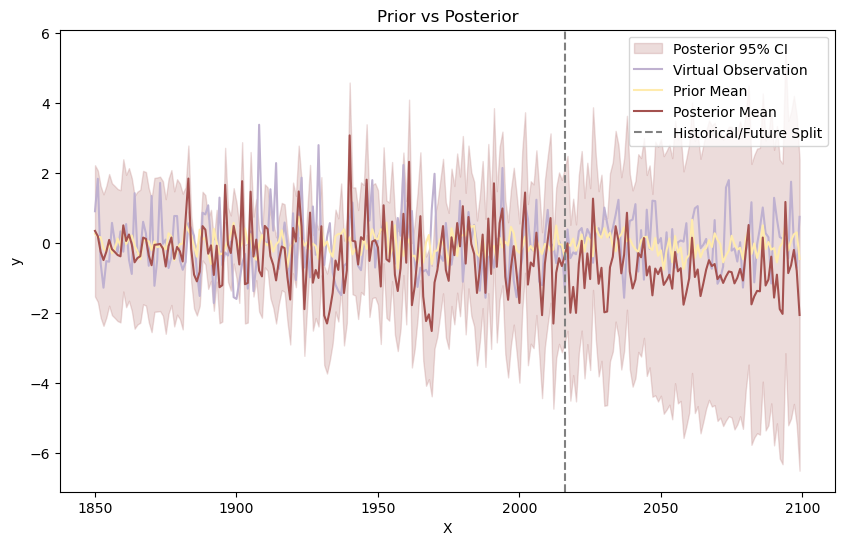

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.331e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.99e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.414e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.271e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.625e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.361e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.179e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2680.6126872741615
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 9 - test lml: -101.80267668539327


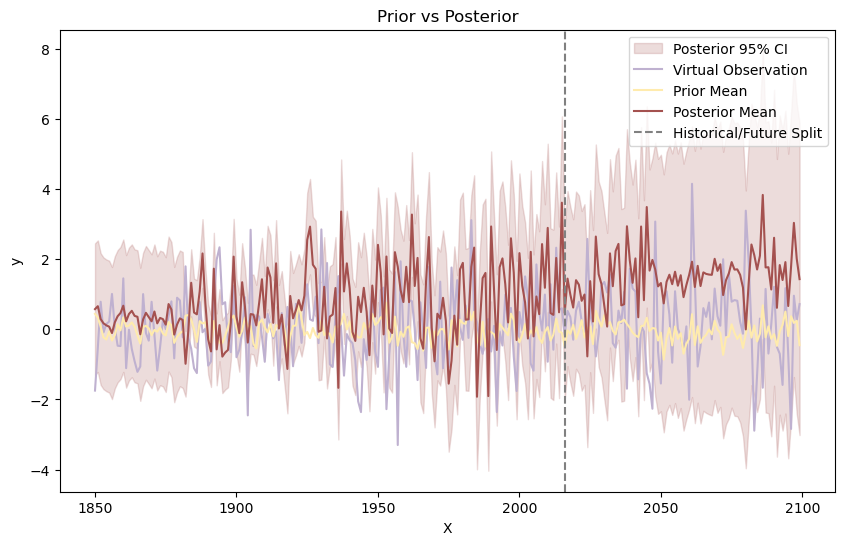

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.557e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.088e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.426e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.457e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.765e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.629e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.317e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.888e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.375e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.303e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2682.672227385819
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 10 - test lml: -100.85097438142614


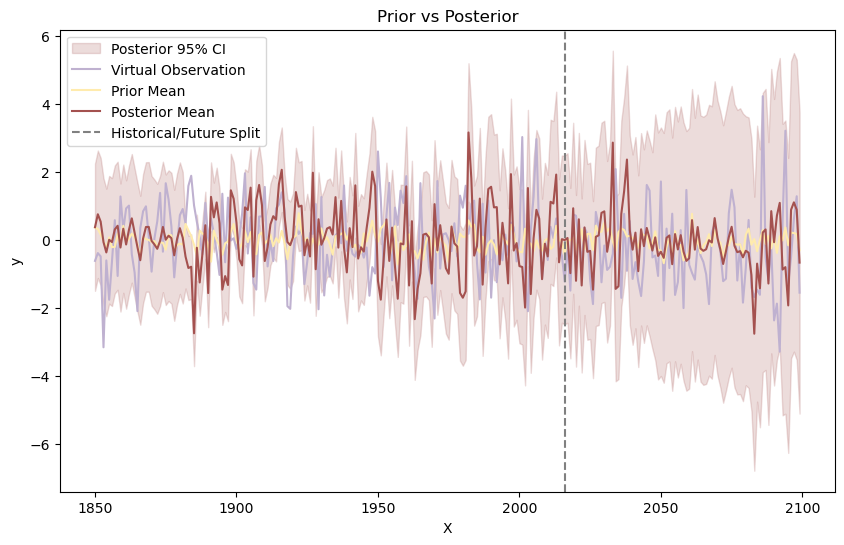

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.498e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.011e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.478e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.314e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.734e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.451e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.367e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2683.7038163163393
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 11 - test lml: -100.67008087143823


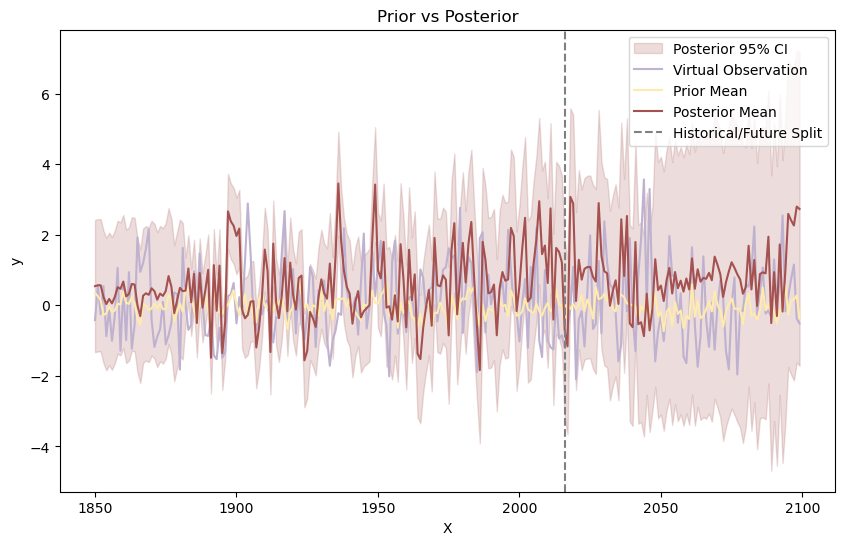

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.014e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.56e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.01e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.704e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.609e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.142e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.577e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.439e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -7.128e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.448e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.222e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.791e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2692.374386825857
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma

Iteration 12 - test lml: -92.21391537218146


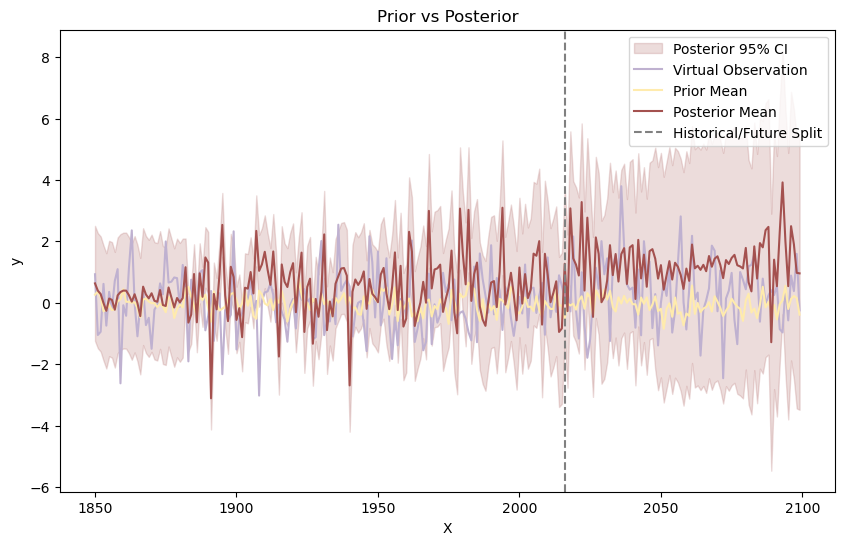

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.373e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.027e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.48e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.285e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.581e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.349e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -7.446e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.341e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.768e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.298e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.189e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2681.594384027349
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodi

Iteration 13 - test lml: -98.60064912147875


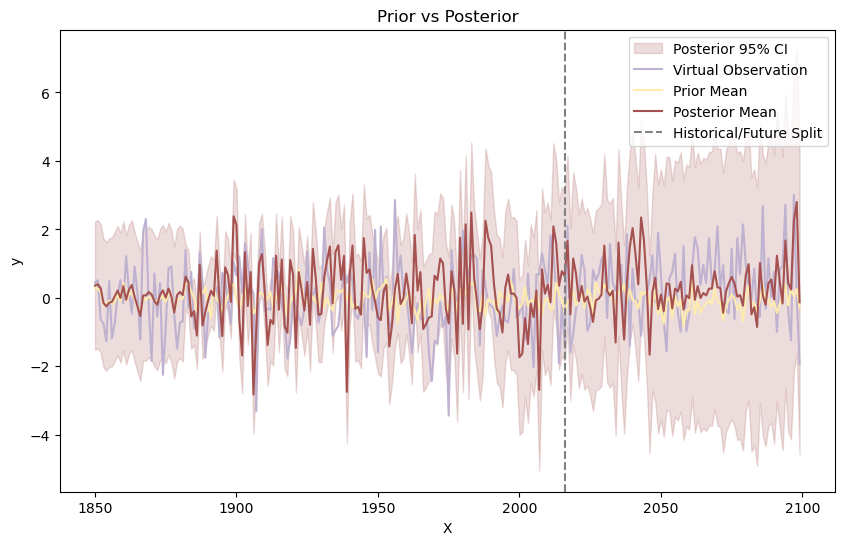

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.103e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.091e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.979e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.129e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.339e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.246e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.212e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.238e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.912e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2689.8432589681147
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 14 - test lml: -96.70154154319218


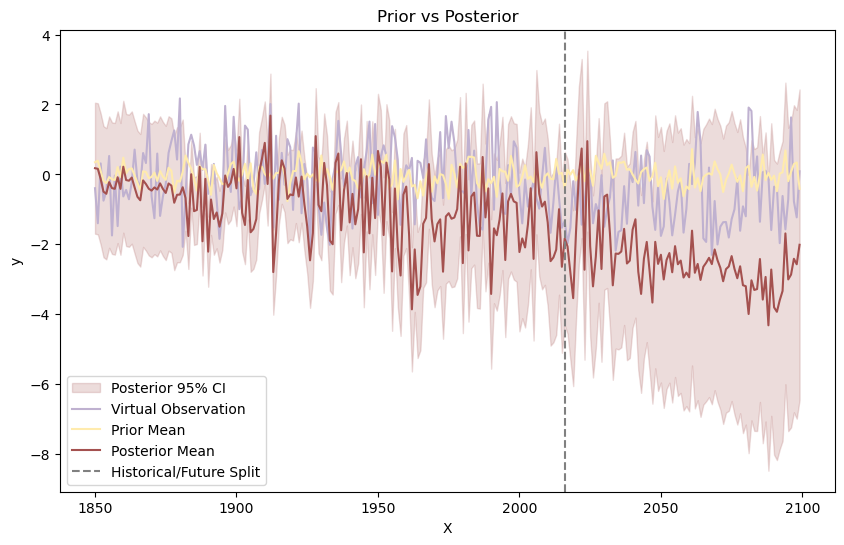

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.673e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.107e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.693e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.429e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.724e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.659e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.475e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.401e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2685.0960934767595
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 15 - test lml: -90.53456958947221


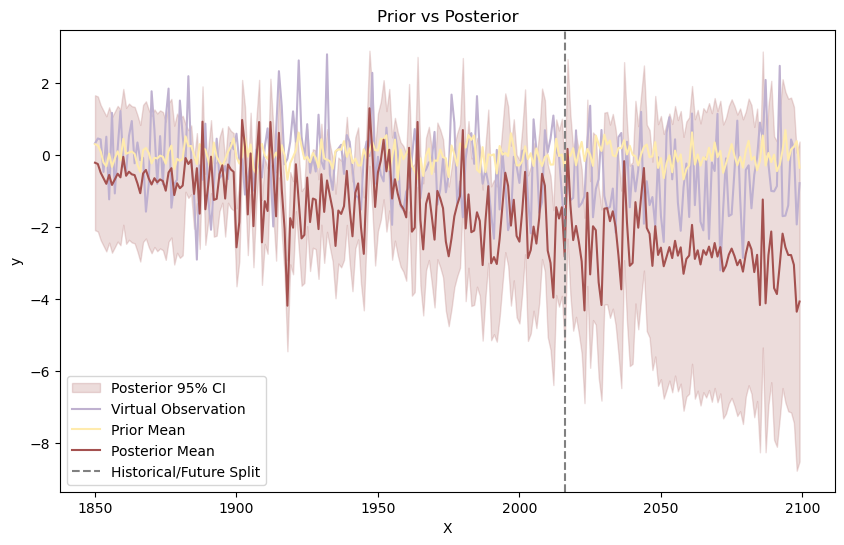

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.622e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.536e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.761e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.047e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.081e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.007e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.779e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.291e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.67e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.462e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2688.1568911772806
Best kernel is: 0.316**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 16 - test lml: -91.08032065185532


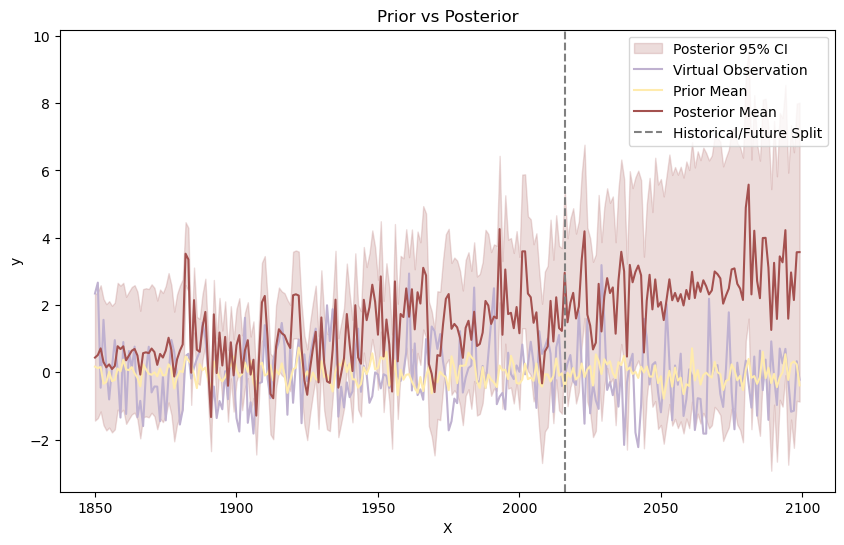

Total log marginal likelihood sum for the kernel structure: -1533.591122061056


-1533.591122061056

In [29]:
def pe2_poly(best_params):
    kernel = (
        0.1* C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.0000001, 0.000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}
kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)

-1496.7283170753462

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.462e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.114e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.695e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.353e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.634e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.118e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -8.153e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2674.325741579024
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 1 - test lml: -95.24788780027794


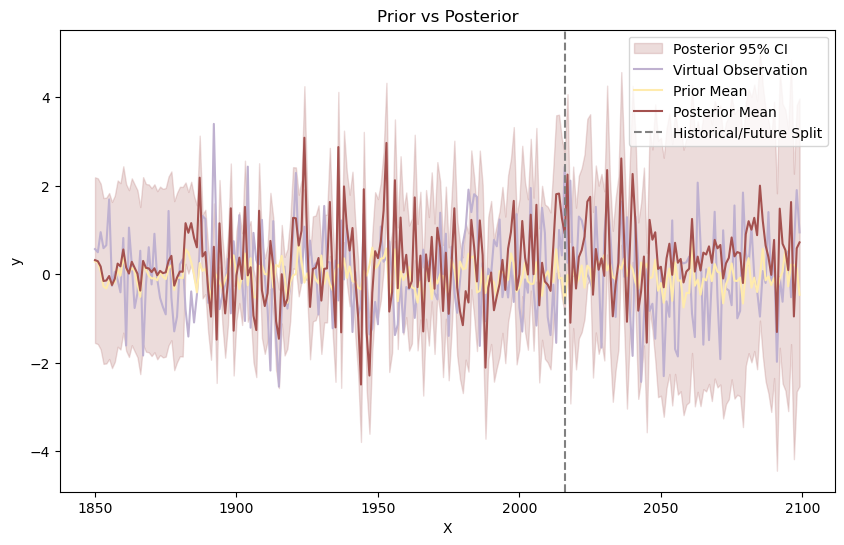

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.415e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.102e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.524e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.386e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.676e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.422e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -7.486e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.338e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.661e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.498e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.399e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2662.8469362943824
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodici

Iteration 2 - test lml: -93.78282549509319


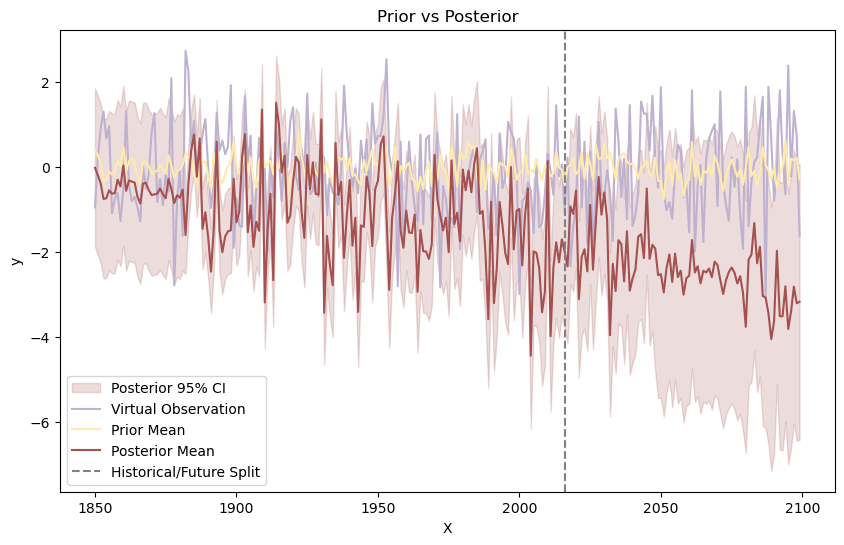

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.653e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.412e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.83e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.642e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.037e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.585e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.59e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2666.4053618196026
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 3 - test lml: -78.87809448830164


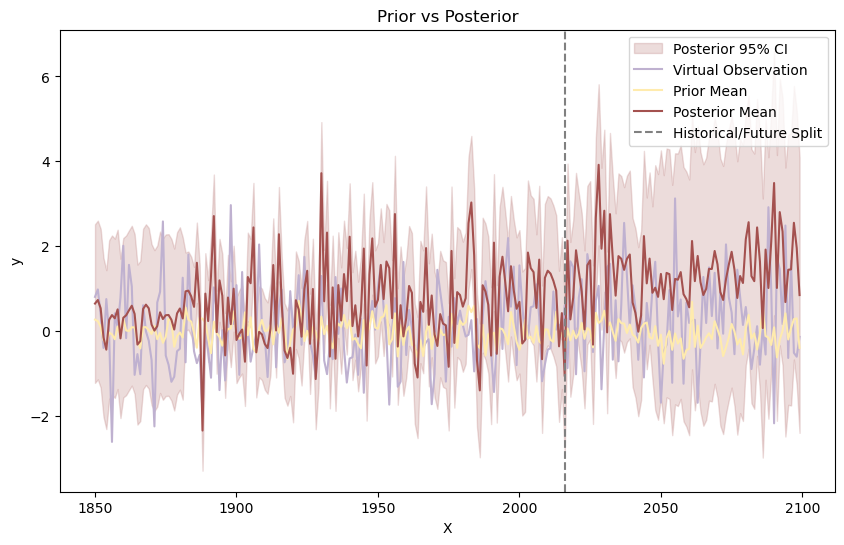

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.266e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.932e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.306e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.237e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.541e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.287e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2660.7477451075615
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 4 - test lml: -101.50765398797753


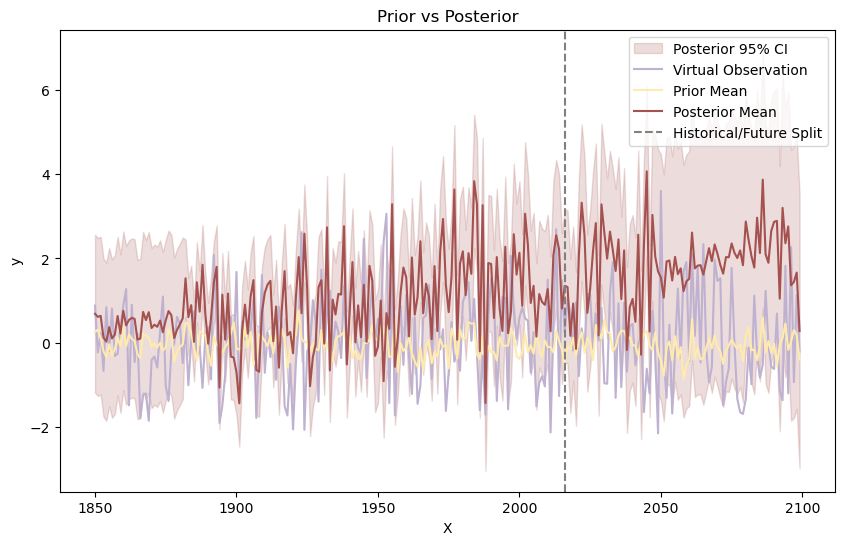

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.761e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.649e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.996e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.016e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.256e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.063e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -2668.3283610172566
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 5 - test lml: -88.71758962377812


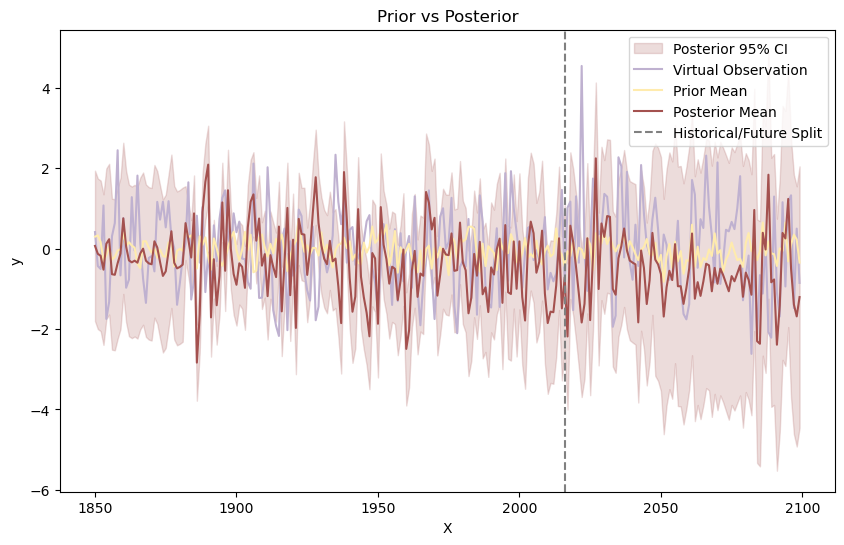

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.706e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.215e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.598e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.531e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.905e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.66e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.372e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.37e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2665.275671700418
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 6 - test lml: -105.89821485772428


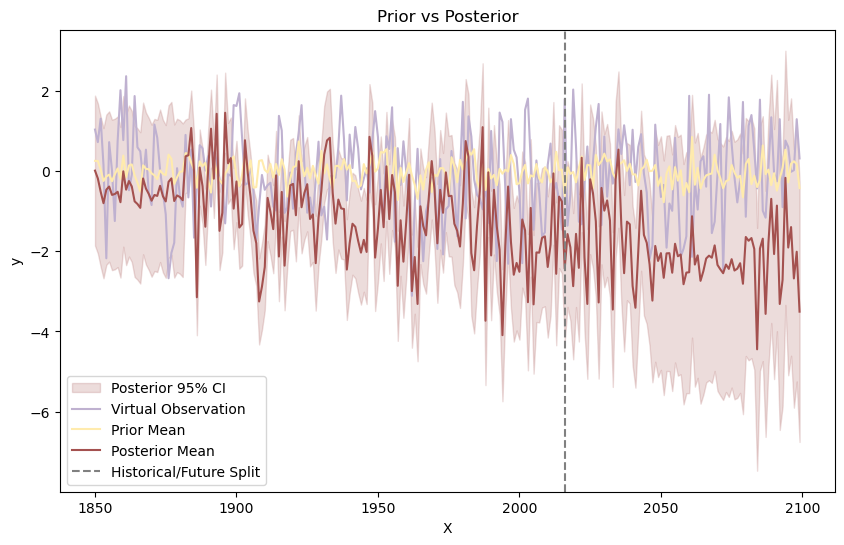

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.993e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.559e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.879e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.639e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.115e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.981e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.289e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.977e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.651e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.203e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.76e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.922e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2669.1197522280277
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0

Iteration 7 - test lml: -104.11427910236151


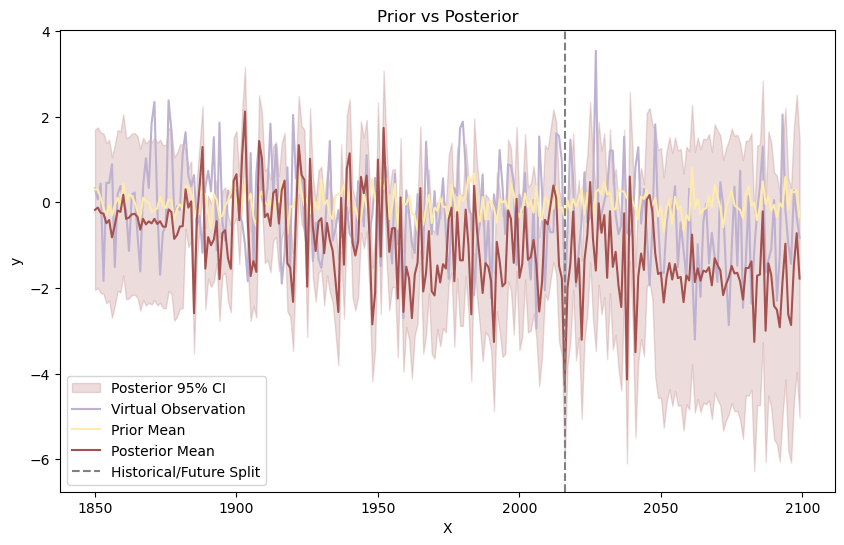

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.247e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.547e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.074e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.63e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.636e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -8.195e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2673.3175315702515
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 8 - test lml: -83.44982546554195


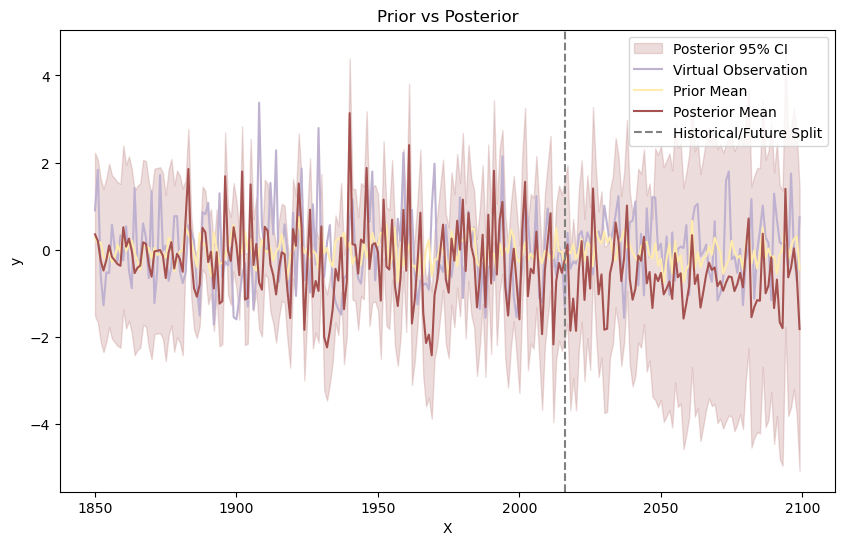

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.331e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.99e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.414e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.271e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.625e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.361e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.179e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2661.47072072429
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 9 - test lml: -100.53059104685916


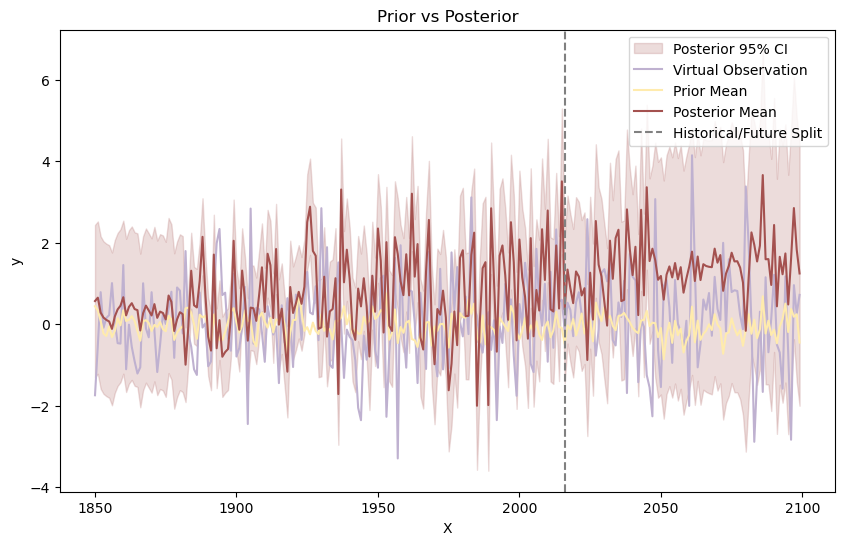

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.557e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.087e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.426e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.457e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.765e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.629e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.317e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.888e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.375e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.303e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2663.5333076233314
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 10 - test lml: -99.62086872055556


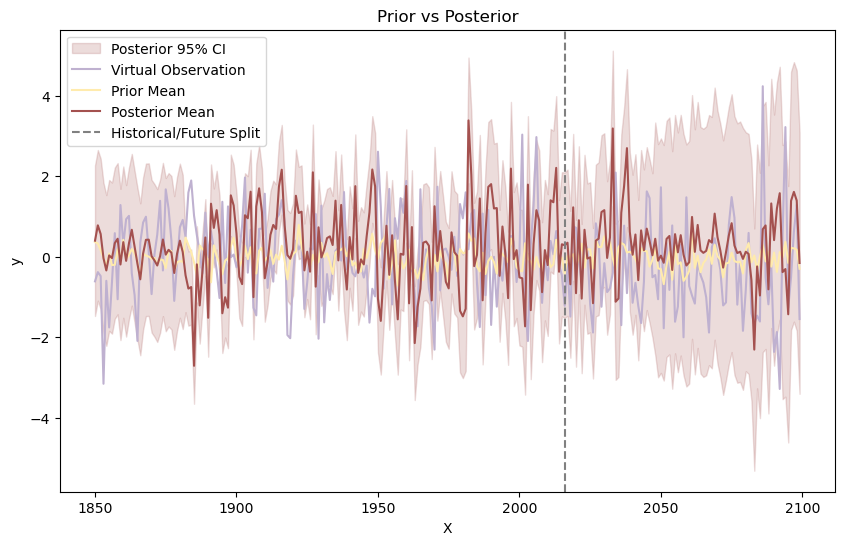

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.498e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.011e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.478e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.314e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.734e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.451e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2664.573164951424
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 11 - test lml: -99.61769866649593


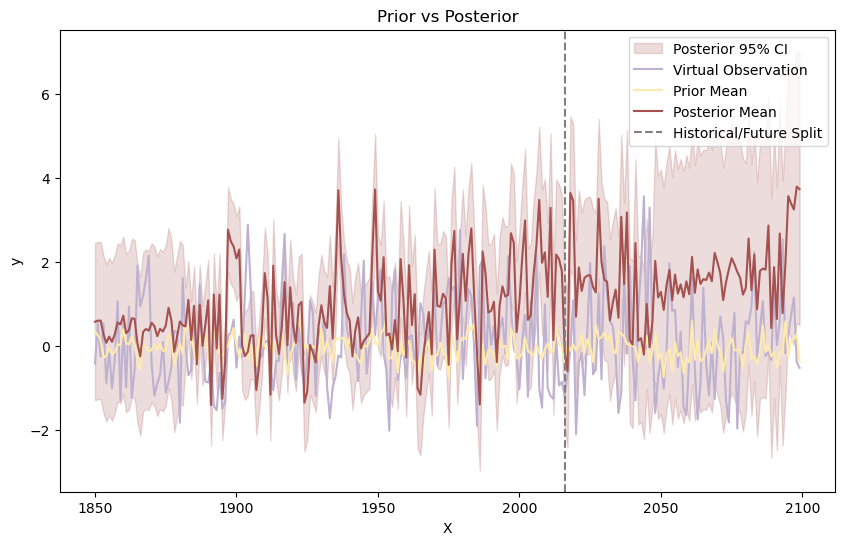

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.014e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.56e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.01e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.704e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.609e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.142e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -7.222e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.791e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2673.216765556088
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 12 - test lml: -91.02159090587014


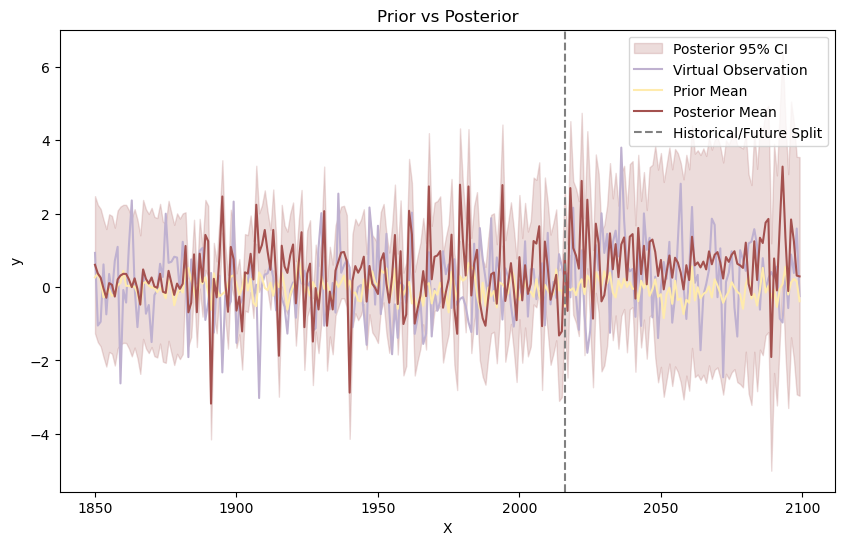

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.373e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.027e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.48e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.285e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.581e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.349e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2662.448512137438
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 13 - test lml: -97.31566540249997


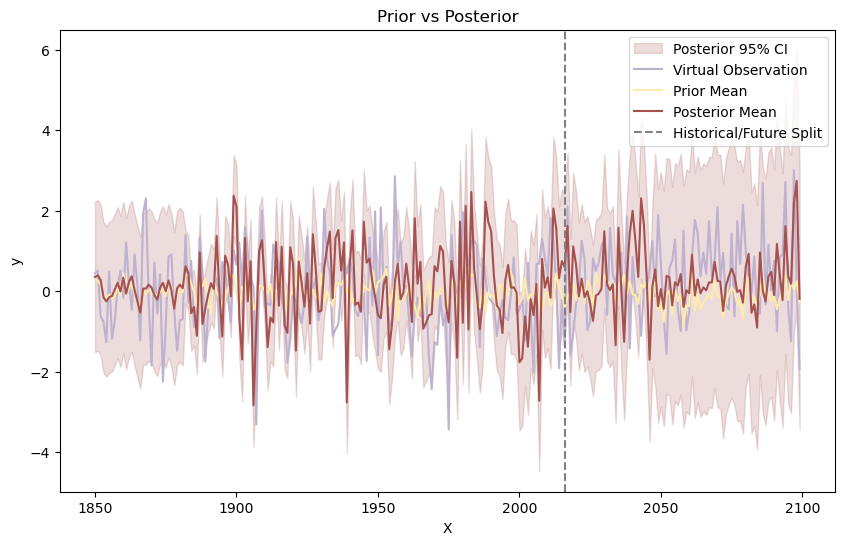

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.103e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.091e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.979e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.129e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.339e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.246e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 14 - Best objective function value: -2670.7528362809653
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 14 - test lml: -95.92460664598488


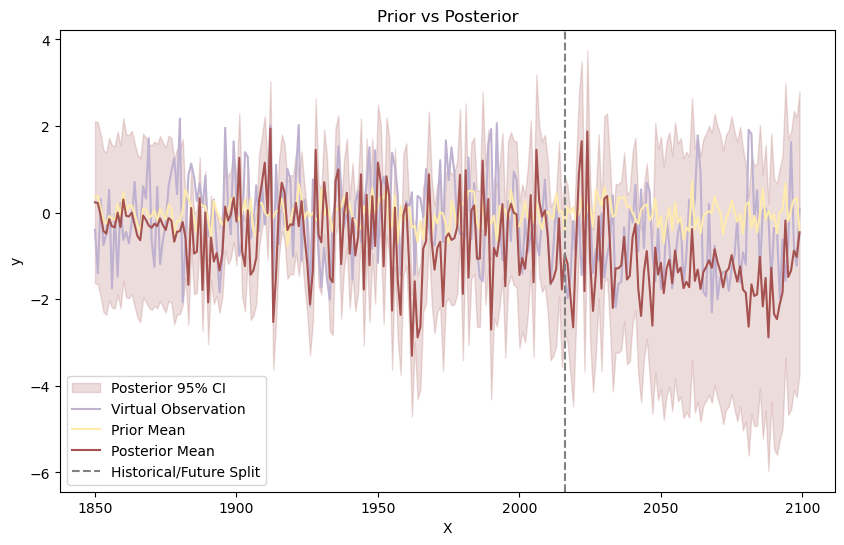

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.673e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.107e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.693e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.429e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.724e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.659e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.508e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.79e+07 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.475e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.401e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2665.948918141186
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)


Iteration 15 - test lml: -89.27268491356482


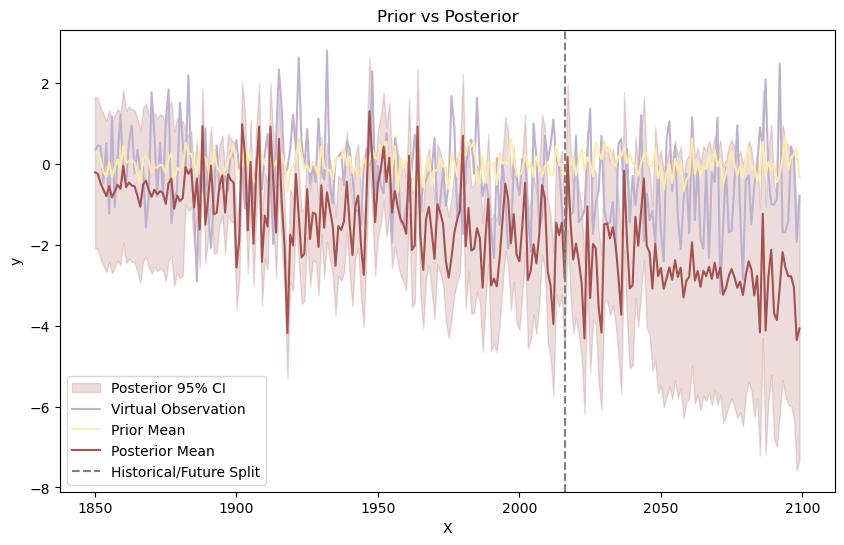

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.622e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.536e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.761e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.047e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.081e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.007e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.67e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.462e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2669.0093815800246
Best kernel is: 0.1**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.00831)
Iteration 16 - test lml: -89.84353293164986


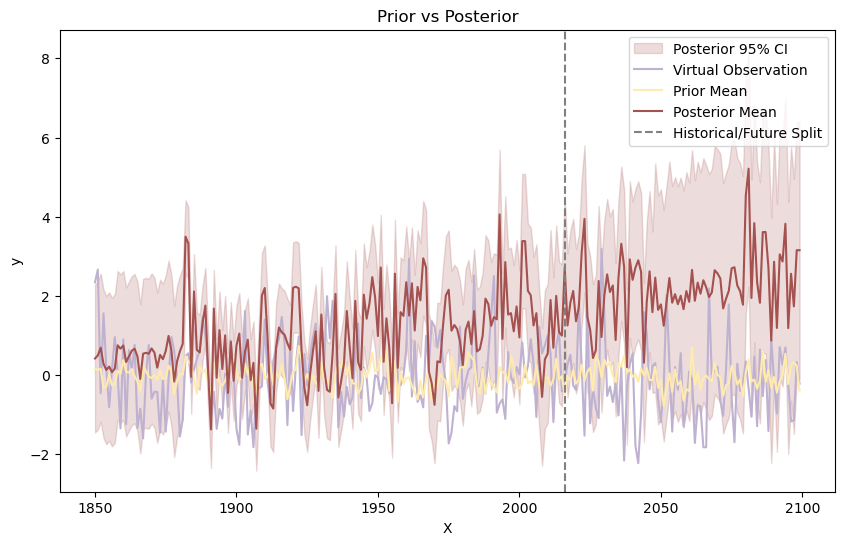

Total log marginal likelihood sum for the kernel structure: -1514.7436100545365


-1514.7436100545365

In [40]:
def time_dependent_noise(t, base_noise=1e-5, growth_rate=1e-4):
    return base_noise + growth_rate * t

def pe2_poly(best_params, Nobs=166):
    t = np.linspace(0, Nobs, Nobs)  # 模拟时间轴
    noise_level = time_dependent_noise(t)
    kernel = (
        0.01 * C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=noise_level.mean())  # 使用平均噪声水平
    )
    return kernel

pbounds = {
    'c1': (0.0000001, 0.000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),  # 这里的噪声水平会在核函数中通过 time_dependent_noise 动态计算
    'dp_sigma_0': (1e-3, 10),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)


-1514.7436100545365

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.462e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.114e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.695e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.353e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.634e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.118e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2753.179038972443
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 1 - test lml: -100.39511781111217


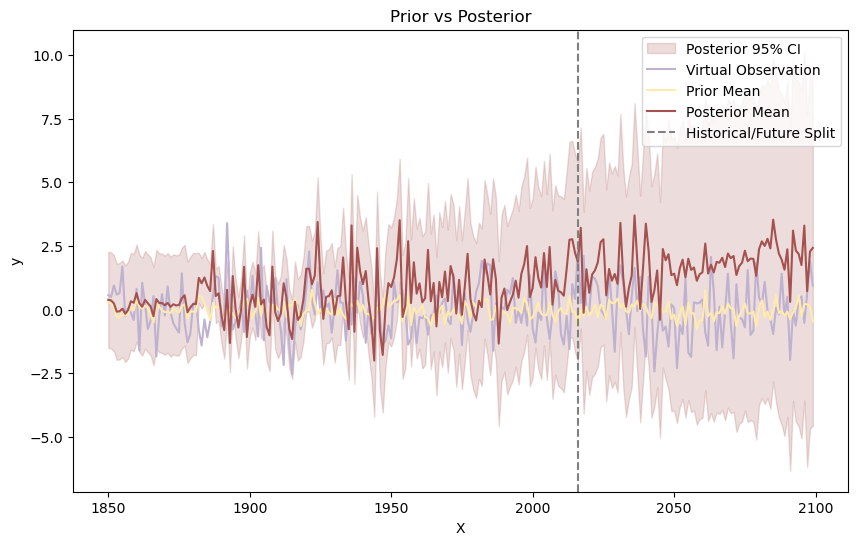

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.415e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.102e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.524e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.386e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.676e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.422e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.338e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.661e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.498e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.399e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2741.6509027692355
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 2 - test lml: -98.76944343065442


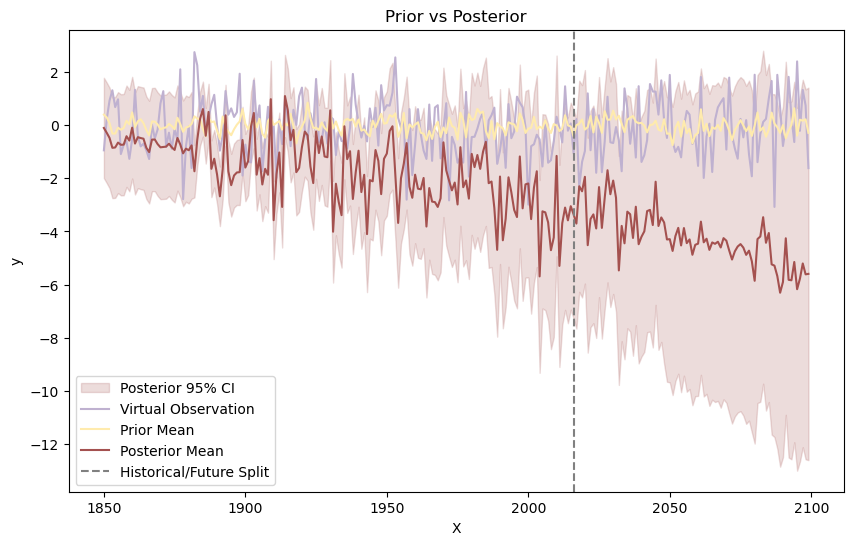

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.653e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.412e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.83e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.642e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.037e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.585e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -7.852e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.674e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.998e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.57e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.59e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2745.2934164117364
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodic

Iteration 3 - test lml: -83.89288355652444


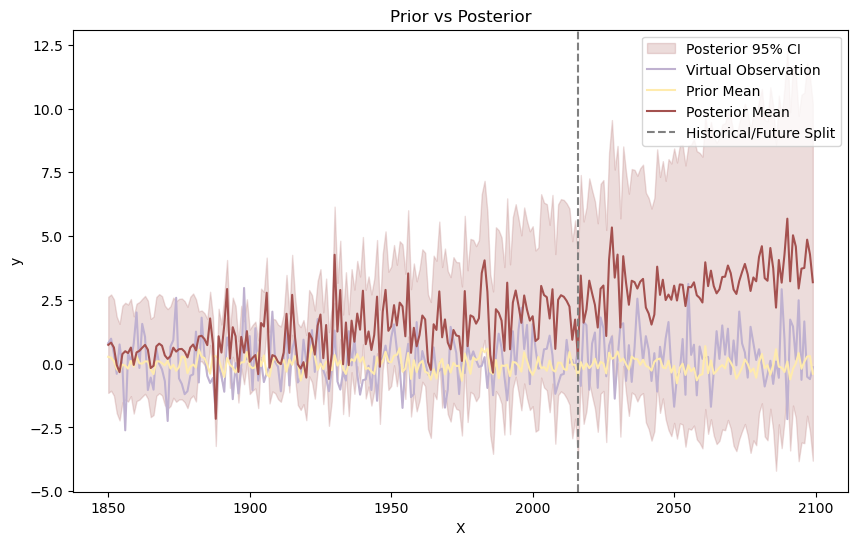

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.266e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.932e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.306e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.237e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.541e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.287e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -7.624e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.407e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.136e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.63e+07 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.261e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.159e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2739.605818987032
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0

Iteration 4 - test lml: -106.2910501191841


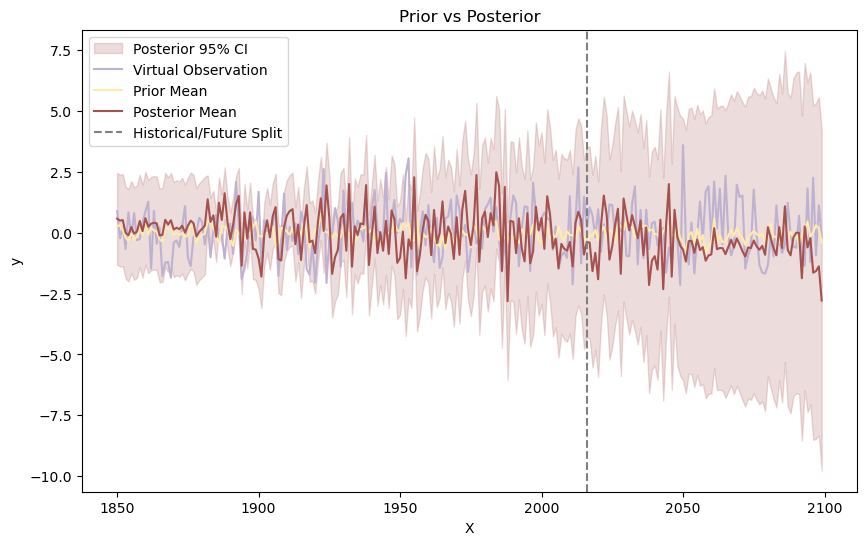

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.761e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.649e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.996e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.016e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.256e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.063e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.333e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.952e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.44e+07 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.374e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.397e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.992e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -2747.2187671912743
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_

Iteration 5 - test lml: -93.44634812626227


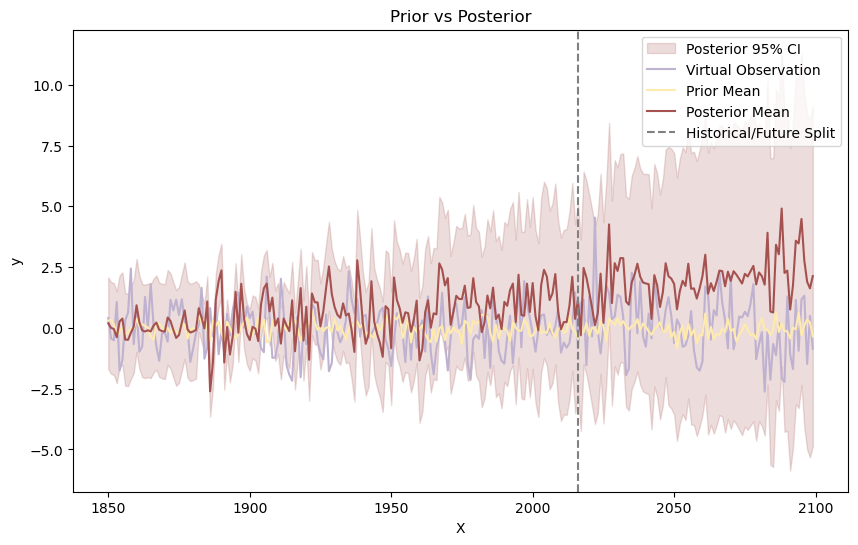

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.706e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.215e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.598e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.531e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.905e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.66e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2744.1753897998715
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 6 - test lml: -110.7868751193705


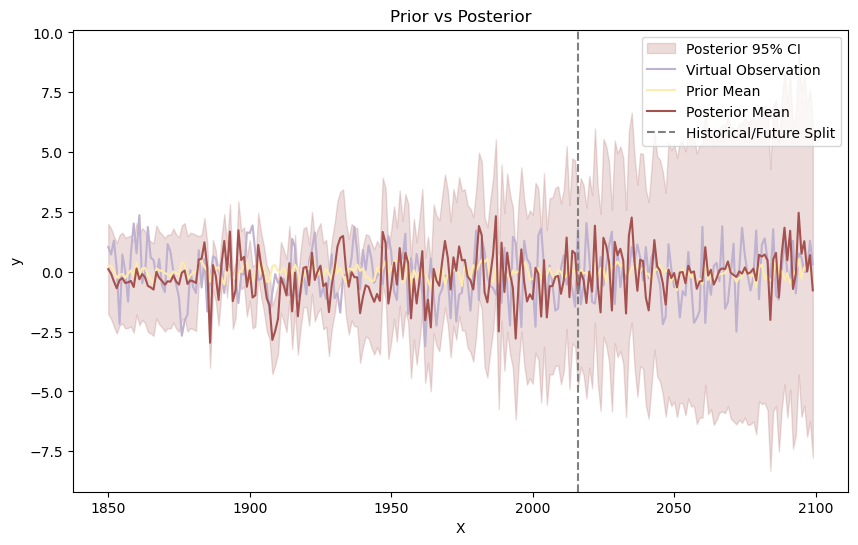

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.993e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.559e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.879e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.639e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.115e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.981e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.289e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.977e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.651e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.203e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.76e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.922e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2748.0347955812194
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_

Iteration 7 - test lml: -108.6118594735142


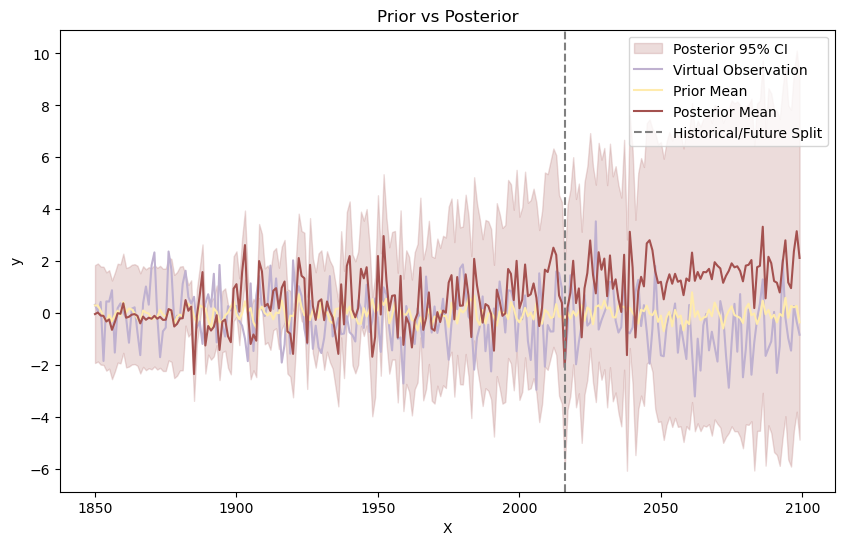

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.247e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.547e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.074e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.63e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.636e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -8.727e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -8.481e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.97e+07 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.988e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.229e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.195e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 8 - Best objective function value: -2752.125886754883
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 8 - test lml: -88.69772074633022


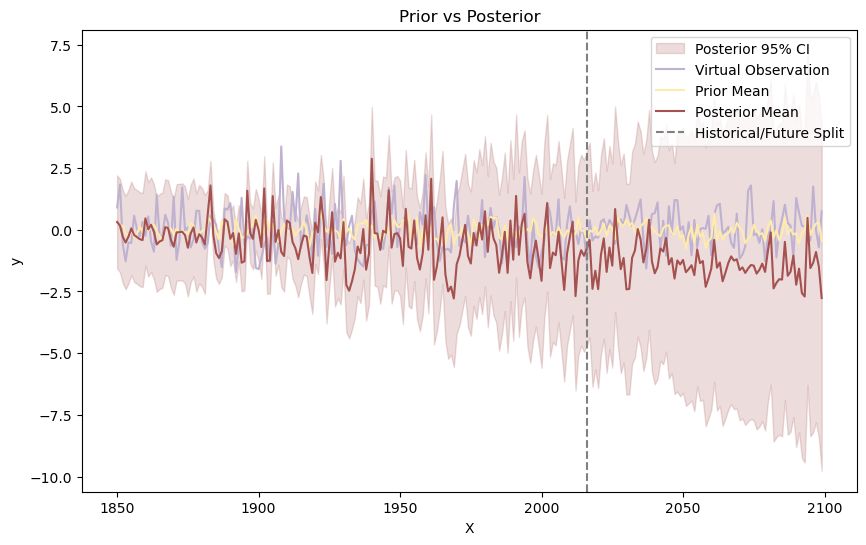

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.331e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.99e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.414e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.271e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.625e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.361e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -6.525e+0 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -7.677e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.548e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.285e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.671e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.217e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.179e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 9 - Best objective function value: -2740.2823887702702
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 9 - test lml: -105.79110533383731


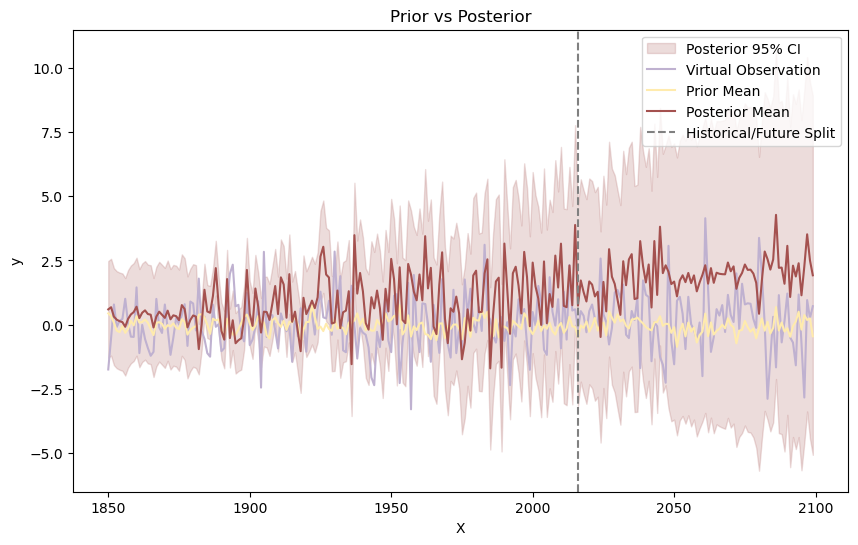

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.557e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.088e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.426e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.457e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.765e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.629e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -7.841e+0 |  1.8e-07  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.636e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.317e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.888e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.375e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.303e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2742.326865356632
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_

Iteration 10 - test lml: -104.6872211552026


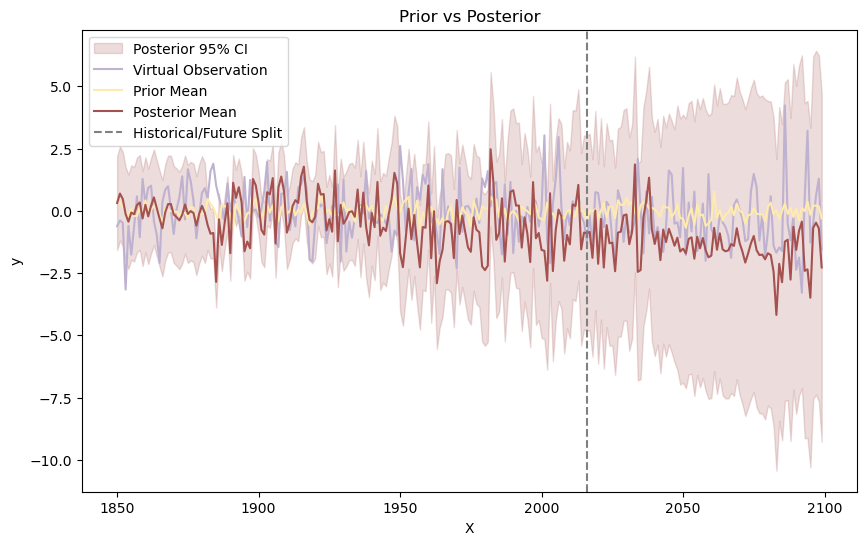

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.498e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.011e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.478e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.314e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.734e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.451e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.367e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2743.3389803042146
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 11 - test lml: -103.94130215345606


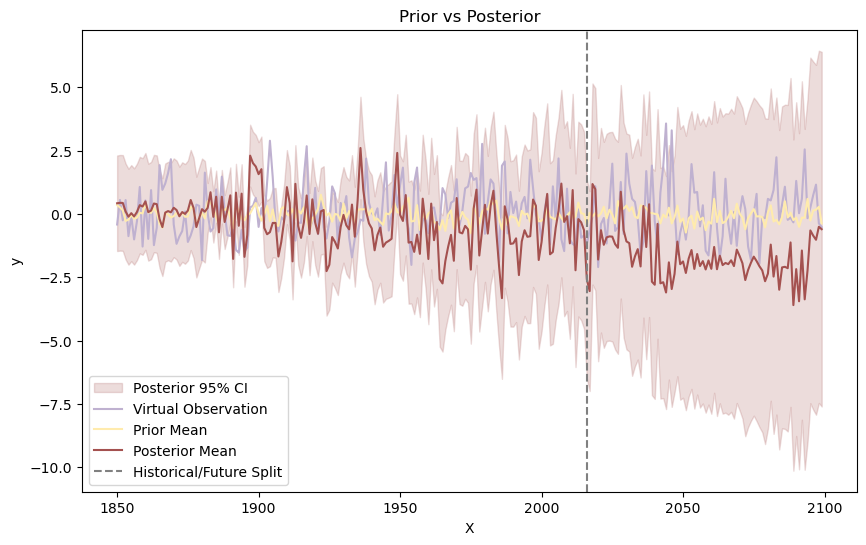

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.014e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.56e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.01e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.704e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.609e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.142e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -8.439e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -7.128e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.448e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.222e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.791e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 12 - Best objective function value: -2752.104979842535
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 12 - test lml: -95.93148633891263


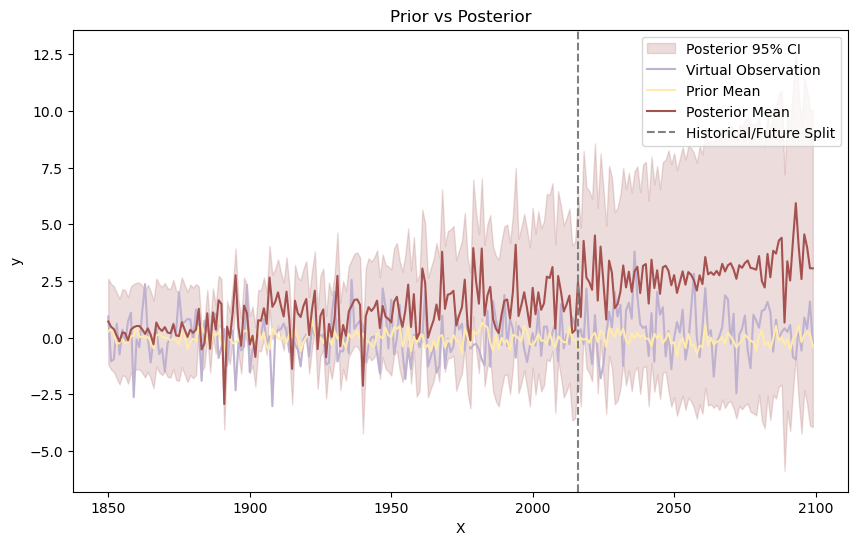

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.373e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.027e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.48e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.285e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.581e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.349e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -7.446e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.341e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.768e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.298e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.189e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2741.2751534909457
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodi

Iteration 13 - test lml: -102.60510633899526


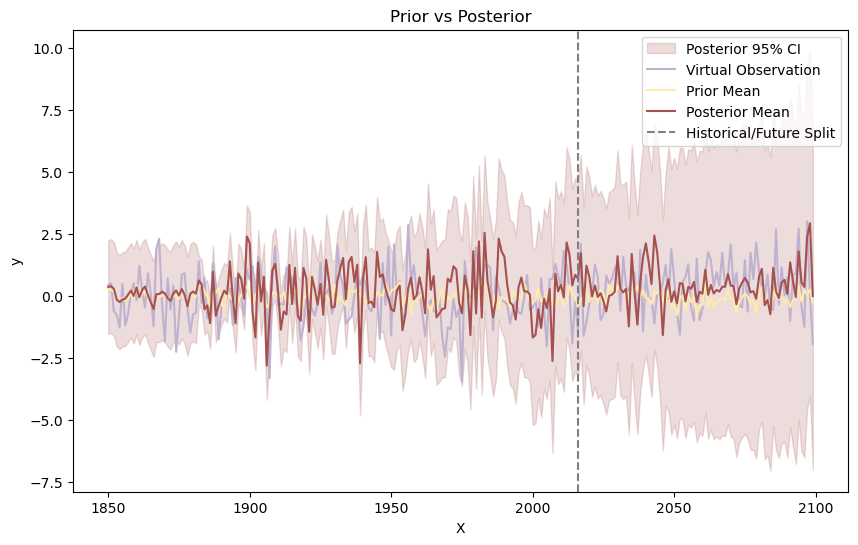

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.103e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.091e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.979e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.129e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.339e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.246e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -7.238e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.912e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2749.3144676327197
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 14 - test lml: -99.07895441676527


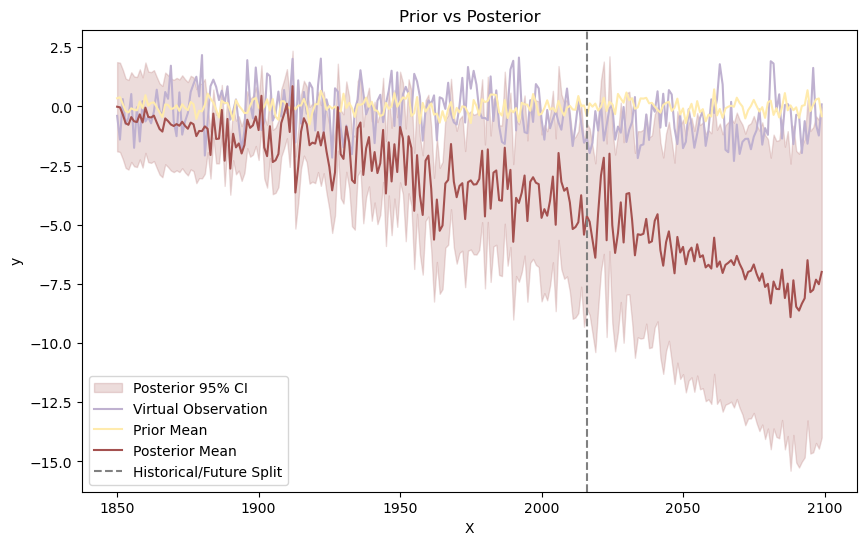

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.673e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.107e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.693e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.429e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.724e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.659e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2744.7570418237387
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 15 - test lml: -94.53771201027007


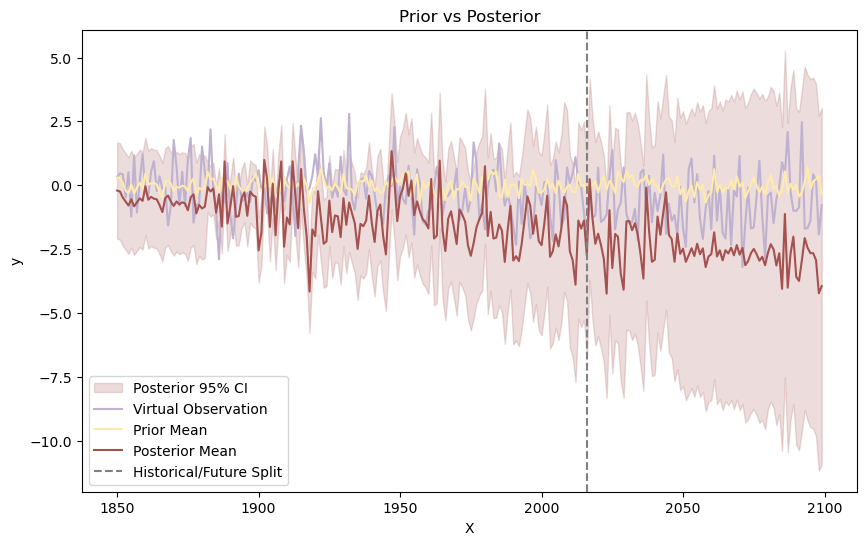

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.622e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.536e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.761e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.047e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.081e+0 |  5.93e-07 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.007e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.779e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.291e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.67e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.462e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2747.864529258875
Best kernel is: 3.05**2 * 0.000807**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 16 - test lml: -94.98671528726058


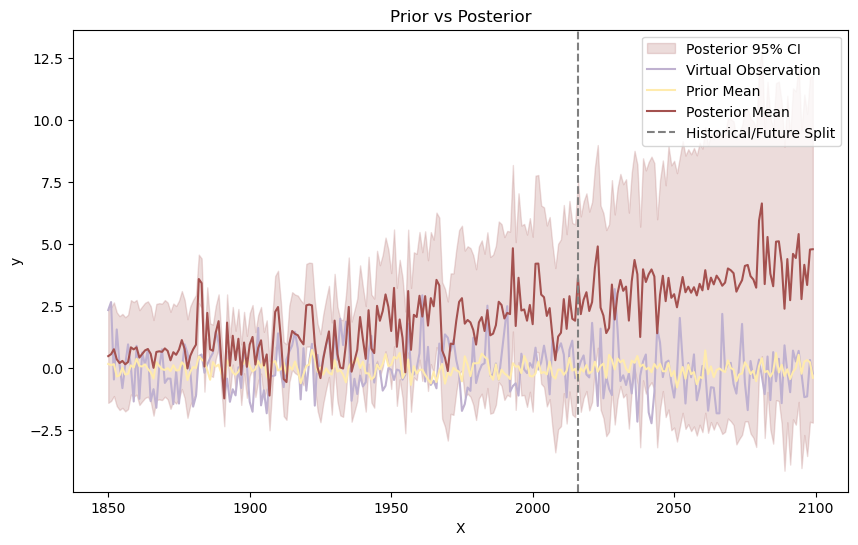

Total log marginal likelihood sum for the kernel structure: -1592.4509014176522


-1592.4509014176522

In [15]:
def pe2_poly(best_params, Nobs=166):
    t = np.linspace(0, Nobs, Nobs)  # 模拟时间轴
    weight_factor = 0.1  # 时间权重因子
    time_weight = 1 + weight_factor * t.mean()
    
    kernel = (
        time_weight * C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.0000001, 0.000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)


-1592.4509014176522

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.462e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.114e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.695e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.353e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.634e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.118e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:02<?, ?it/s]

|  47       | -7.489e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.749e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.119e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.153e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2646.1448101837345
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 1 - test lml: -93.34084739530815


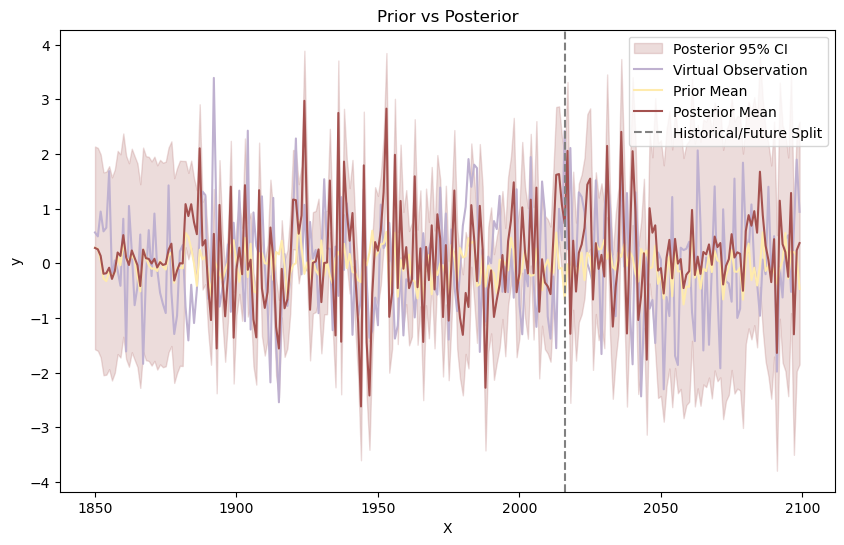

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.415e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.102e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.524e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.386e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.676e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.423e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  50       | -7.401e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2634.331609992174
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 2 - test lml: -92.7684261603758


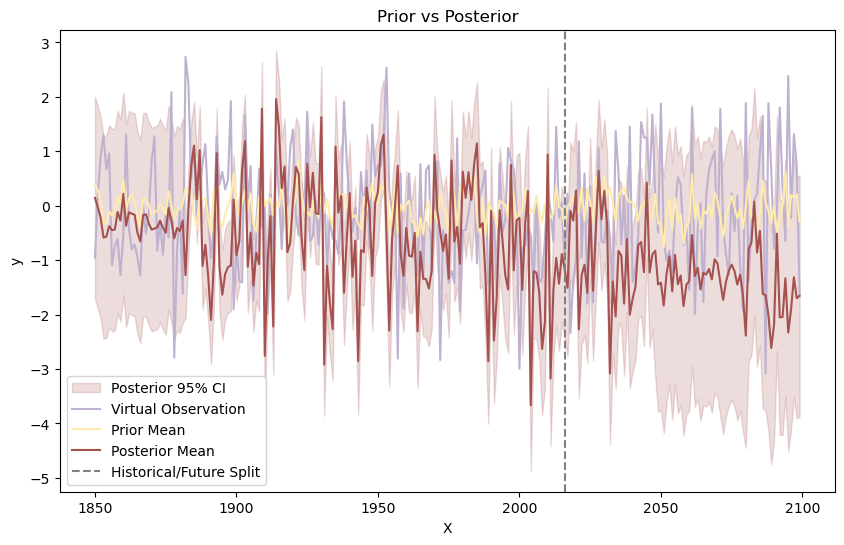

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.653e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.412e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.83e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.642e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.037e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.585e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.674e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.998e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.57e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.59e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2638.3746331472207
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 3 - test lml: -77.26426647780596


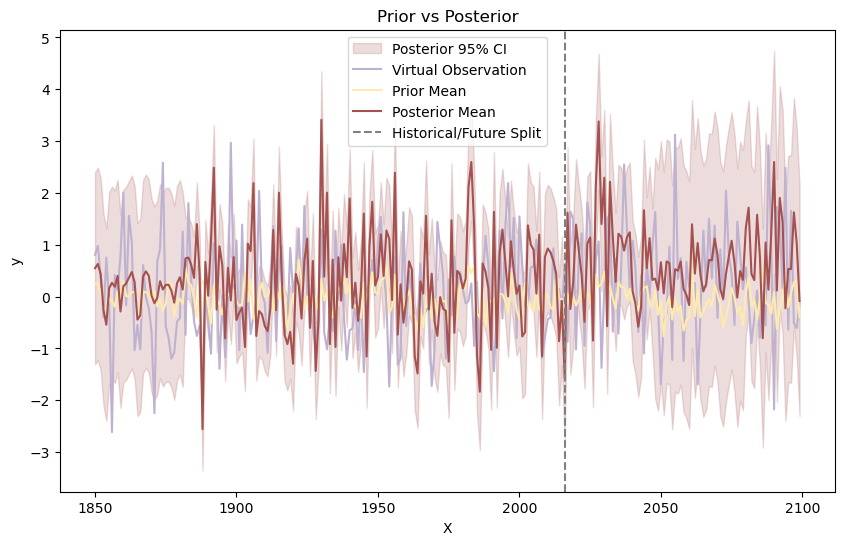

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.266e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.932e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.306e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.237e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.541e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.287e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -2632.598242794729
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 4 - test lml: -100.40509125508385


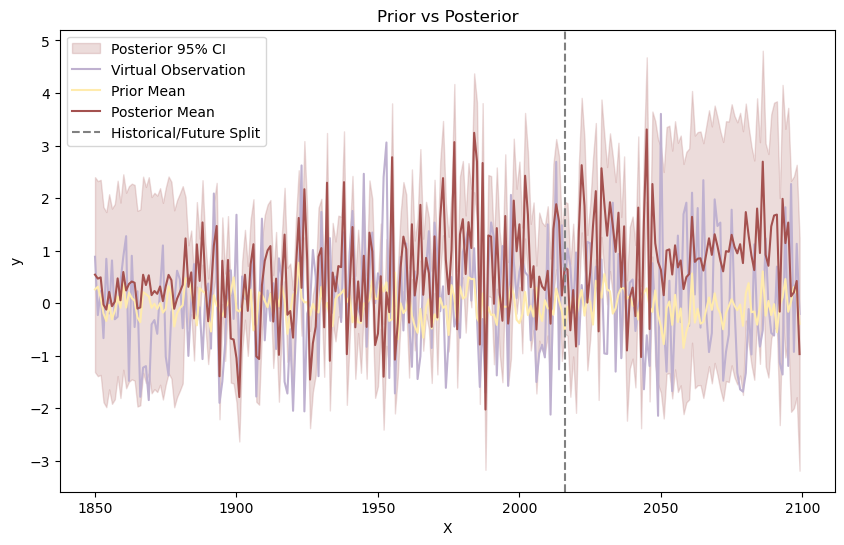

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.761e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.649e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.996e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.016e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.256e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.063e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:01<?, ?it/s]


Iteration 5 - Best objective function value: -2639.91250409786
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 5 - test lml: -86.86401418158258


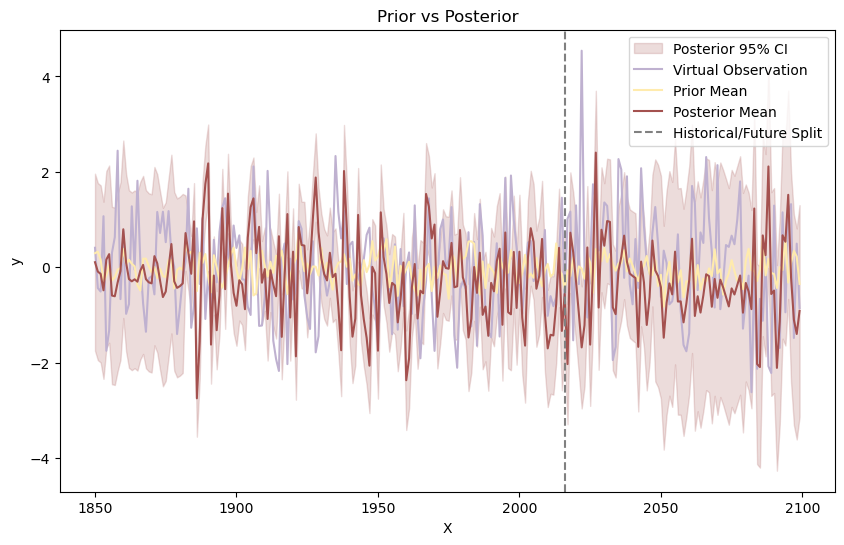

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.706e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.215e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.598e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.531e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.905e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.66e+07 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -6.863e+0 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -8.001e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.926e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.566e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.871e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.372e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.37e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 6 - Best objective function value: -2636.7613643272116
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 6 - test lml: -104.82336662021575


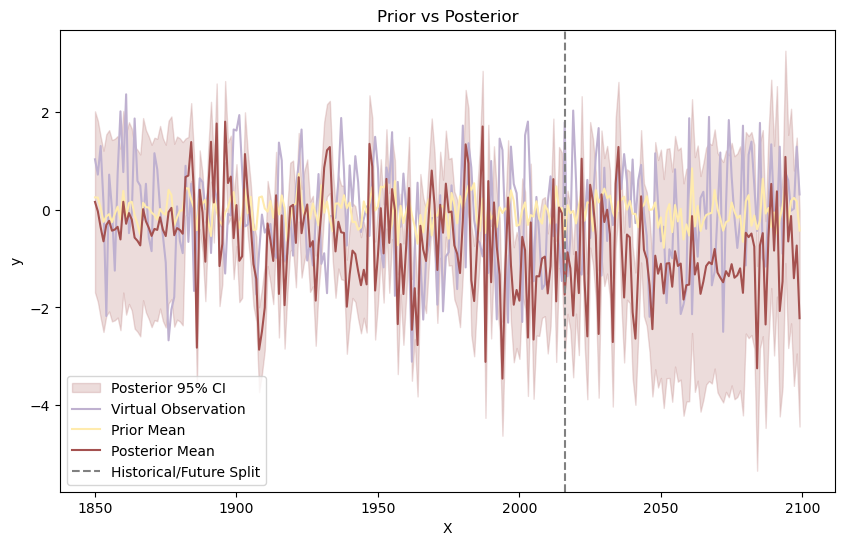

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.993e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.559e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.879e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.639e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.115e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.981e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:01<?, ?it/s]

|  44       | -6.884e+0 |  6.892e-0 |  0.8403   |  0.4828   |  9.377    |  0.8097   |  3.894    |  0.6565   |  6.41     |  4.8      |
|  45       | -8.289e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.977e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.651e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.203e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.76e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.922e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one

Iteration 7 - Best objective function value: -2640.7395506092503
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 7 - test lml: -102.71295739470516


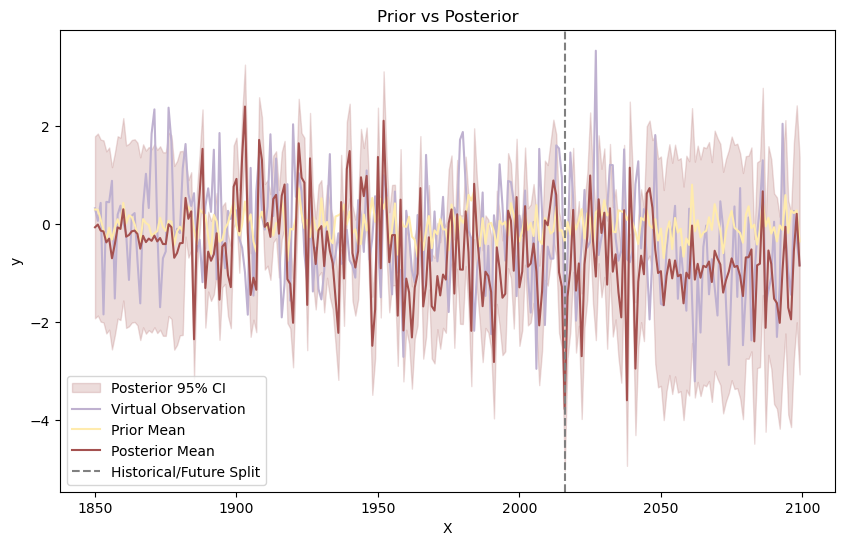

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.248e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.547e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.074e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.63e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.636e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.414e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -8.483e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.97e+07 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.989e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.229e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.195e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2645.0251583352374
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodici

Iteration 8 - test lml: -81.55612794452841


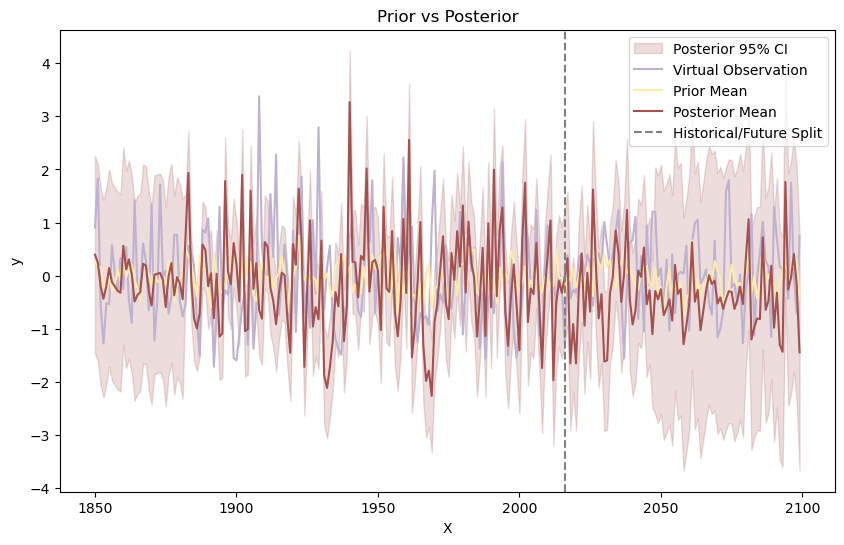

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.331e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.99e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.414e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.271e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.625e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.361e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -7.677e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.549e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.285e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.672e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.217e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.18e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -2633.359812034989
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=

Iteration 9 - test lml: -98.9995915071036


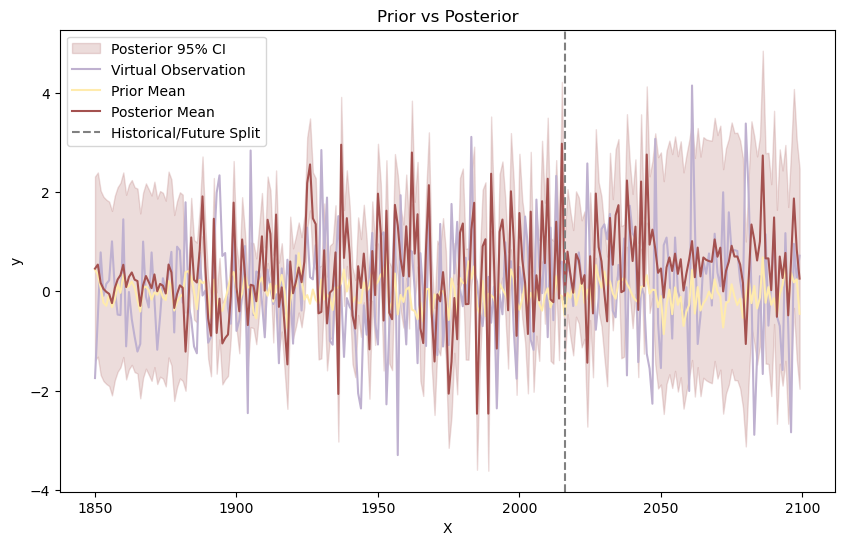

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.557e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.088e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.426e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.457e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.765e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.629e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -7.841e+0 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.638e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.317e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.888e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.375e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.304e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -2635.339894070705
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0

Iteration 10 - test lml: -97.71194341442293


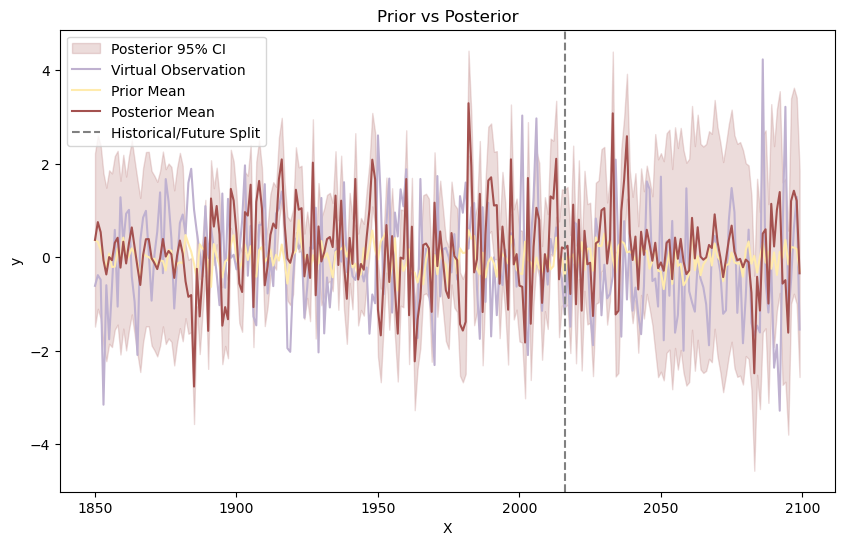

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.498e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.011e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.479e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.314e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.735e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.451e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:01<?, ?it/s]

|  45       | -7.85e+07 |  1.8e-09  |  0.43     |  0.6646   |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.615e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.302e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.741e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.391e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.371e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -2636.557598606322
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0

Iteration 11 - test lml: -98.30067204599821


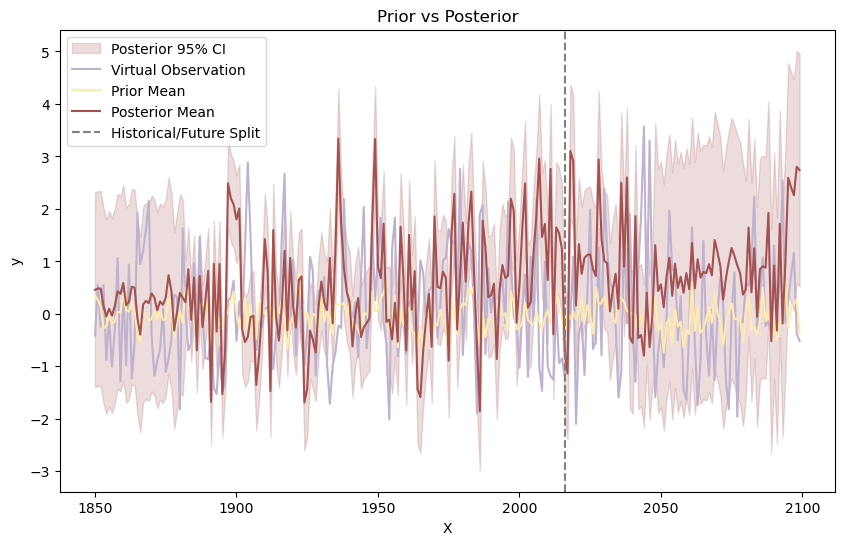

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.014e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.56e+07 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.01e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.704e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.609e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.142e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2645.1482588370473
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 12 - test lml: -89.18730596996394


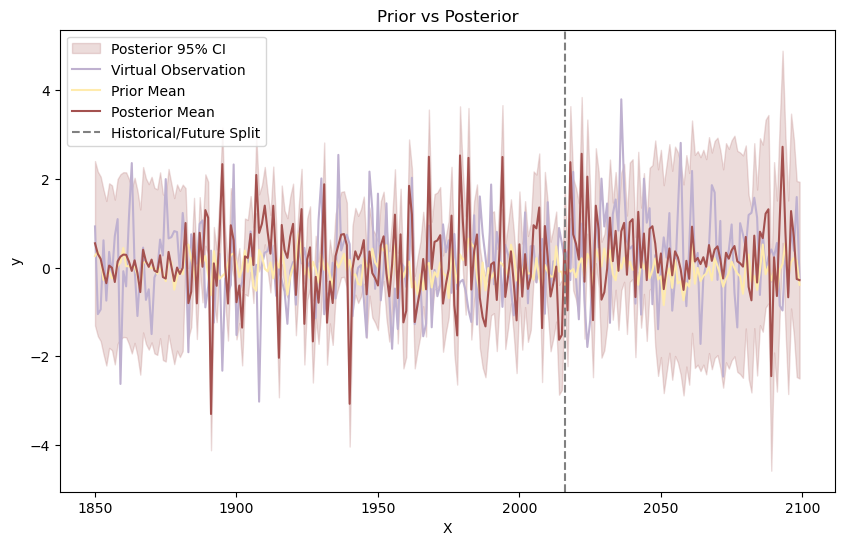

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.373e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.027e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.48e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.285e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.581e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.349e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.298e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.19e+07 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2634.3034016398165
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 13 - test lml: -95.39056516410905


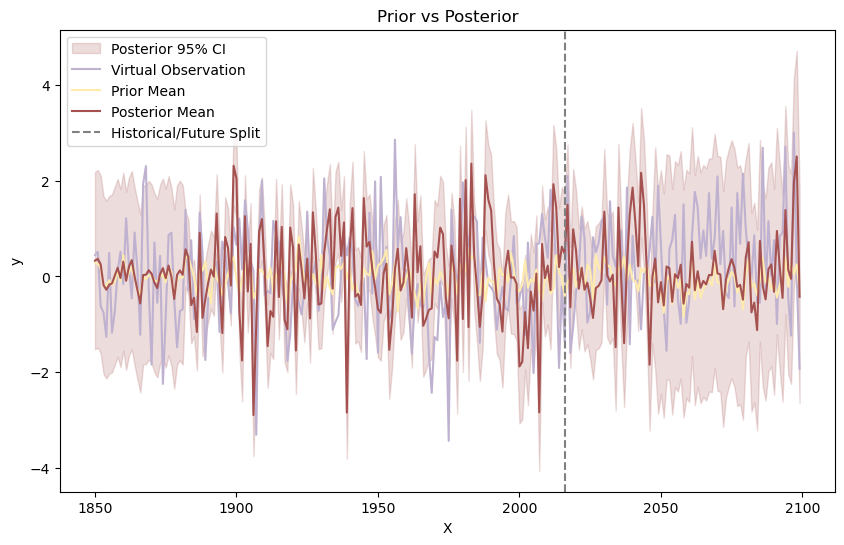

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.103e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.092e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.98e+07 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.13e+07 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.34e+07 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.247e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -6.214e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.239e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.923e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2642.343393150827
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 14 - test lml: -94.25409109132231


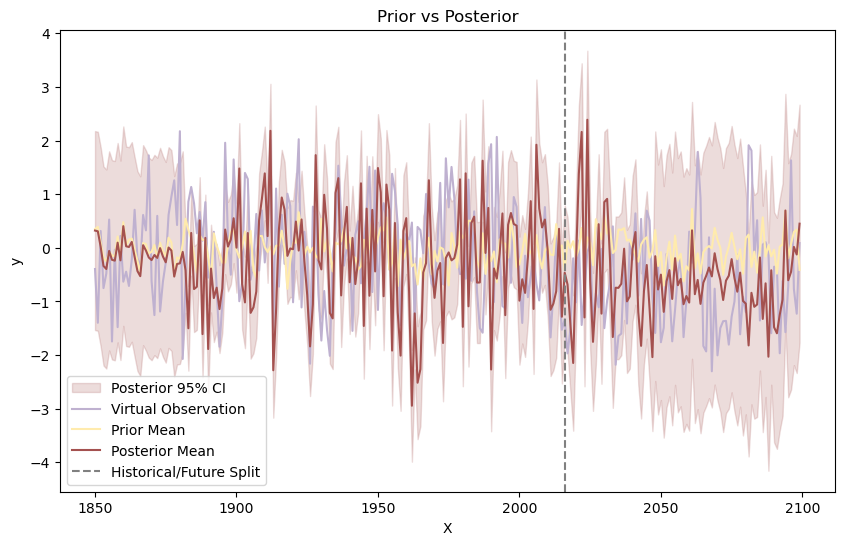

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.674e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.107e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.693e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.429e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.724e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.659e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.508e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.79e+07 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.475e+0 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.403e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2637.4438559894197
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 15 - test lml: -88.56488699366135


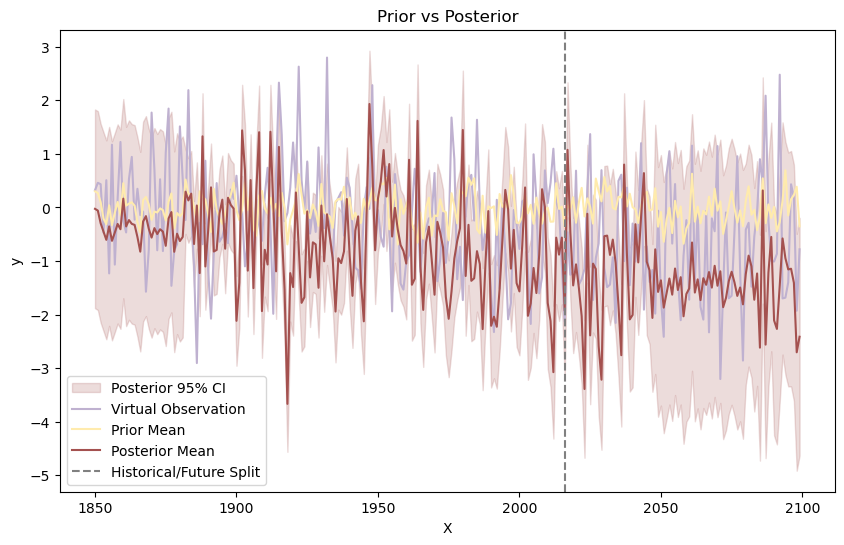

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.622e+0 |  2.377e-0 |  0.2419   |  0.9869   |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.536e+0 |  6.717e-0 |  0.6218   |  0.6569   |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.762e+0 |  7.188e-0 |  0.7836   |  0.6781   |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.047e+0 |  9.714e-0 |  0.9876   |  0.8378   |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.081e+0 |  5.93e-09 |  0.9608   |  0.3556   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.007e+0 |  3.738e-0 |  0.7837   |  0.4599   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  46       | -8.088e+0 |  3.452e-0 |  0.3343   |  0.224    |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.779e+0 |  8.113e-0 |  0.4241   |  0.611    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.291e+0 |  1.053e-0 |  0.4904   |  0.4606   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.67e+07 |  5.902e-0 |  0.5604   |  0.8046   |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.463e+0 |  7.222e-0 |  0.3129   |  0.5126   |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2641.1574581852346
Best kernel is: 0.1**2 * 8.07e-05**2 * DotProduct(sigma_0=8.62) ** 2 + 0.401**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 0.928**2 * ExpSineSquared(length_scale=0.011, periodic

Iteration 16 - test lml: -88.7827253071113


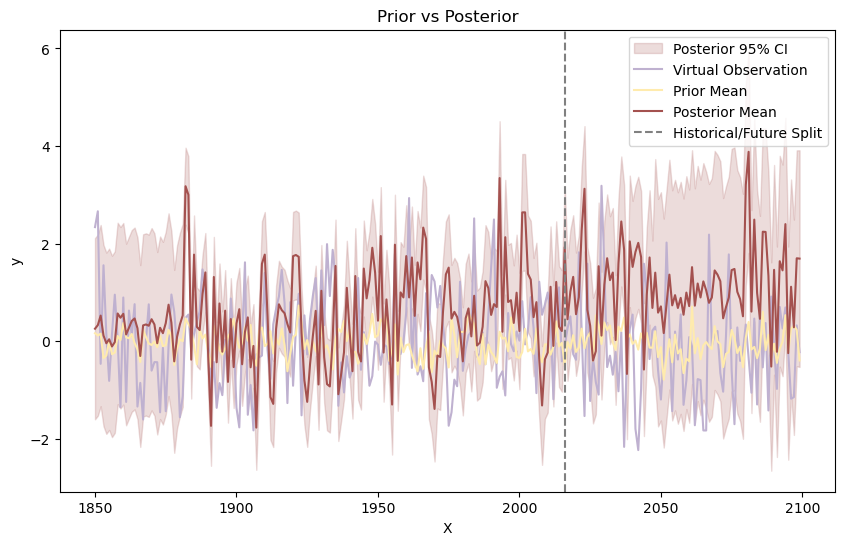

Total log marginal likelihood sum for the kernel structure: -1490.9268789232985


-1490.9268789232985

In [17]:
def pe2_poly(best_params):
    kernel = (
        0.01* C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.000000001, 0.00000001),
    'c2': (0.1, 1),
    'c3': (0.1, 1),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}
kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)

-1490.9268789232985

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.436e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.079e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.63e+07 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.325e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.621e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.094e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:01<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -3554.667897483011
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 1 - test lml: -111.97057588405319


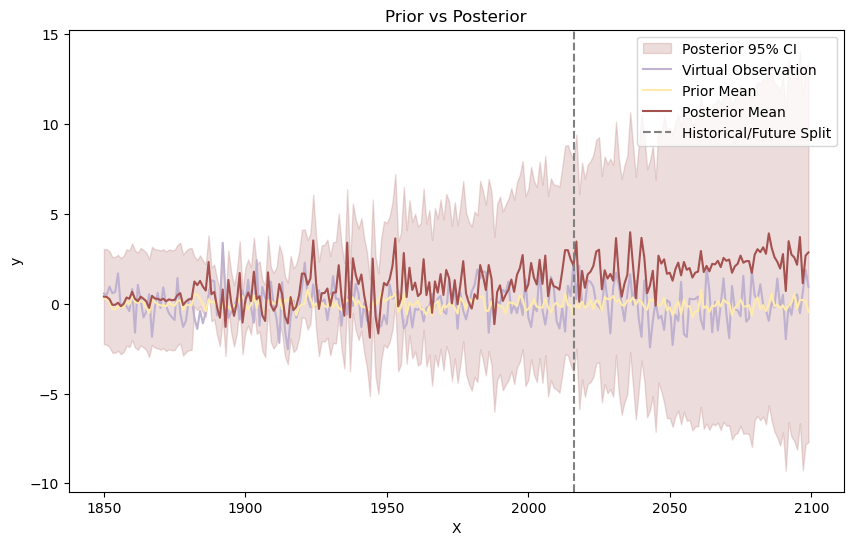

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.394e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.048e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.476e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.357e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.664e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.391e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:01<?, ?it/s]

|  48       | -5.61e+07 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.46e+07 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.382e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -3548.767891739778
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 2 - test lml: -111.14923018200332


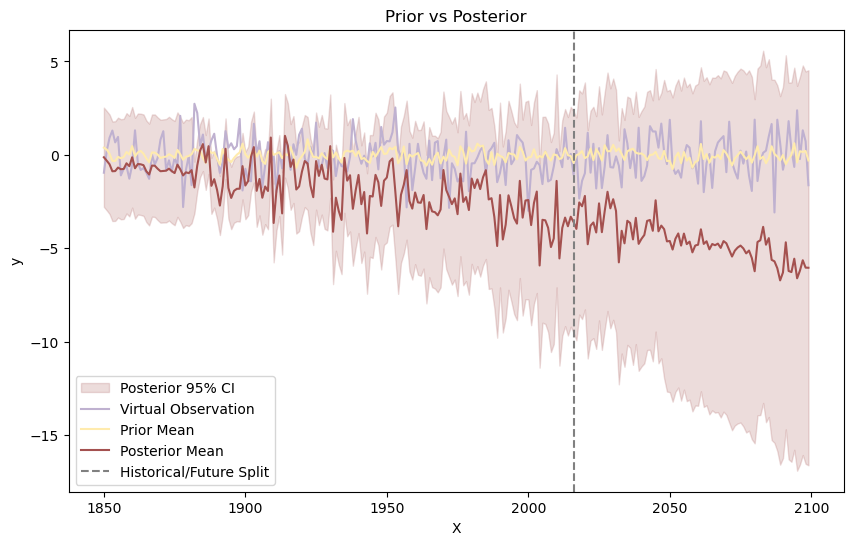

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.636e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.37e+07 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.792e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.608e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.025e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.561e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:01<?, ?it/s]

|  47       | -6.616e+0 |  0.000811 |  0.7841   |  1.179    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.939e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.532e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.562e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -3551.1858116884246
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 3 - test lml: -103.81137361890299


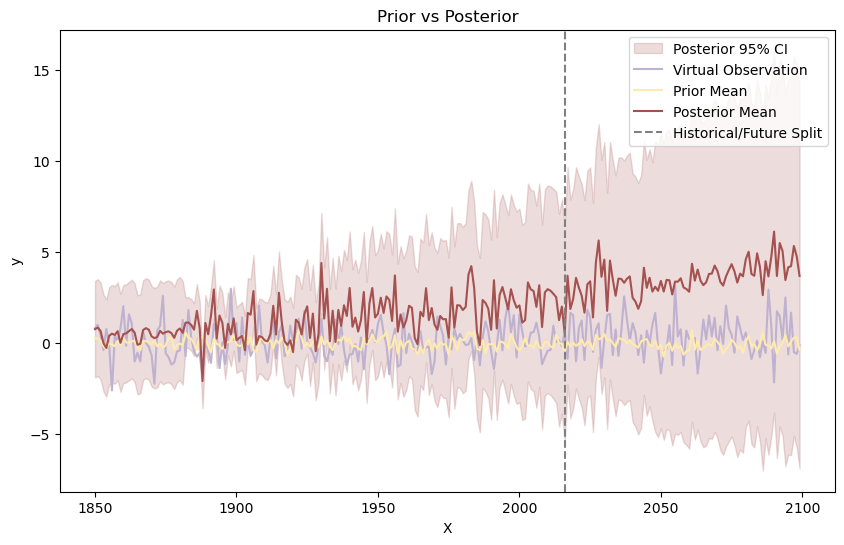

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.245e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.889e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.259e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.214e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.53e+07 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.261e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:02<?, ?it/s]

 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -3547.573363914079
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 4 - test lml: -114.9161625245502


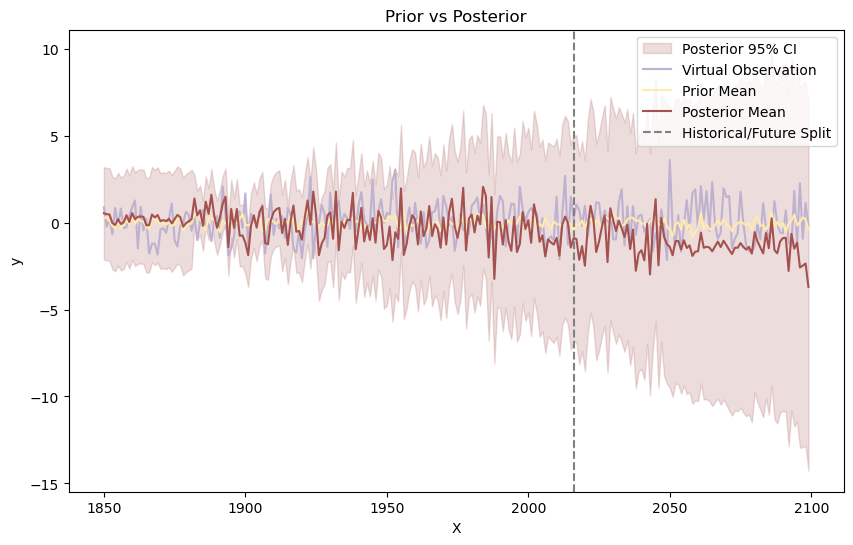

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.738e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.594e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.958e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.984e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.241e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.025e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -6.301e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.362e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.964e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -3552.091769583582
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 5 - test lml: -108.69167516522378


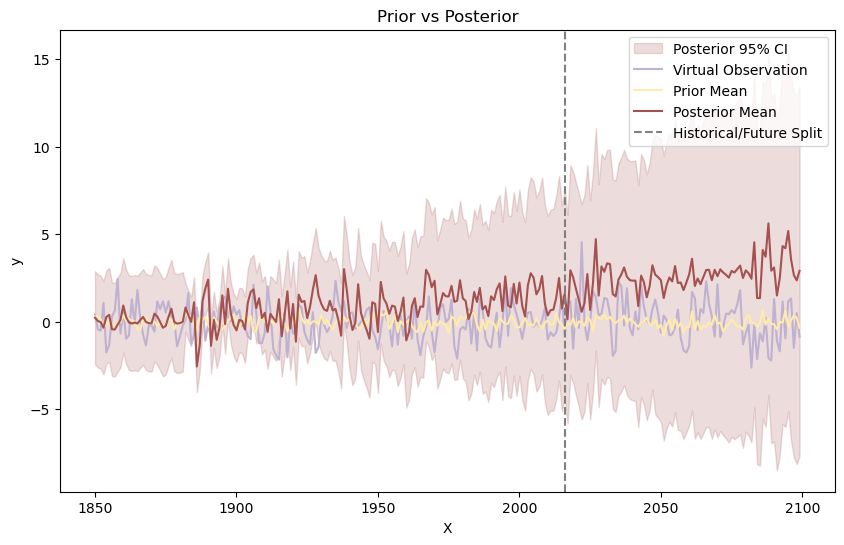

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.69e+07 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.163e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.549e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.496e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.89e+07 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.633e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -3549.995534480309
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 6 - test lml: -117.18332554574324


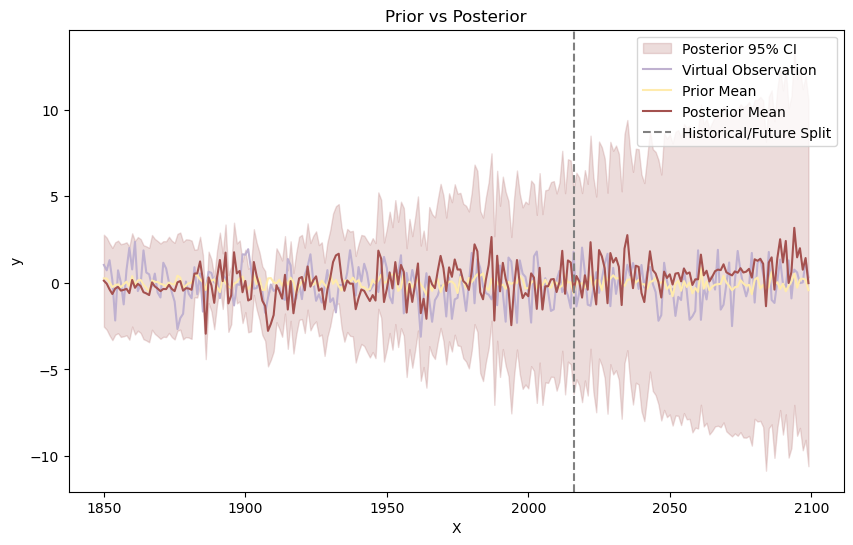

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.973e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.511e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.829e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.618e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.1e+07  |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.957e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:02<?, ?it/s]

|  45       | -8.262e+0 |  0.00018  |  0.7968   |  1.292    |  3.652    |  9.409    |  5.716    |  0.2459   |  6.844    |  3.049    |
|  46       | -7.964e+0 |  0.000345 |  0.5946   |  0.3618   |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.589e+0 |  0.000811 |  0.7841   |  1.179    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -6.147e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.735e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.904e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 7 - Best objective function value: -3551.7650478252526
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 7 - test lml: -116.01868306464


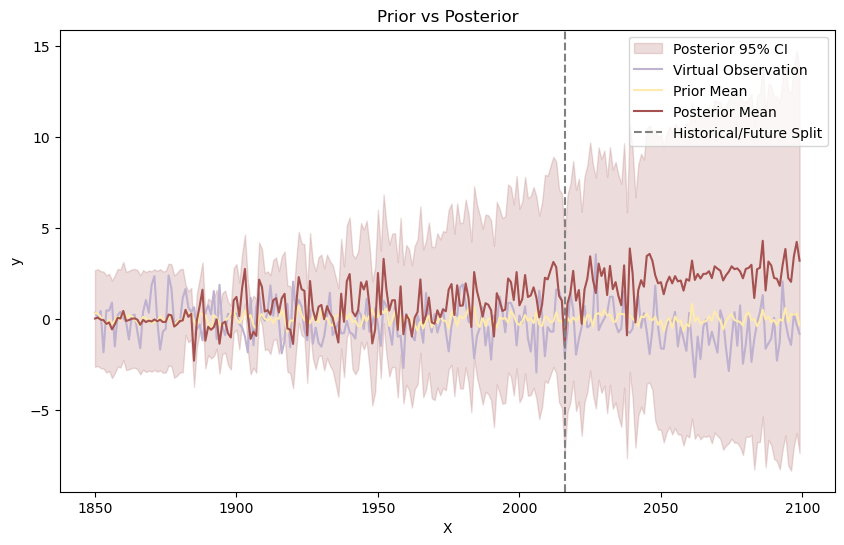

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.224e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.522e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -7.016e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.571e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.621e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.386e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -6.923e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -7.178e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -8.143e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -3554.8505150740025
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 8 - test lml: -106.2355995580987


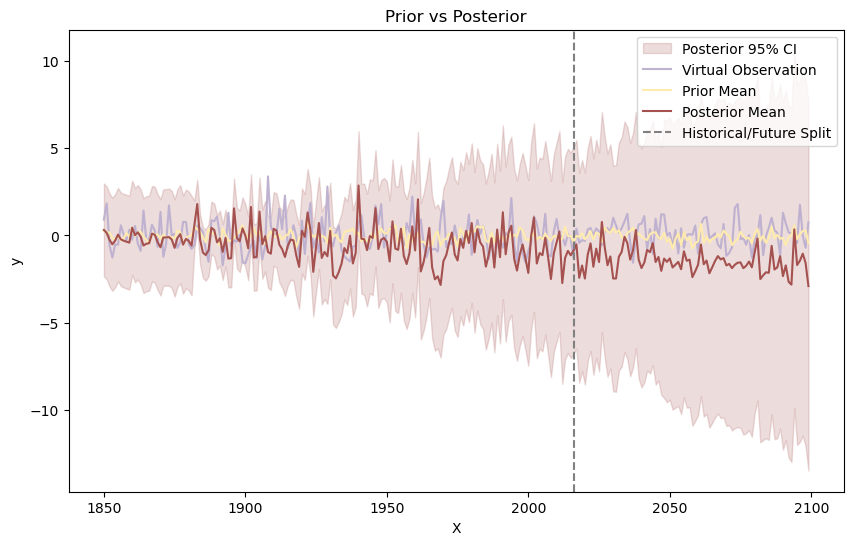

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.31e+07 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.947e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.373e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.247e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.612e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.334e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -6.185e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.153e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -3547.8378663505673
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 9 - test lml: -114.80388144797638


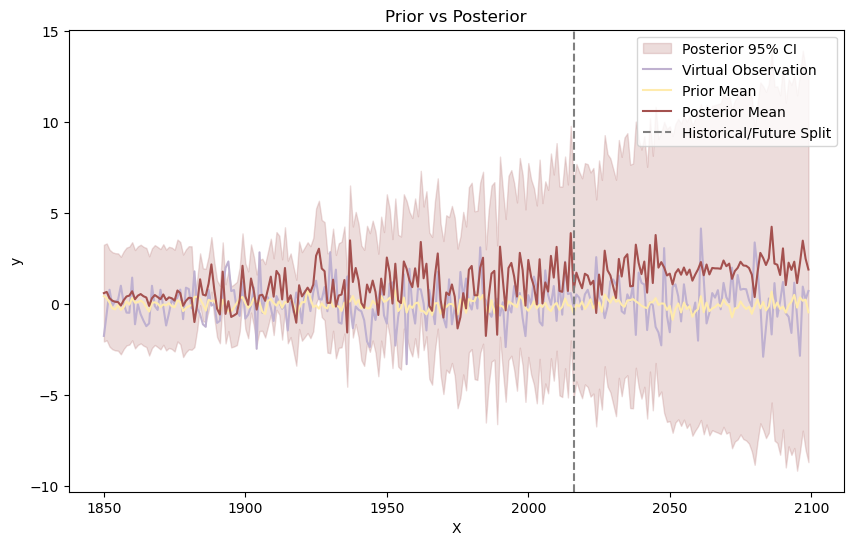

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.539e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.034e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.372e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.433e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.751e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.602e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -5.833e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.34e+07 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.274e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -3549.012791653302
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 10 - test lml: -114.26898990485087


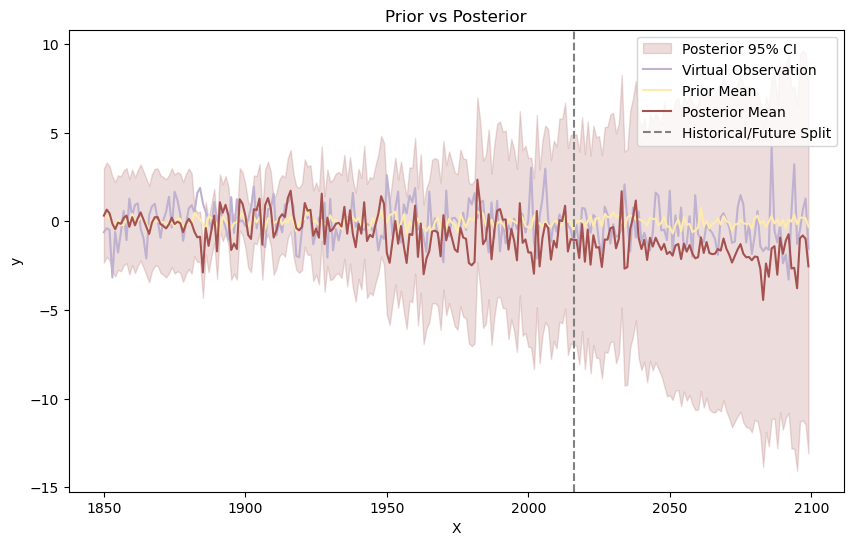

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.476e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.963e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.437e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.294e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.722e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.425e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:02<?, ?it/s]

|  50       | -7.34e+07 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -3549.702906167039
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 11 - test lml: -113.66628808952176


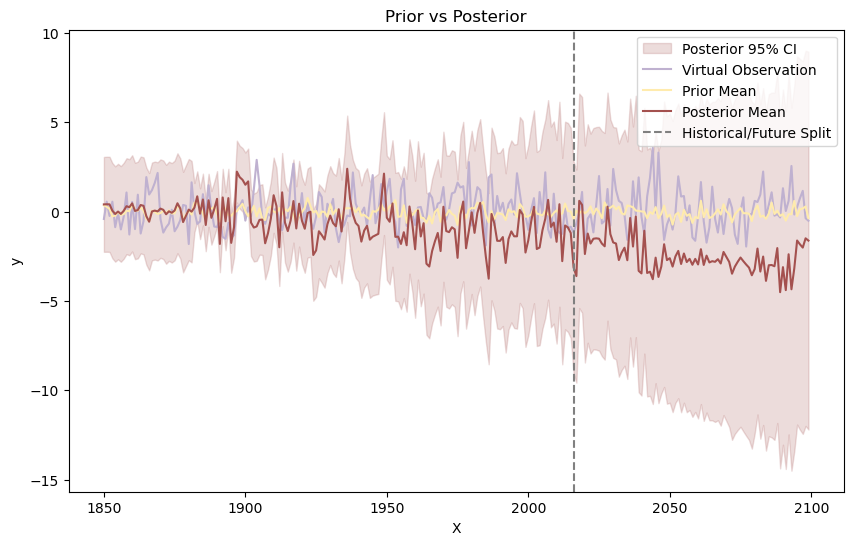

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.999e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.474e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.957e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.67e+07 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.605e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.111e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -7.199e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.75e+07 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -3554.2061865986607
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 12 - test lml: -109.88547463807475


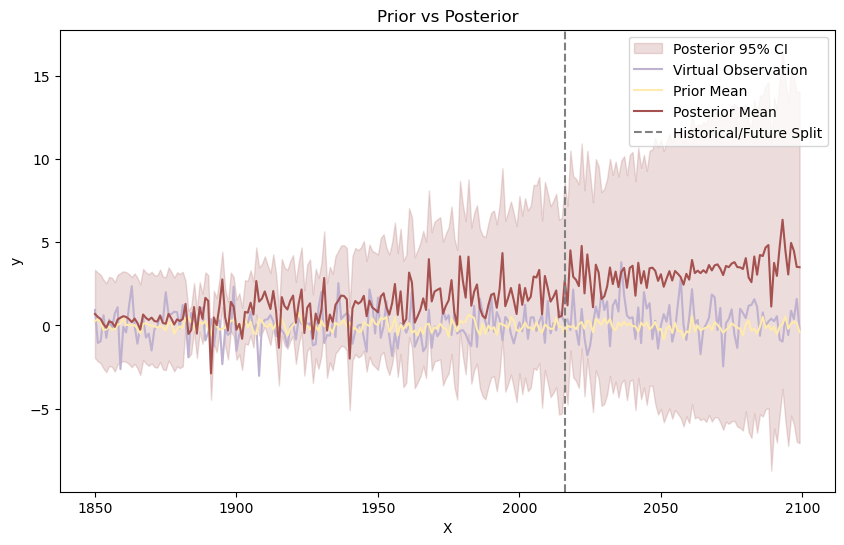

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.352e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -6.976e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.436e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.259e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.57e+07 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.32e+07 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -5.711e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.267e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.159e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -3548.6234719748413
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 13 - test lml: -113.13694243585459


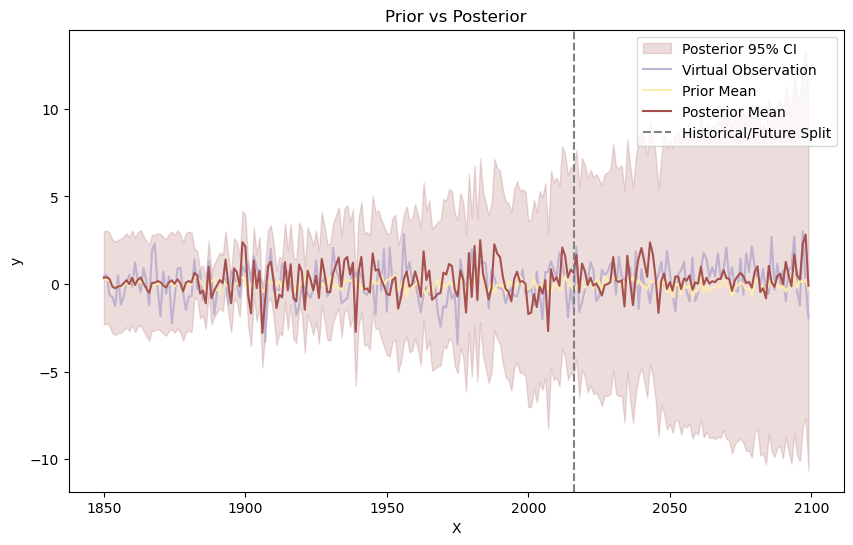

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -8.079e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -8.079e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.928e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.097e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.326e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -8.233e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:02<?, ?it/s]

|  50       | -7.876e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -3552.6986200122024
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)
Iteration 14 - test lml: -111.10498251537079


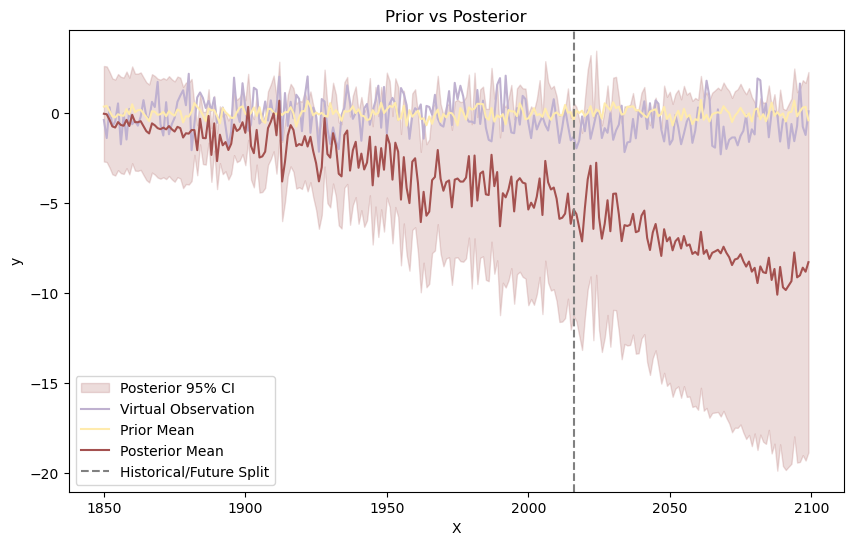

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.653e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.057e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.646e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -7.407e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -7.711e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.633e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:02<?, ?it/s]

|  46       | -7.667e+0 |  0.000345 |  0.5946   |  0.3618   |  1.861    |  6.394    |  9.068    |  0.7616   |  6.765    |  6.032    |
|  47       | -6.445e+0 |  0.000811 |  0.7841   |  1.179    |  7.739    |  2.987    |  3.185    |  0.09994  |  4.608    |  5.31     |
|  48       | -5.734e+0 |  0.000105 |  0.9241   |  0.8613   |  9.028    |  0.4369   |  3.533    |  0.8257   |  4.177    |  6.884    |
|  49       | -6.432e+0 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.375e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -3550.6629921475383
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + 

Iteration 15 - test lml: -109.04279910748001


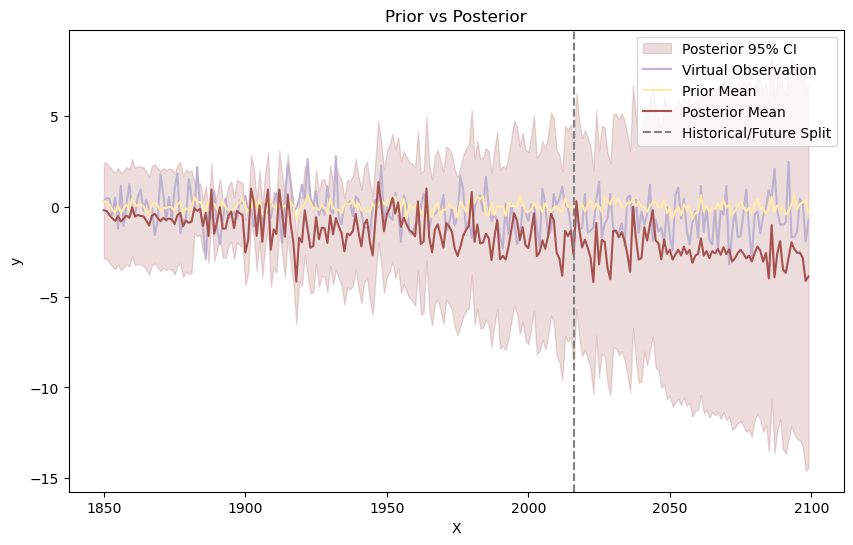

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c1     |    c2     |    c3     | dp_sig... |    ls1    |    ls2    |   noise   |   per1    |   per2    |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -7.594e+0 |  0.000237 |  0.3996   |  1.972    |  9.045    |  1.869    |  2.684    |  0.3341   |  5.578    |  4.006    |
|  2        | -7.495e+0 |  0.000671 |  1.202    |  1.276    |  3.678    |  2.589    |  1.952    |  0.5525   |  6.303    |  5.014    |
|  3        | -6.718e+0 |  0.000718 |  1.543    |  1.32     |  3.851    |  0.8102   |  8.077    |  0.8115   |  3.203    |  5.377    |
|  4        | -8.029e+0 |  0.000971 |  1.974    |  1.658    |  6.899    |  6.236    |  5.996    |  0.6816   |  6.355    |  4.84     |
|  5        | -8.066e+0 |  0.000593 |  1.917    |  0.6396   |  4.844    |  8.133    |  6.072    |  0.6352   |  4.667    |  6.125    |
|  6        | -7.979e+0 |  0.000373 |  1.543    |  0.8598   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:01<?, ?it/s]

|  49       | -6.64e+07 |  0.000590 |  1.072    |  1.587    |  8.049    |  5.609    |  1.126    |  0.2962   |  4.084    |  6.174    |
|  50       | -7.423e+0 |  0.000722 |  0.5495   |  0.971    |  1.084    |  2.199    |  4.192    |  0.4688   |  4.675    |  3.761    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -3552.1224327872533
Best kernel is: 0.0255**2 * DotProduct(sigma_0=8.62) ** 2 + 0.478**2 * ExpSineSquared(length_scale=1.03, periodicity=5.72) + 1.31**2 * ExpSineSquared(length_scale=0.011, periodicity=5.66) + WhiteKernel(noise_level=0.485)


Iteration 16 - test lml: -109.3142239379574


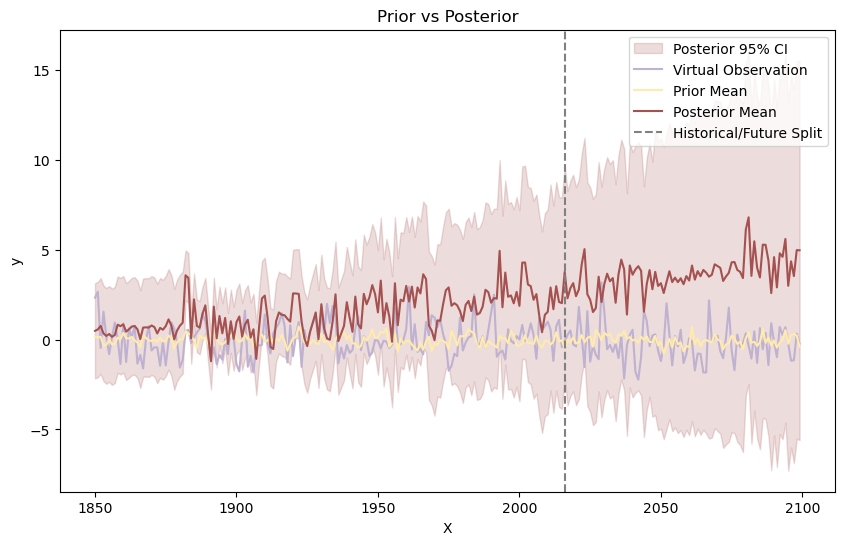

Total log marginal likelihood sum for the kernel structure: -1785.2002076203019


-1785.2002076203019

In [26]:
def pe2_poly(best_params):
    kernel = (
        C(best_params['c1']) * (DotProduct(sigma_0=best_params['dp_sigma_0']) ** 2) +
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c1': (0.0001, 0.001),
    'c2': (0.1, 2),
    'c3': (0.1, 2),
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'noise': (1e-6, 1),
    'dp_sigma_0': (1e-3, 10),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_poly)

-1785.2002076203019

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.34e+07 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.771e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -4.376e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -4.102e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.784e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.562e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 1):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -5.475e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -9.262e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -1640.667445145034
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 1 - test lml: -585.0060912028558


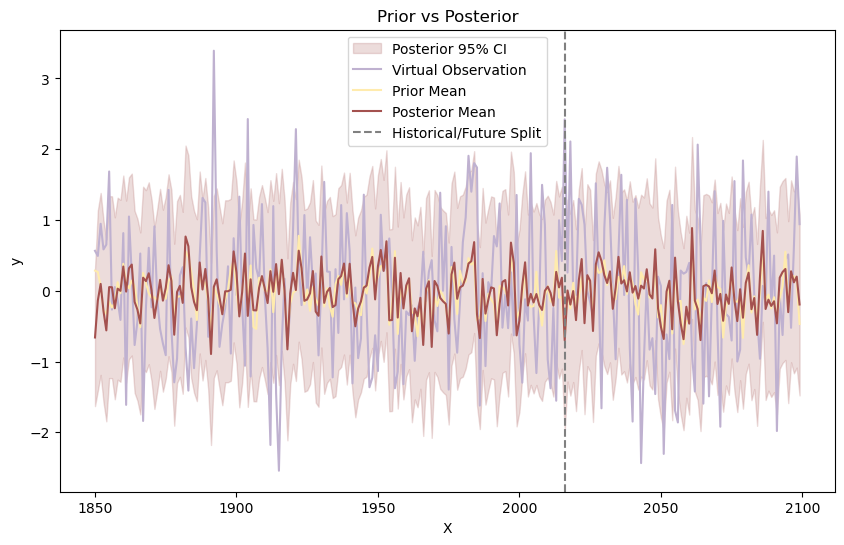

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.315e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.259e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.435e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.47e+07 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.09e+07 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.054e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 2):   0%|          | 0/100 [00:03<?, ?it/s]

|  50       | -8.434e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1606.2781210157034
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 2 - test lml: -623.3066521086523


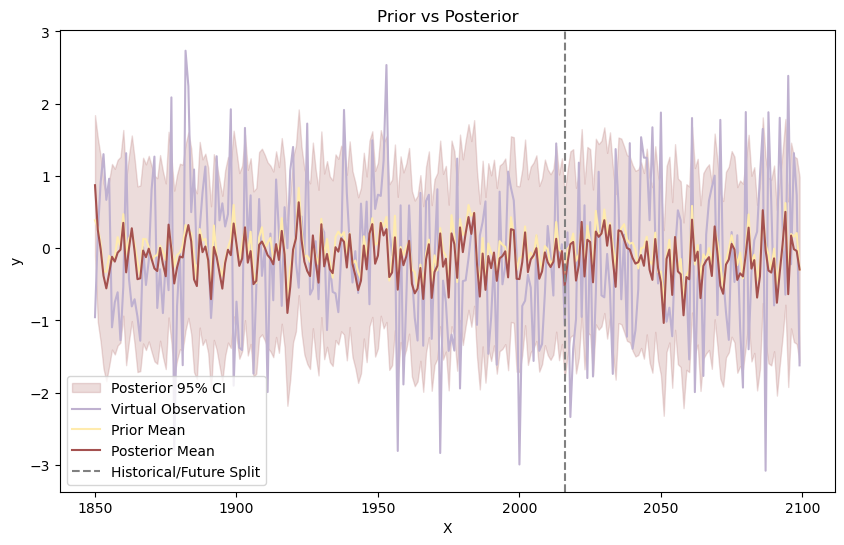

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.521e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.604e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.909e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.627e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.431e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.568e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 3):   0%|          | 0/100 [00:03<?, ?it/s]


An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -1675.0189599152343
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)
Iteration 3 - test lml: -649.4442738596928


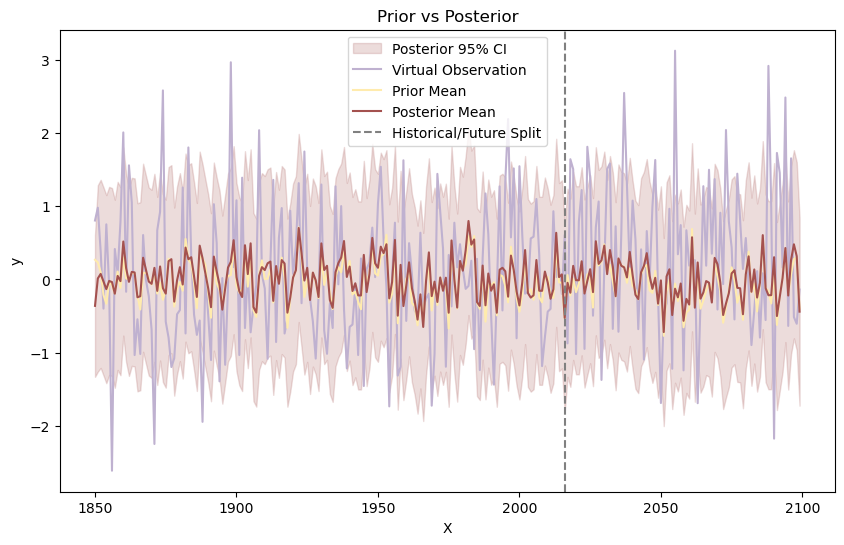

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.222e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.141e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.241e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.271e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -4.856e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -4.973e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 4):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1601.2601386545987
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 4 - test lml: -841.6609907835681


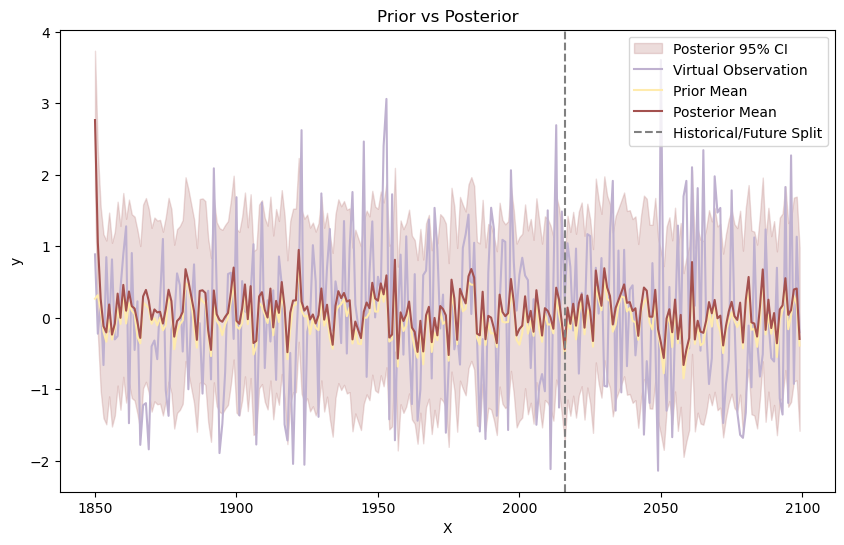

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.28e+07 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.582e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.473e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.374e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.336e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.466e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 5):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -4.912e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -1.158e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1615.261578522628
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 5 - test lml: -468.4438082386421


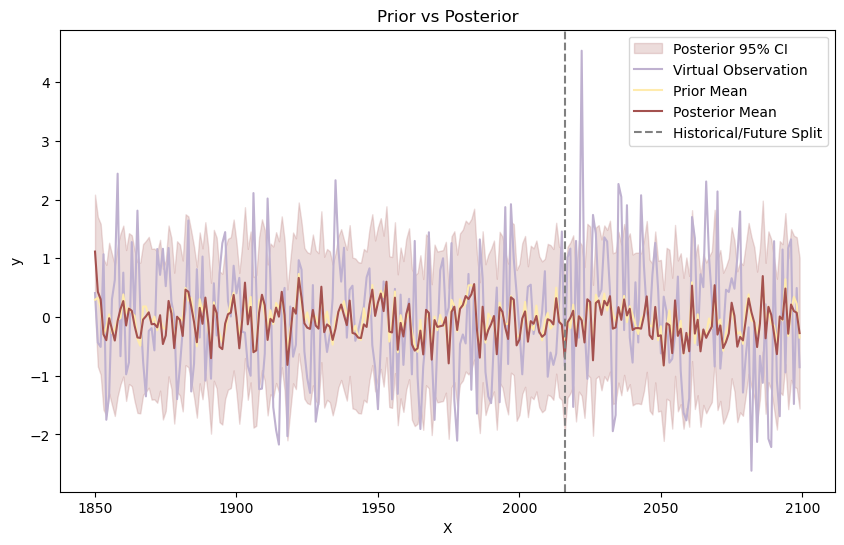

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.494e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.365e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.485e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.608e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.524e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.511e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 6):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -1639.3841717554064
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 6 - test lml: -529.331044336552


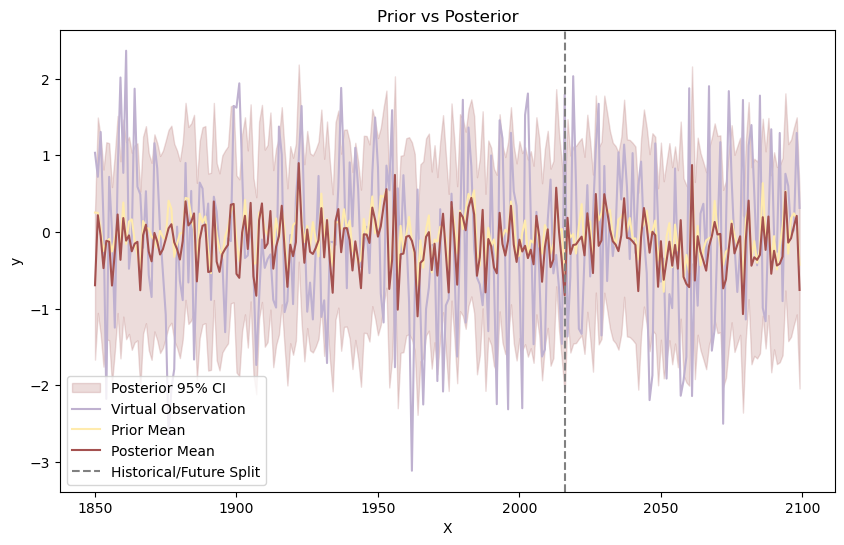

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.387e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.263e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.668e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.405e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.353e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.483e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 7):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -5.359e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -8.99e+05 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -1624.5024169135954
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 7 - test lml: -626.3623189391814


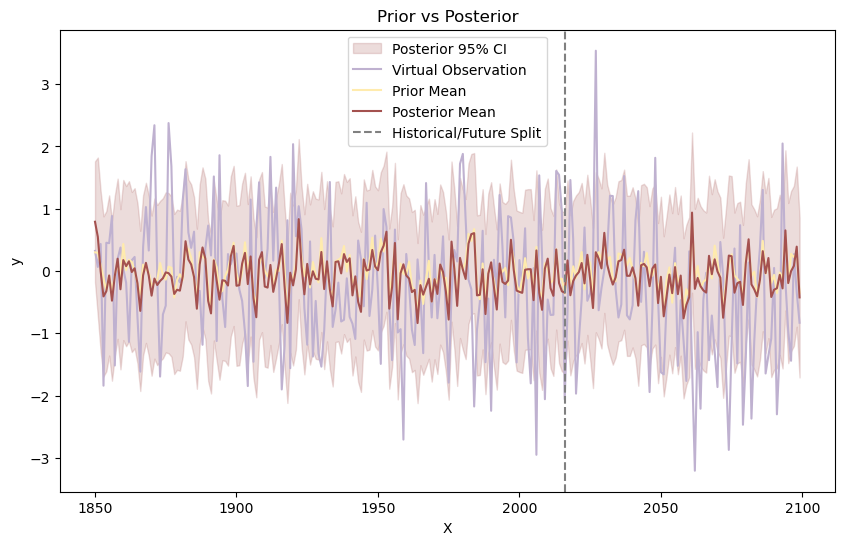

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.341e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -4.111e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.929e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.783e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.411e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.766e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 8):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1637.3127561664792
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 8 - test lml: -517.4272898639169


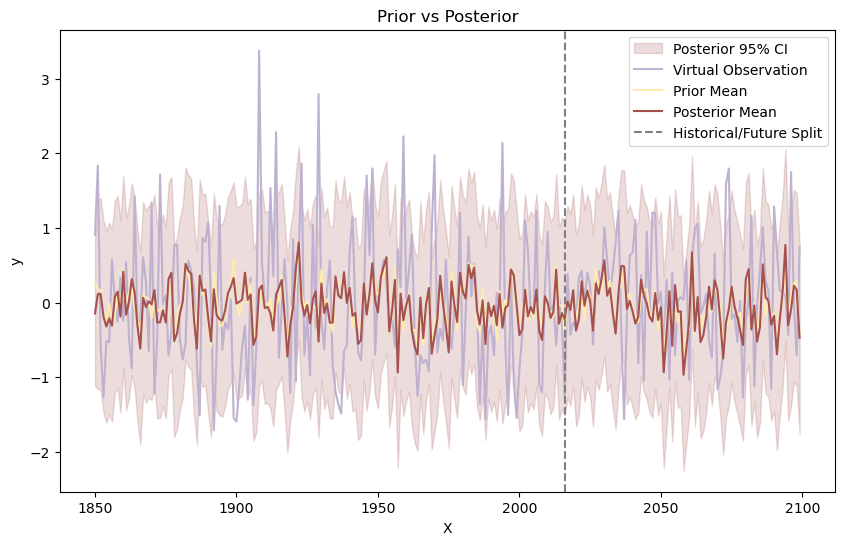

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.218e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.117e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.241e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.224e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -4.851e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -4.966e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 9):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -4.607e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -9.541e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1587.7438843608104
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 9 - test lml: -798.9558278314064


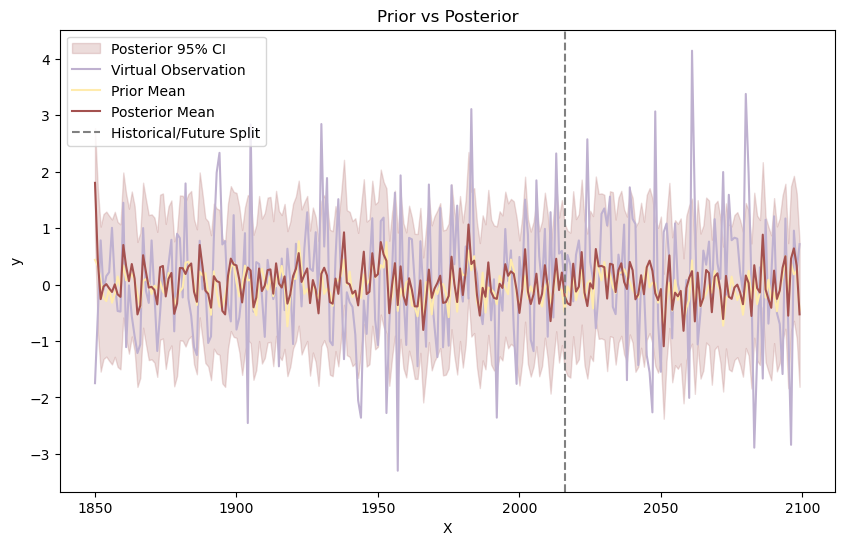

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.328e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.379e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.405e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.369e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.131e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.236e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 10):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -4.911e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -1.367e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1624.339478910783
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 10 - test lml: -772.1519585937543


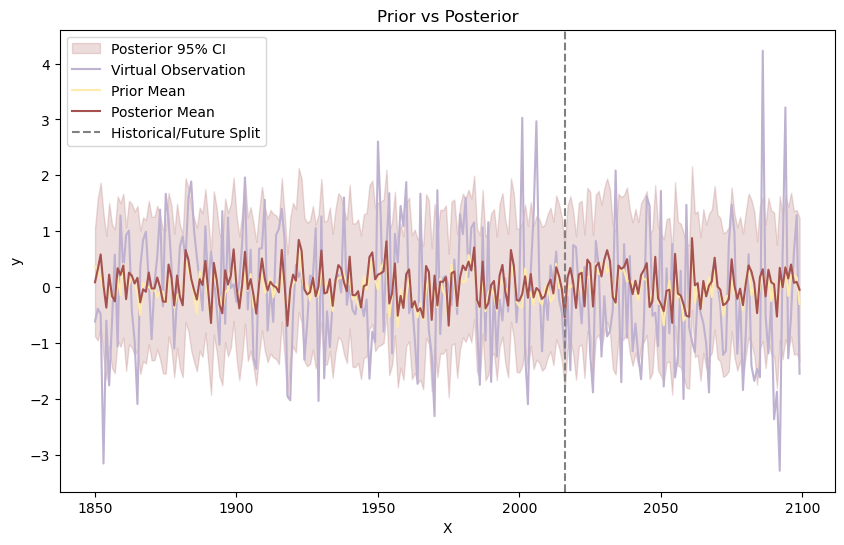

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.223e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.119e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.244e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.228e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -4.951e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.012e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 11):   0%|          | 0/100 [00:03<?, ?it/s]


Iteration 11 - Best objective function value: -1588.8613036106292
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)
Iteration 11 - test lml: -473.3033870620918


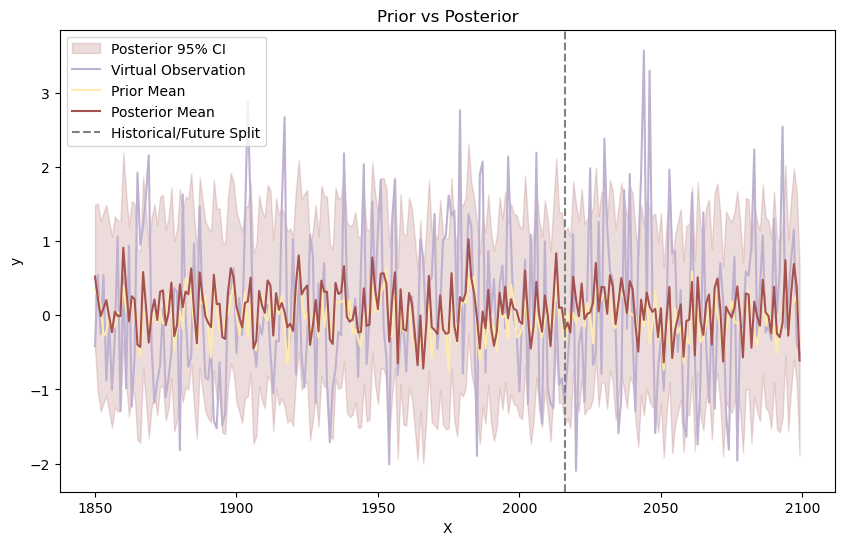

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.435e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.648e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.748e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -4.013e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.575e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.691e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 12):   0%|          | 0/100 [00:03<?, ?it/s]

|  50       | -1.468e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -1682.2902390680026
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 12 - test lml: -666.9198124964463


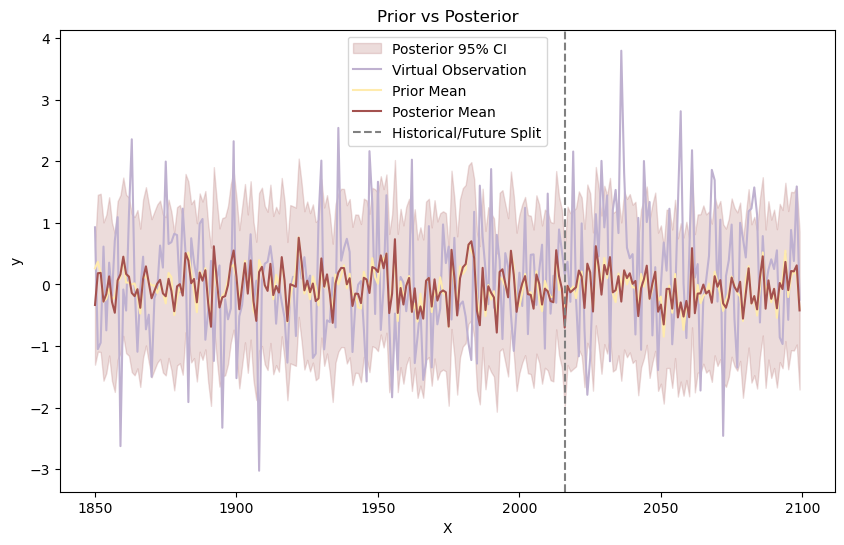

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.304e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.136e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.355e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.252e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -4.939e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.014e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 13):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -4.673e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -1.234e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1614.136710144465
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 13 - test lml: -641.2380214062047


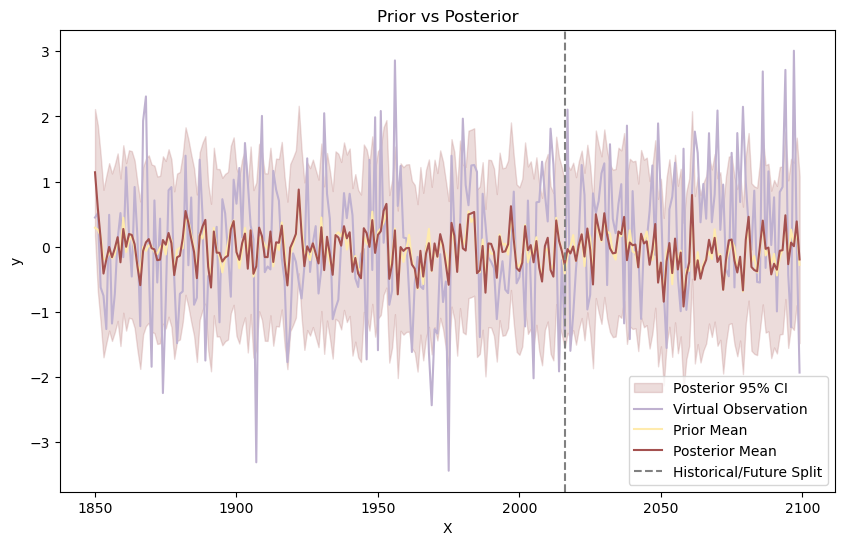

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.25e+07 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.644e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.497e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.453e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.181e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.418e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 14):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -4.918e+0 |  0.5451   |  0.512    |  0.7831   |  8.051    |  5.609    |  0.1117   |  4.185    |  4.084    |  7.938    |
|  50       | -9.566e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -1634.2542450065262
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 14 - test lml: -654.2110784675524


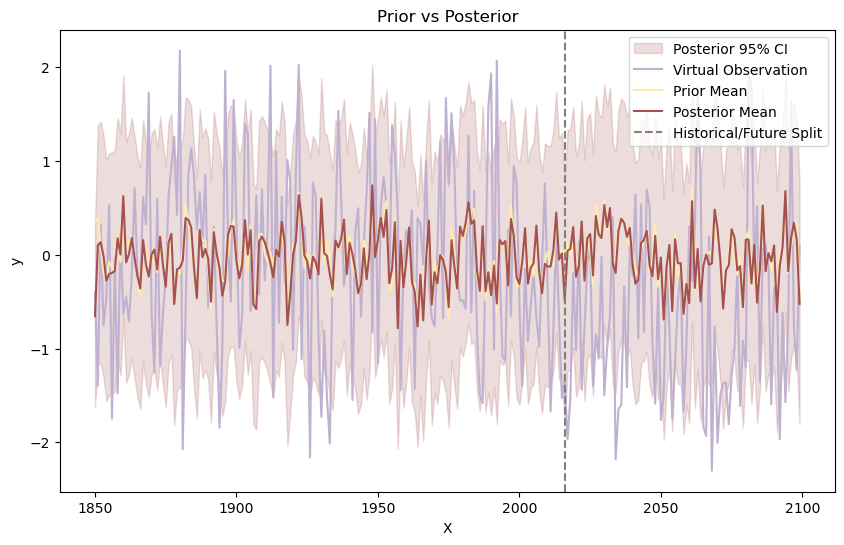

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.284e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.265e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.479e+0 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.409e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -5.085e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.265e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 15):   0%|          | 0/100 [00:03<?, ?it/s]

|  50       | -1.661e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -1652.5918197419523
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 15 - test lml: -474.927675441435


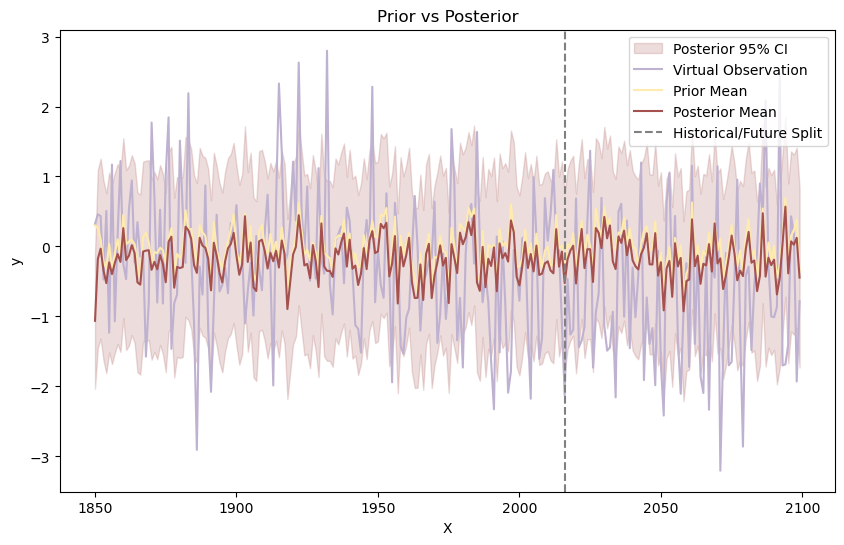

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls   |
-------------------------------------------------------------------------------------------------------------------------------------
|  1        | -1.231e+0 |  0.1539   |  0.1585   |  0.9855   |  9.046    |  1.869    |  0.2677   |  4.336    |  5.578    |  2.522    |
|  2        | -3.237e+0 |  0.6356   |  0.5802   |  0.6192   |  3.684    |  2.589    |  0.1944   |  5.21     |  6.303    |  5.039    |
|  3        | -3.28e+07 |  0.6879   |  0.7598   |  0.6427   |  3.856    |  0.8102   |  0.8075   |  6.246    |  3.203    |  5.947    |
|  4        | -3.401e+0 |  0.9683   |  0.9862   |  0.82     |  6.902    |  6.236    |  0.5992   |  5.726    |  6.355    |  4.606    |
|  5        | -4.966e+0 |  0.5482   |  0.9565   |  0.2847   |  4.849    |  8.133    |  0.6068   |  5.541    |  4.667    |  7.815    |
|  6        | -5.254e+0 |  0.3049   |  0.7599   |  0.4005   | 

Optimization Progress (iteration 16):   0%|          | 0/100 [00:03<?, ?it/s]

|  50       | -1.268e+0 |  0.6916   |  0.2374   |  0.4589   |  1.092    |  2.199    |  0.4187   |  4.875    |  4.675    |  1.911    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1619.1457441384168
Best kernel is: 0.74**2 * ExpSineSquared(length_scale=6.82, periodicity=6.39) + 0.834**2 * ExpSineSquared(length_scale=5.65, periodicity=3.38) + 0.646**2 * RBF(length_scale=0.945) + WhiteKernel(noise_level=0.0369)


Iteration 16 - test lml: -457.146060717163


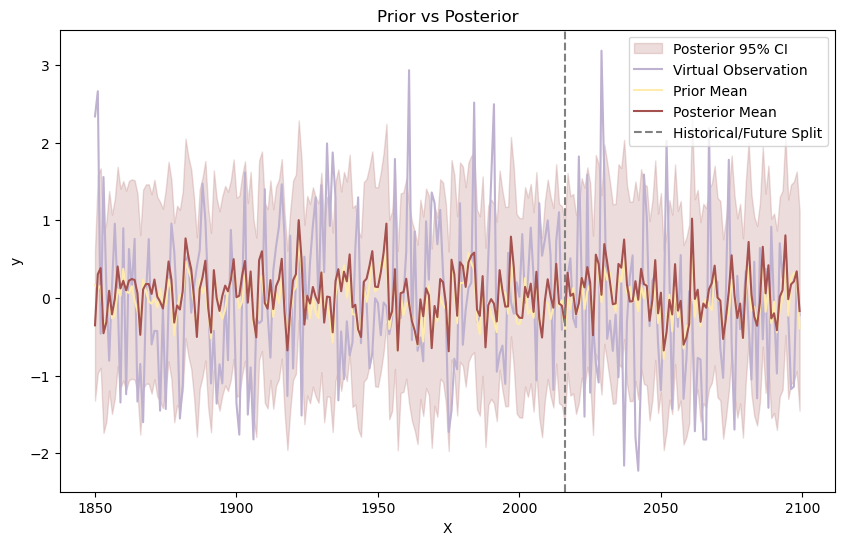

Total log marginal likelihood sum for the kernel structure: -9779.836291349113


-9779.836291349113

In [39]:
def pe2_rbf(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) +
        C(best_params['c_rbf']) * RBF(length_scale=best_params['rbf_ls']) +
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-3, 1),
    'c3': (1e-3, 1),
    'c_rbf': (1e-3, 1),  # New coefficient for RBF kernel
    'ls1': (1e-2, 1e1),
    'per1': (3, 7),
    'ls2': (1e-2, 1e1),
    'per2': (3, 7),
    'rbf_ls': (1e-2, 1e1),  # New parameter for RBF kernel length scale
    'noise': (1e-6, 1),
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, pe2_rbf)

-9700.535654928535

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -5.086e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.262e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.061e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.621e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.938e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 1):   0%|          | 0/100 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -1766.4501334807135
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 1 - test lml: -272.2780809104983


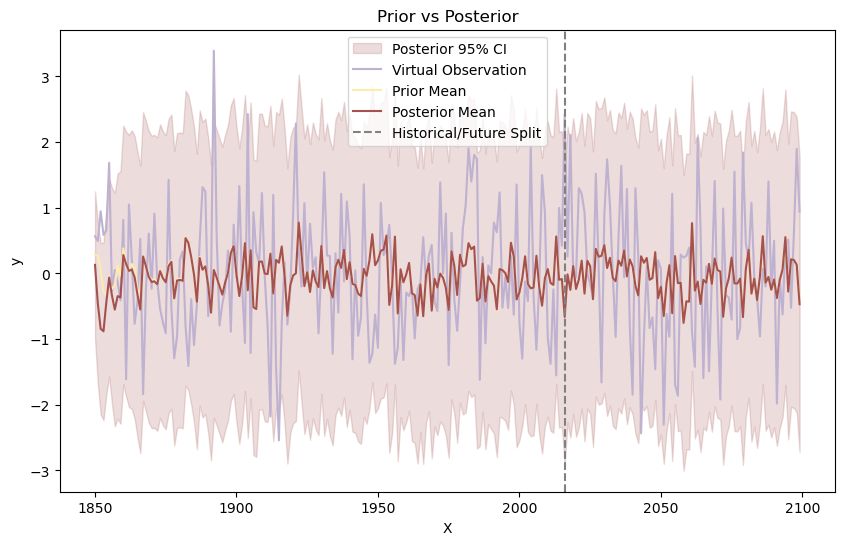

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -4.207e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -1.963e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -3.97e+05 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.427e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.372e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 2):   0%|          | 0/100 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1731.7625754479034
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 2 - test lml: -252.26442338833243


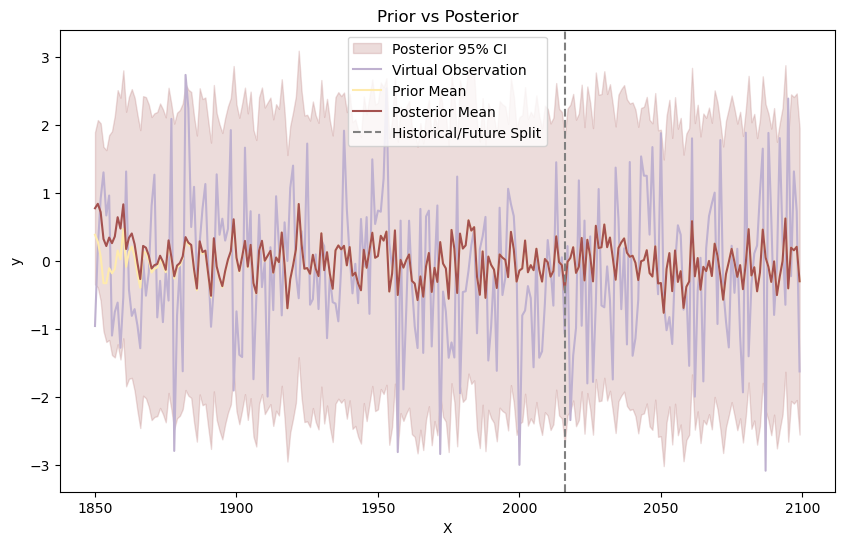

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -5.011e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -3.209e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -7.954e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -4.467e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.057e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 3):   0%|          | 0/100 [00:04<?, ?it/s]

|  49       | -3.498e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  4.583    |  1.519    |  2.364    |  5.848    |
|  50       | -1.269e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -1733.5467597309694
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 3 - test lml: -228.9529429524868


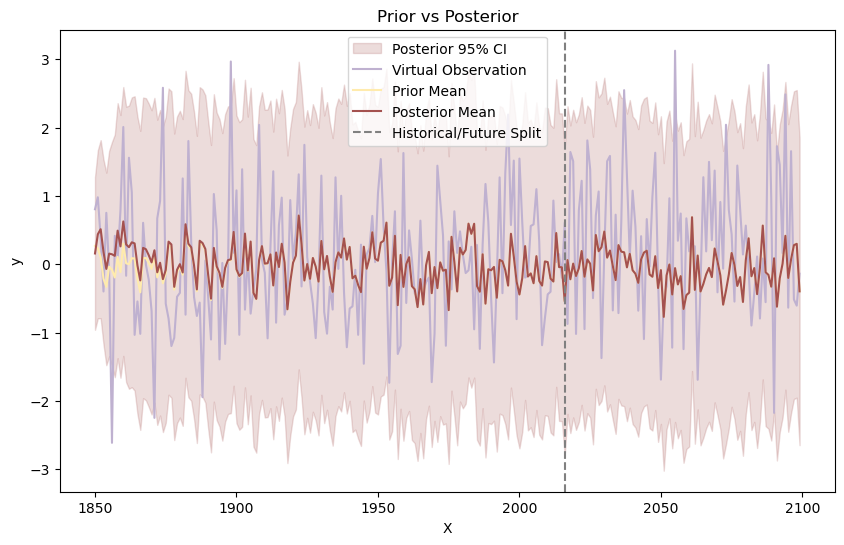

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.96e+03 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.355e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.057e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.651e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.573e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 4):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1718.4694332382014
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 4 - test lml: -307.01783418230866


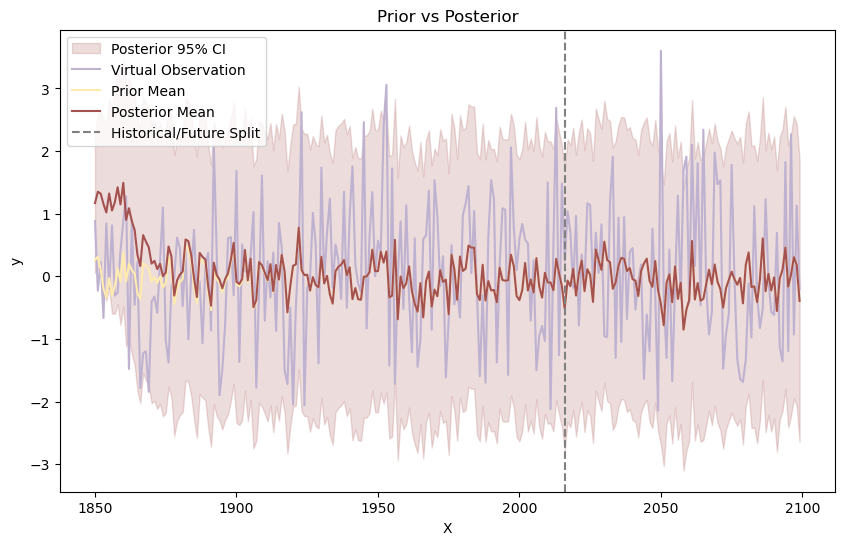

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.754e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.233e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.282e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.683e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.523e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 5):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -3.49e+03 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  4.583    |  1.519    |  2.364    |  5.848    |
|  50       | -1.172e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1738.7592836580643
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 5 - test lml: -241.34903170810543


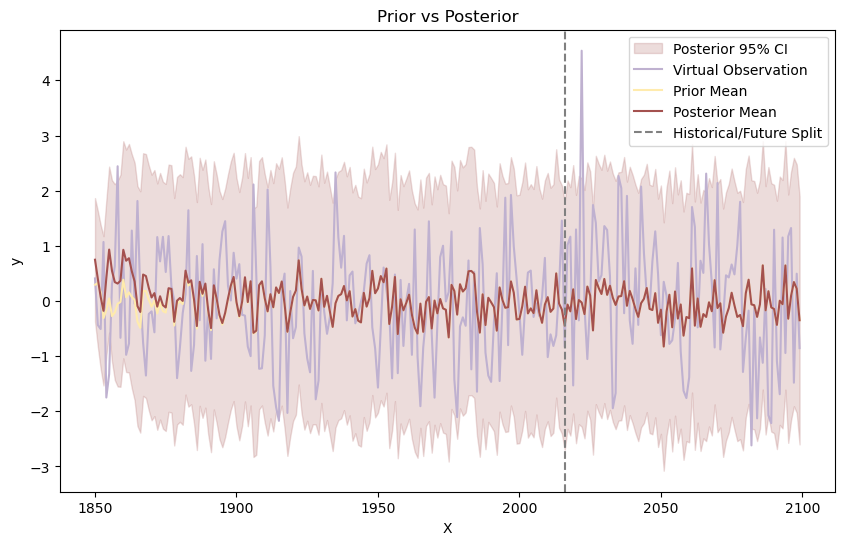

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.89e+03 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.176e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.871e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.682e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.59e+06 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 6):   0%|          | 0/100 [00:03<?, ?it/s]


Iteration 6 - Best objective function value: -1736.549033089668
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 6 - test lml: -276.40323535315025


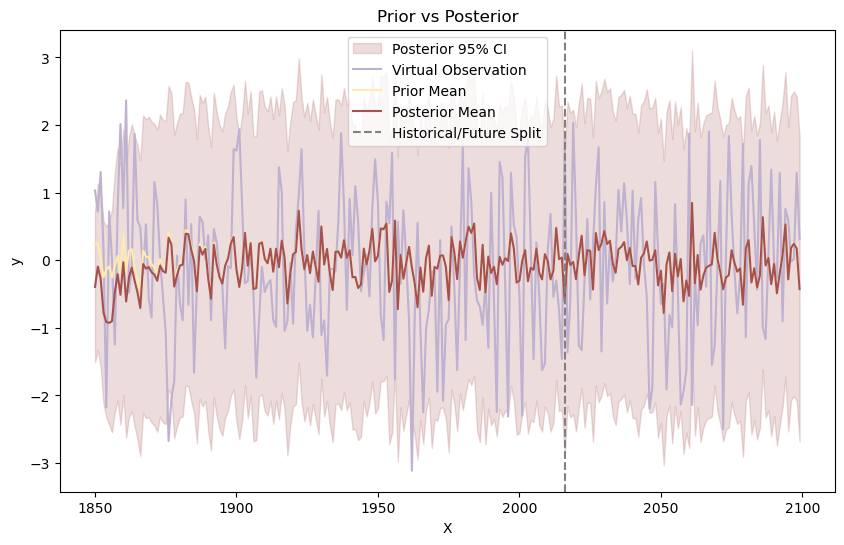

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.899e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.094e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.118e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.496e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.654e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 7):   0%|          | 0/100 [00:03<?, ?it/s]

|  48       | -3.495e+0 |  0.4859   |  0.9585   |  0.1009   |  85.67    |  3.941    |  0.1542   |  6.286    |  4.738    |  3.061    |  6.576    |  5.269    |
|  49       | -3.491e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  4.583    |  1.519    |  2.364    |  5.848    |
|  50       | -1.356e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.


Iteration 7 - Best objective function value: -1741.6606634817256
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 7 - test lml: -279.0787512061225


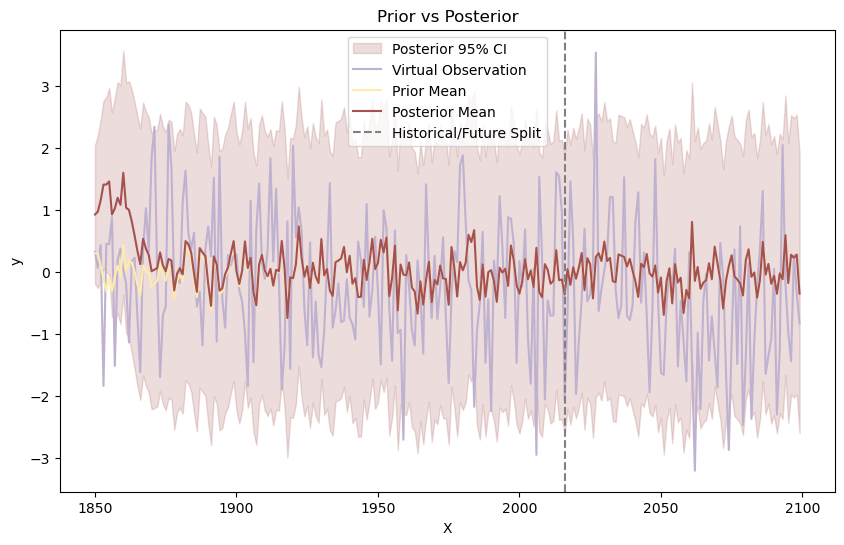

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -4.438e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.696e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.337e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.998e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.928e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 8):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1761.409340501147
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 8 - test lml: -235.95130942873539


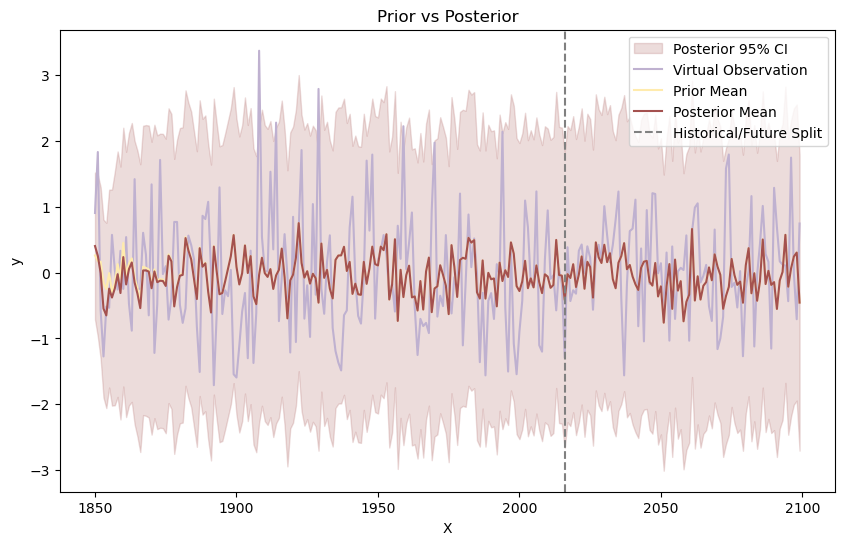

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.711e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.13e+05 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -3.972e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.476e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.626e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 9):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -3.483e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  4.583    |  1.519    |  2.364    |  5.848    |
|  50       | -1.221e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1717.8449797861683
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 9 - test lml: -272.63908105845644


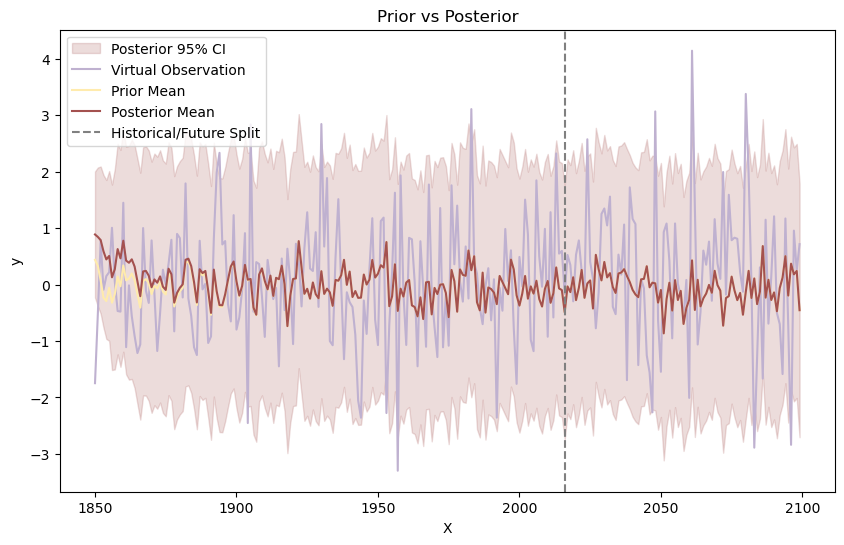

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.923e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.692e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -5.077e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -3.108e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.76e+06 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 10):   0%|          | 0/100 [00:03<?, ?it/s]

|  49       | -3.489e+0 |  0.6844   |  2.994    |  1.41     |  1.314    |  1.836    |  0.7449   |  5.335    |  4.583    |  1.519    |  2.364    |  5.848    |
|  50       | -1.308e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1729.3310378242777
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 10 - test lml: -249.16407958003794


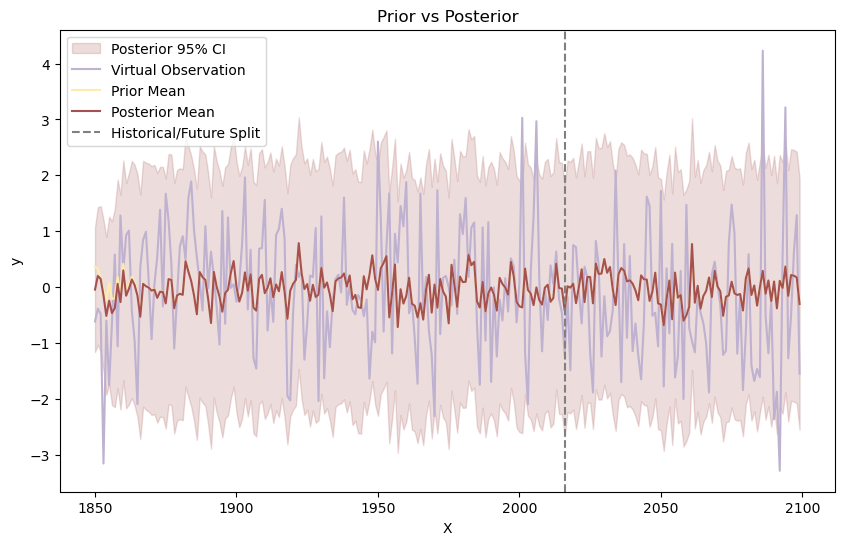

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.705e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.208e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.396e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.714e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.862e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 11):   0%|          | 0/100 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1728.9457103736593
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 11 - test lml: -265.4337532695069


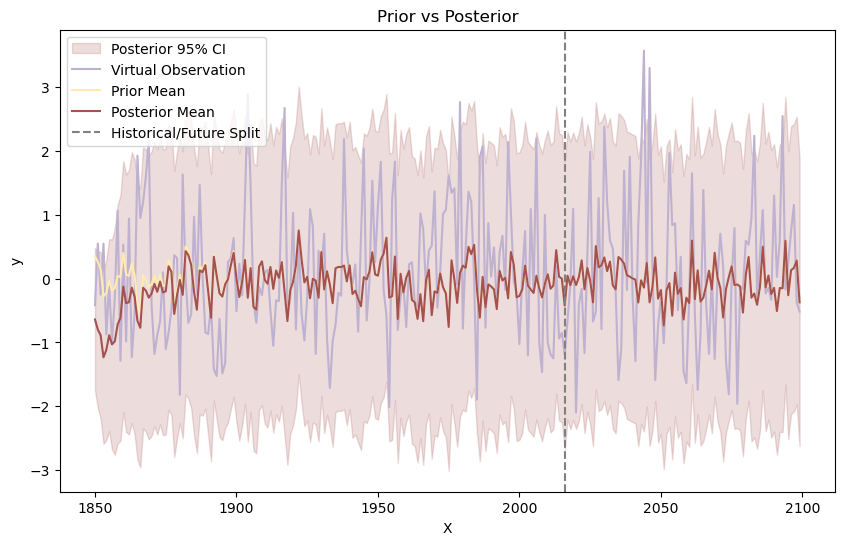

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -5.135e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -3.663e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -5.763e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -3.942e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.865e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 12):   0%|          | 0/100 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -1759.7877265156421
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 12 - test lml: -282.4416758968356


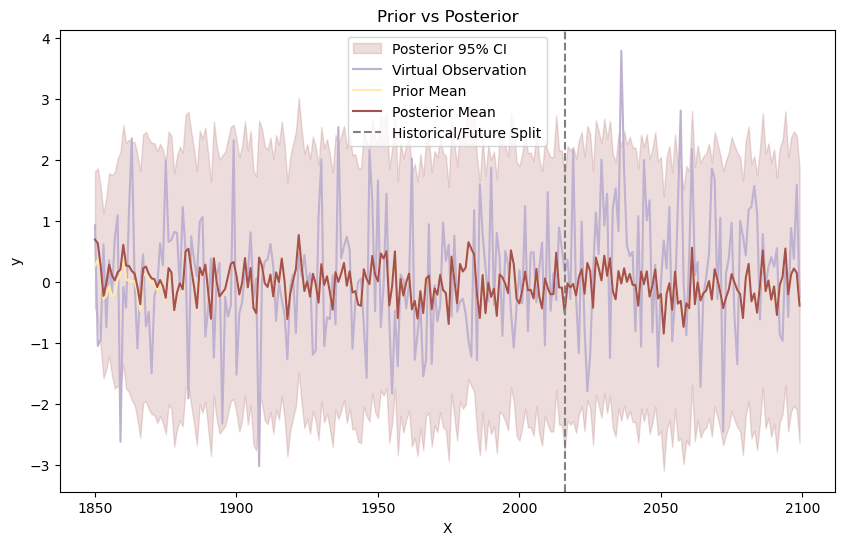

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.785e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.488e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.739e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.926e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.564e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 13):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1723.8307558272602
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 13 - test lml: -262.85186156673564


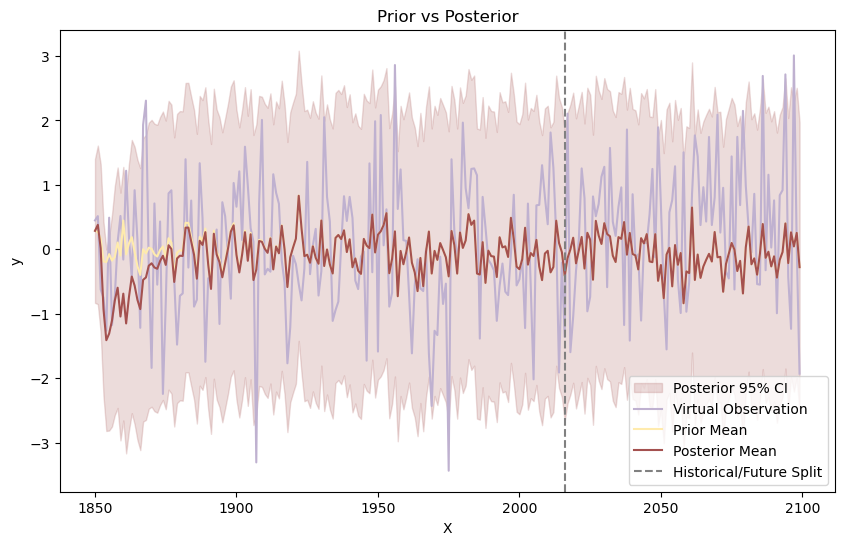

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -4.985e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.325e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.809e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.754e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.714e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 14):   0%|          | 0/100 [00:04<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -1755.1231426551594
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)
Iteration 14 - test lml: -276.66710016990197


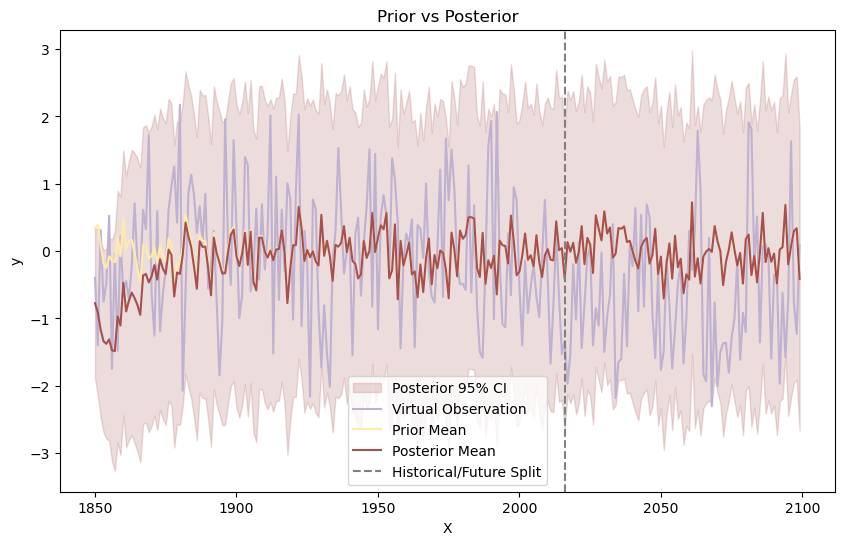

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -4.255e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.915e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.681e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -3.153e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -4.185e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 15):   0%|          | 0/100 [00:03<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -1738.203323110262
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 15 - test lml: -232.51305582278104


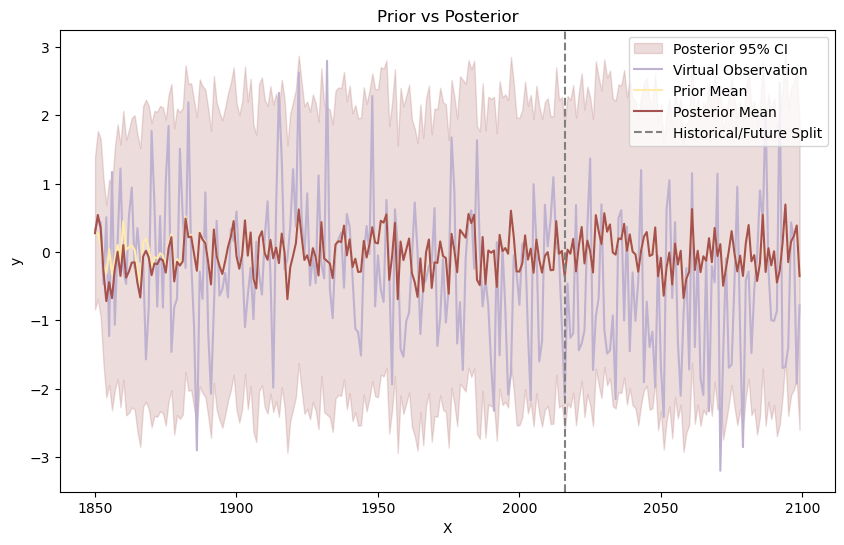

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   |    c2     |    c3     |   c_rbf   |    ls1    |    ls2    |   noise   |   per1    |   per2    |  rbf_ls1  |  rbf_ls2  |  rbf_ls3  |
-------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.956e+0 |  0.5439   |  0.5573   |  2.958    |  90.45    |  1.869    |  0.2677   |  4.336    |  5.578    |  25.15    |  6.356    |  5.802    |
|  2        | -2.216e+0 |  1.895    |  1.167    |  0.8487   |  19.44    |  5.53     |  0.8256   |  5.014    |  5.75     |  75.96    |  6.427    |  3.856    |
|  3        | -4.189e+0 |  0.3323   |  2.442    |  2.453    |  5.092    |  5.947    |  0.9683   |  6.945    |  6.279    |  68.99    |  6.236    |  5.996    |
|  4        | -2.552e+0 |  2.077    |  2.532    |  1.434    |  54.78    |  9.565    |  0.284    |  4.937    |  6.253    |  60.69    |  6.355    |  4.173    |
|  5        | -3.729e+0 |  2.366    |  0.9822   |  2

Optimization Progress (iteration 16):   0%|          | 0/100 [00:04<?, ?it/s]

|  50       | -1.163e+0 |  1.917    |  1.813    |  0.7142   |  16.73    |  9.17     |  0.2025   |  5.548    |  3.815    |  61.02    |  6.432    |  6.743    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1739.0599170326714
Best kernel is: 0.449**2 * ExpSineSquared(length_scale=80.9, periodicity=4.03) * RBF(length_scale=25.2) + 0.964**2 * ExpSineSquared(length_scale=3.85, periodicity=6.28) * RBF(length_scale=8.63) + 0.434**2 * RBF(length_scale=0.321) + WhiteKernel(noise_level=0.233)


Iteration 16 - test lml: -211.5652975540375


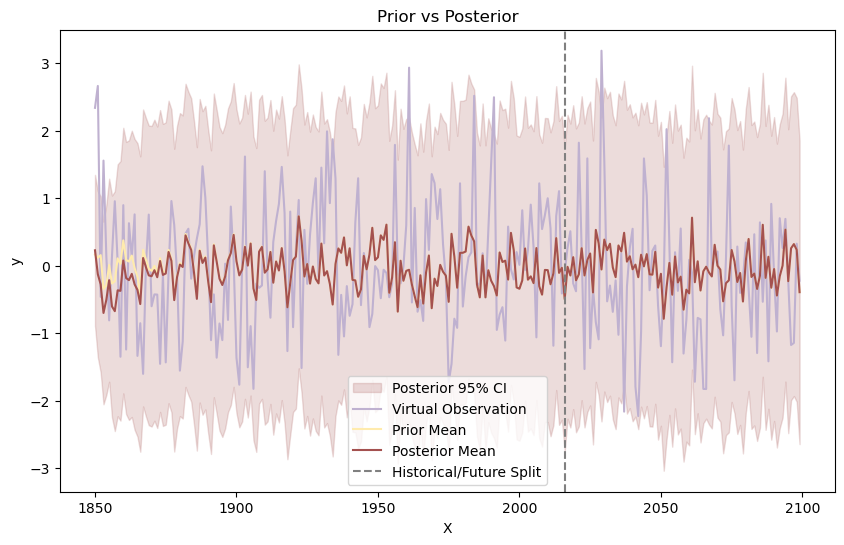

Total log marginal likelihood sum for the kernel structure: -4146.571514048033


-4146.571514048033

In [30]:
from sklearn.gaussian_process.kernels import RBF, ExpSineSquared, WhiteKernel, ConstantKernel as C

def rbfpe2_rbf(best_params):
    kernel = (
        C(best_params['c2']) * ExpSineSquared(length_scale=best_params['ls1'], periodicity=best_params['per1']) * RBF(length_scale=best_params['rbf_ls1']) +
        C(best_params['c3']) * ExpSineSquared(length_scale=best_params['ls2'], periodicity=best_params['per2']) * RBF(length_scale=best_params['rbf_ls2']) +
        C(best_params['c_rbf']) * RBF(length_scale=best_params['rbf_ls3']) +  # 新增的RBF核函数
        WhiteKernel(noise_level=best_params['noise'])
    )
    return kernel

pbounds = {
    'c2': (1e-1, 3),
    'c3': (1e-1, 3),
    'c_rbf': (1e-1, 3),          # 新增RBF核函数的常数项
    'ls1': (1e-2, 100),
    'per1': (3, 7),
    'ls2': (1e-2, 10),
    'per2': (3, 7),
    'rbf_ls1': (1e-2, 100),       # 第一个 RBF 核函数的长度尺度
    'rbf_ls2': (1e-2, 10),       # 第二个 RBF 核函数的长度尺度
    'rbf_ls3': (1e-2, 10),       # 新增的 RBF 核函数的长度尺度
    'noise': (1e-6, 1),
}
kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, rbfpe2_rbf)


-4146

## Poly(PE)

In [13]:
class CustomPolynomialKernel(Kernel):
    def __init__(self, degree=2, periods=[1, 1, 1], include_bias=False):
        self.degree = degree
        self.periods = periods if isinstance(periods, (list, np.ndarray)) else [periods]
        self.include_bias = include_bias
        self.poly = PolynomialFeatures(degree=self.degree, include_bias=self.include_bias)
    
    def periodic_transform(self, X):
        return np.hstack([np.cos(2 * np.pi * X / p) for p in self.periods] +
                         [np.sin(2 * np.pi * X / p) for p in self.periods])
    
    def __call__(self, X, Y=None, eval_gradient=False):
        X_transformed = self.periodic_transform(X)
        if Y is None:
            Y_transformed = X_transformed
        else:
            Y_transformed = self.periodic_transform(Y)
        
        K = self.poly.fit_transform(X_transformed).dot(self.poly.fit_transform(Y_transformed).T)
        
        if eval_gradient:
            K_gradient = np.zeros((X_transformed.shape[0], Y_transformed.shape[0], 0))
            return K, K_gradient
        else:
            return K
    
    def diag(self, X):
        return np.diag(self.__call__(X))
    
    def is_stationary(self):
        return False

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.013e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.52e+06 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.183e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.396e+0 |  0.6

Optimization Progress (iteration 1):   0%|          | 0/100 [00:14<?, ?it/s]

|  50       | -4.428e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2193.758456747633
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 1 - test lml: -1648.7001961723704


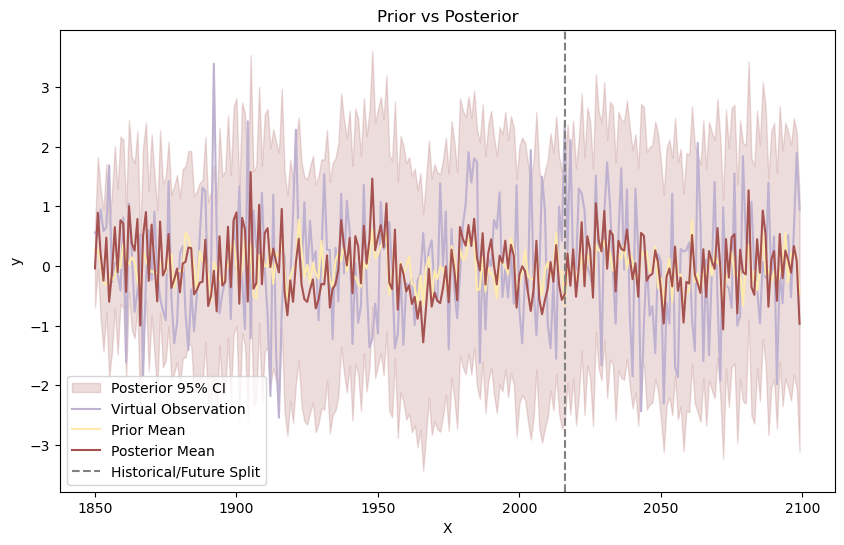

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.678e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.269e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.708e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.188e+0 |  0.6

Optimization Progress (iteration 2):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -3.849e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -2037.092903771272
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 2 - test lml: -1583.624405444506


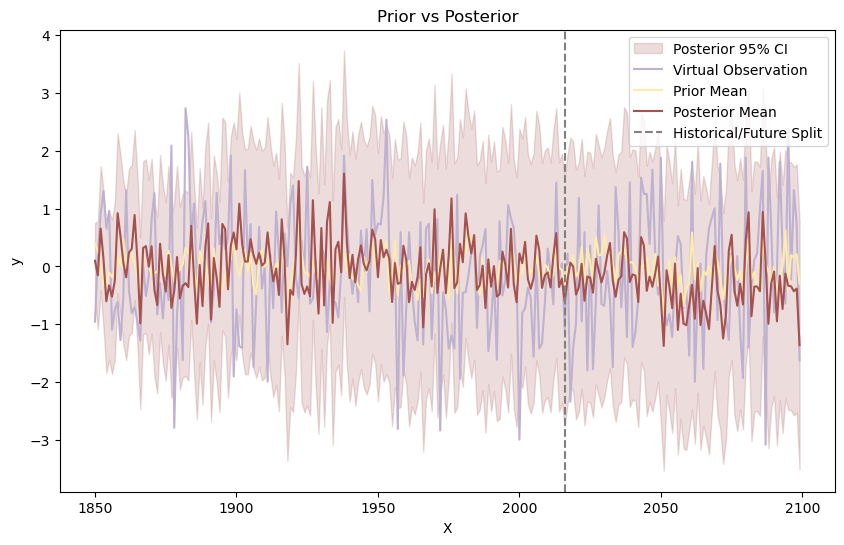

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -3.433e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.612e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.257e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.704e+0 |  0.6

Optimization Progress (iteration 3):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -4.315e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2231.0317251699635
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 3 - test lml: -1430.2329822235079


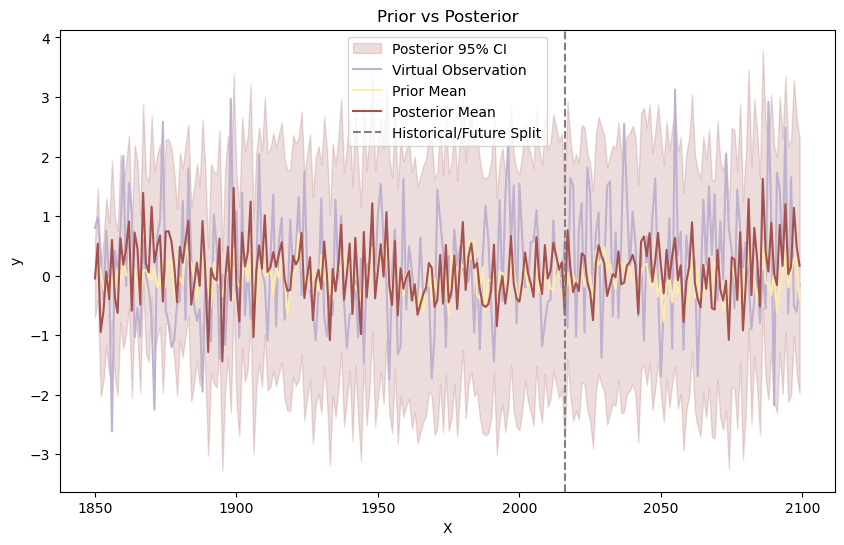

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.537e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.136e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.734e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.079e+0 |  0.6

Optimization Progress (iteration 4):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -3.654e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1972.8051463835086
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 4 - test lml: -1991.6265342126992


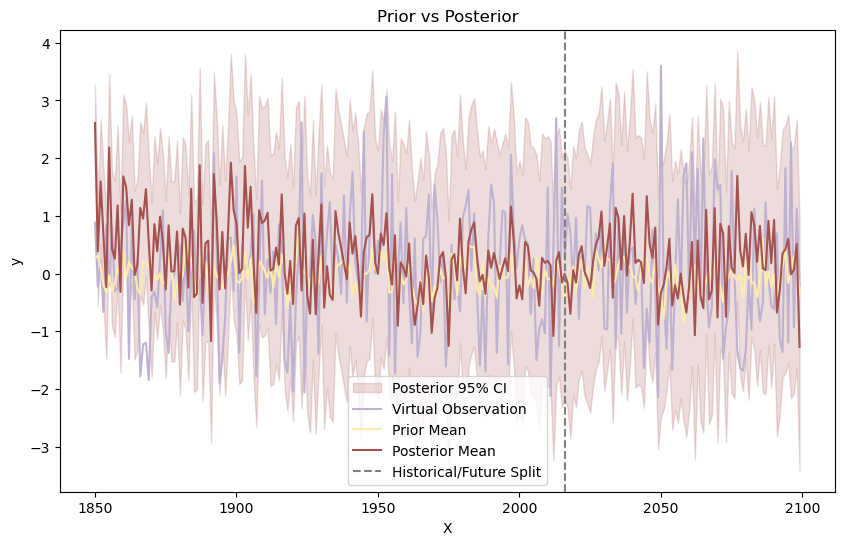

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.705e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.193e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.3e+06  |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.304e+0 |  0.6

Optimization Progress (iteration 5):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -4.301e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1981.7869089347985
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 5 - test lml: -1306.3751414403764


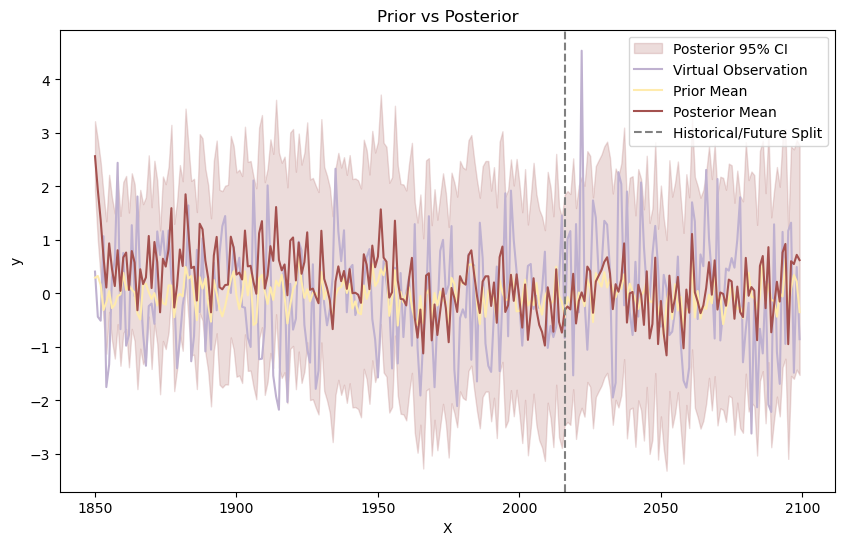

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.993e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.494e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.217e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.611e+0 |  0.6

Optimization Progress (iteration 6):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.842e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -2071.960147403263
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 6 - test lml: -1416.7731053944447


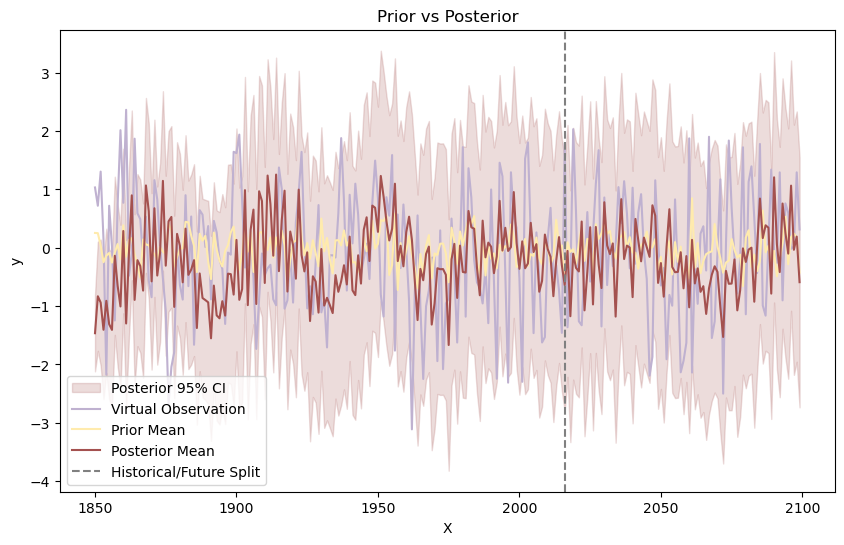

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.719e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.37e+06 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.408e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.541e+0 |  0.6

Optimization Progress (iteration 7):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.987e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -2000.5756929351962
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 7 - test lml: -1543.8089372891313


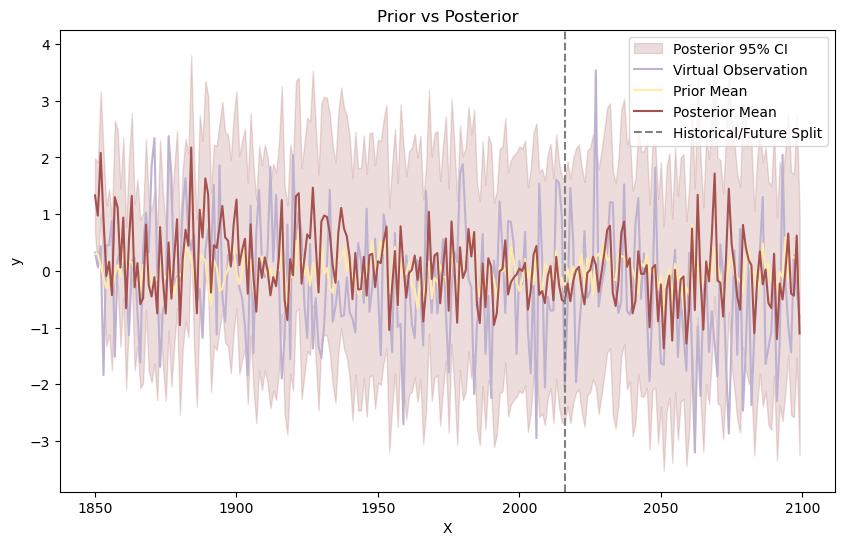

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.65e+06 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.454e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.592e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.805e+0 |  0.6

Optimization Progress (iteration 8):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -4.714e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -2079.9293908780282
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 8 - test lml: -1275.9817168526192


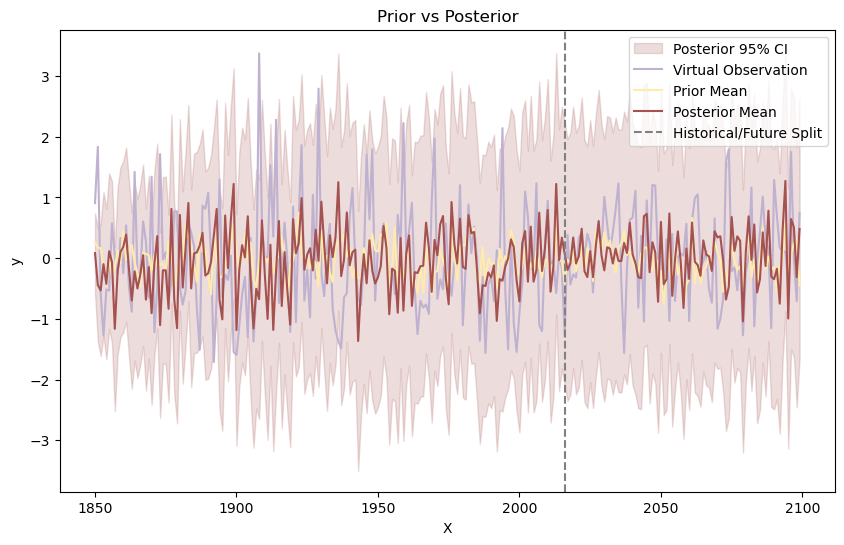

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.532e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.135e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.69e+06 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -6.913e+0 |  0.6

Optimization Progress (iteration 9):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.641e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1951.6208976570958
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 9 - test lml: -1980.7479048003022


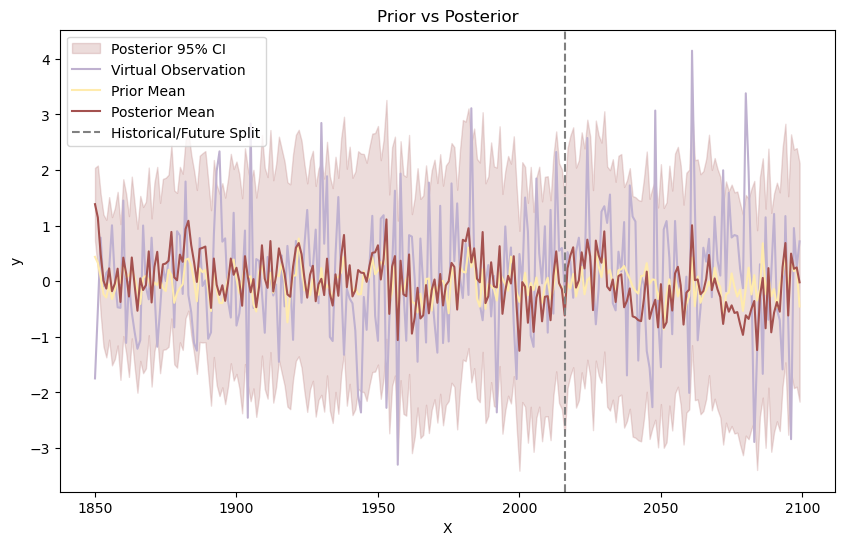

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.681e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.234e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.996e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.581e+0 |  0.6

Optimization Progress (iteration 10):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -3.812e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1995.8023099206234
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 10 - test lml: -1743.411418793219


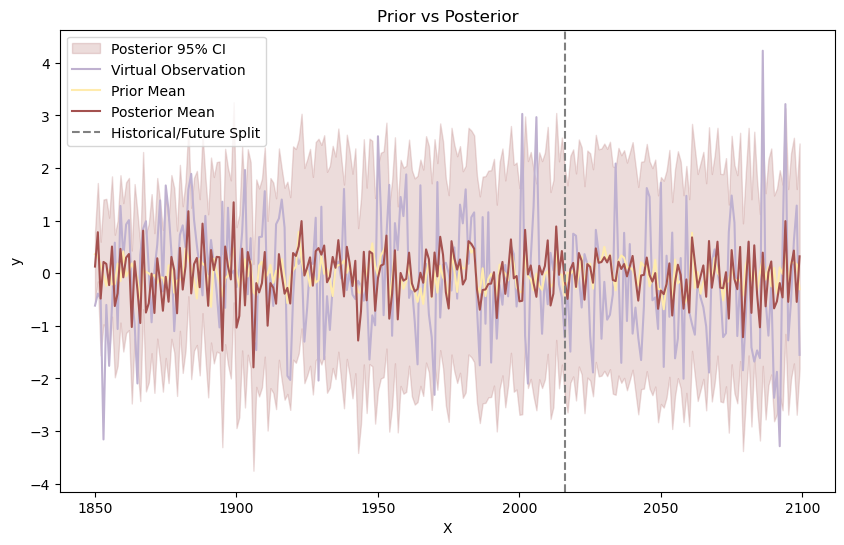

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.531e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.127e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.633e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -6.919e+0 |  0.6

Optimization Progress (iteration 11):   0%|          | 0/100 [00:13<?, ?it/s]

|  50       | -3.641e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1955.234149061566
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 11 - test lml: -1536.214344001567


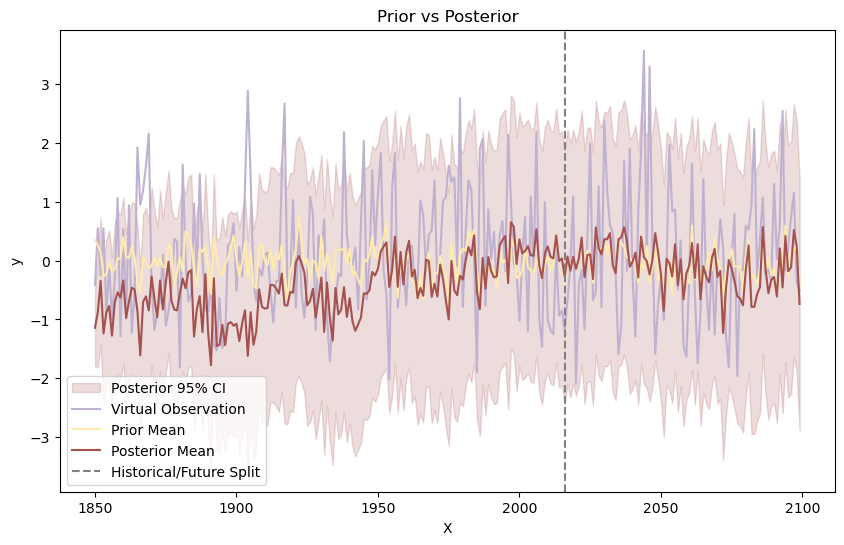

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.946e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.48e+06 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -6.098e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -8.329e+0 |  0.6

Optimization Progress (iteration 12):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -4.362e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -2165.6417298921656
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 12 - test lml: -1415.4443068143644


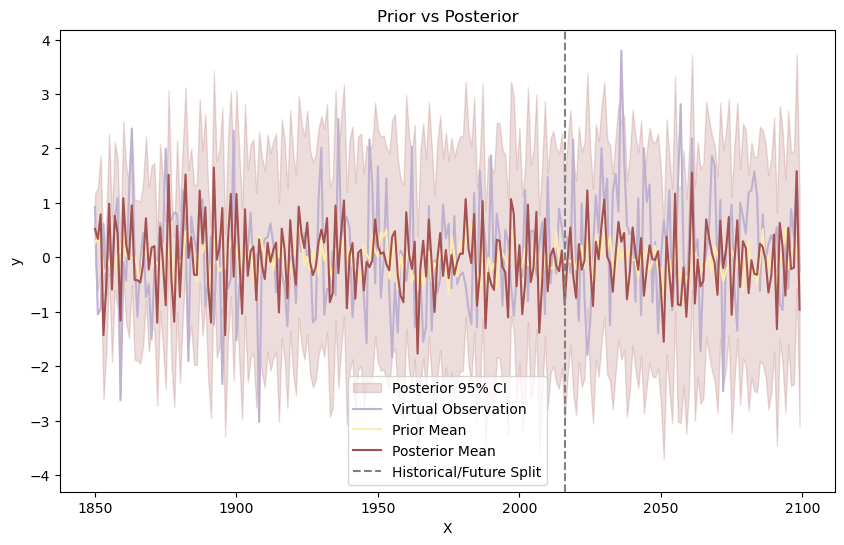

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.786e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.124e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.023e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.403e+0 |  0.6

Optimization Progress (iteration 13):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.716e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -2017.2728851716581
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 13 - test lml: -1570.713847022754


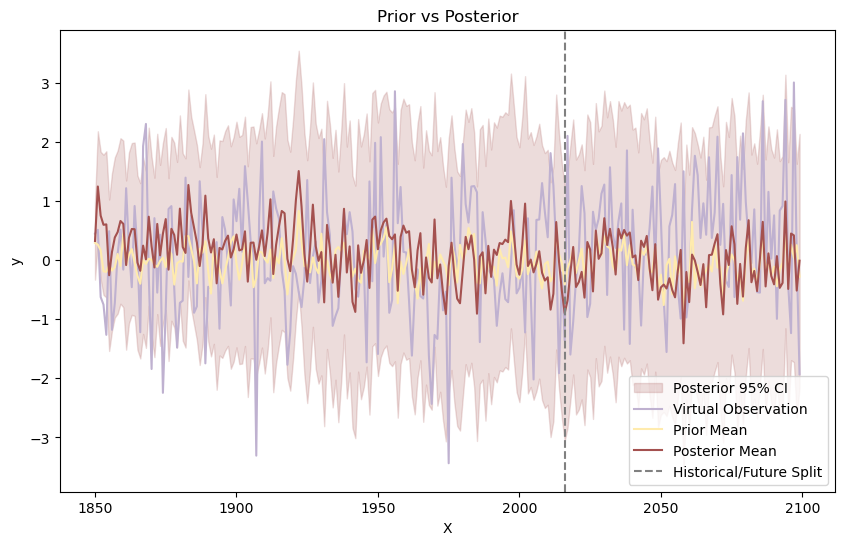

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.704e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.372e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -4.947e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.342e+0 |  0.6

Optimization Progress (iteration 14):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -4.171e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -2024.8231392439602
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 14 - test lml: -1675.5842349279094


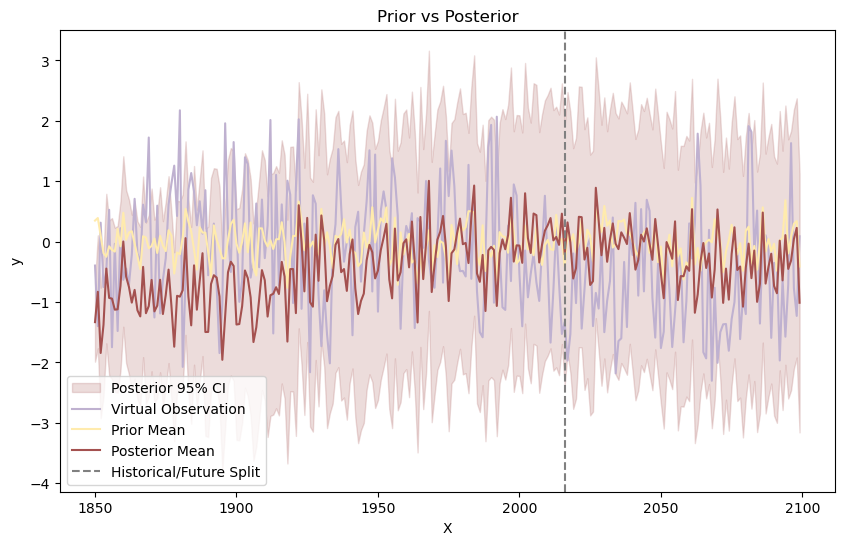

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.983e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.201e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.237e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.813e+0 |  0.6

Optimization Progress (iteration 15):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.766e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2088.281566976345
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 15 - test lml: -1348.4460823096917


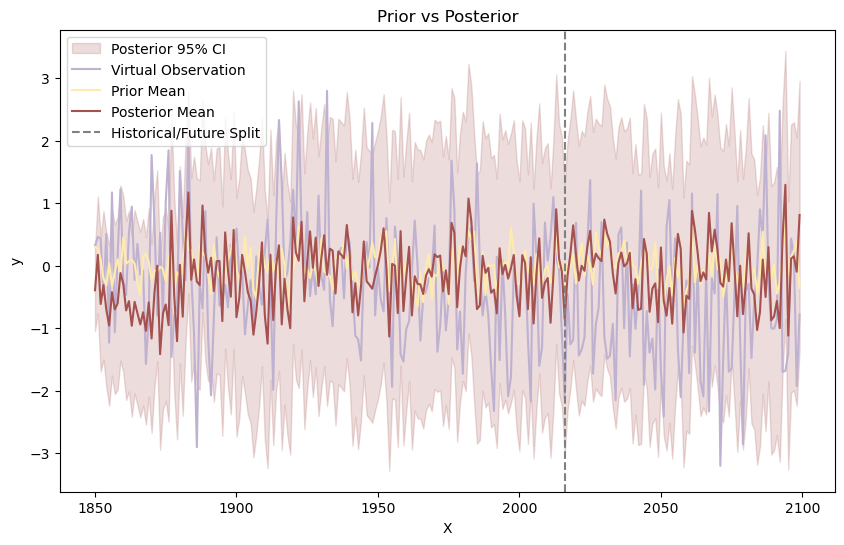

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.653e+0 |  0.1539   |  0.1585   |  0.9855   |  0.9046   |  0.1869   |  27.5     |  0.3341   |  1.789    |  4.006    |  5.541    |  5.319    |  61.88    |  36.78    |  25.82    |
|  2        | -2.168e+0 |  0.1952   |  0.553    |  0.8258   |  0.5039   |  0.6879   |  76.2     |  0.6423   |  1.27     |  3.32     |  6.23     |  6.246    |  5.092    |  59.43    |  96.83    |
|  3        | -5.025e+0 |  0.9862   |  0.82     |  0.6902   |  0.6236   |  0.5996   |  68.48    |  0.8387   |  1.42     |  5.191    |  6.826    |  4.136    |  48.44    |  81.32    |  60.69    |
|  4        | -7.049e+0 |  0.6

Optimization Progress (iteration 16):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -3.699e+0 |  0.8541   |  0.3057   |  0.1377   |  0.9616   |  0.6426   |  90.95    |  0.4688   |  1.856    |  3.157    |  4.96     |  5.472    |  23.71    |  93.81    |  21.05    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -2053.212102400456
Best kernel is: 0.654**2 * CustomPolynomialKernel() + 0.308**2 * RationalQuadratic(alpha=47.7, length_scale=74.2) + 0.527**2 * Matern(length_scale=2.97, nu=0.879) + 0.691**2 * RBF(length_scale=47.1) + WhiteKernel(noise_level=0.47)


Iteration 16 - test lml: -1153.241564102976


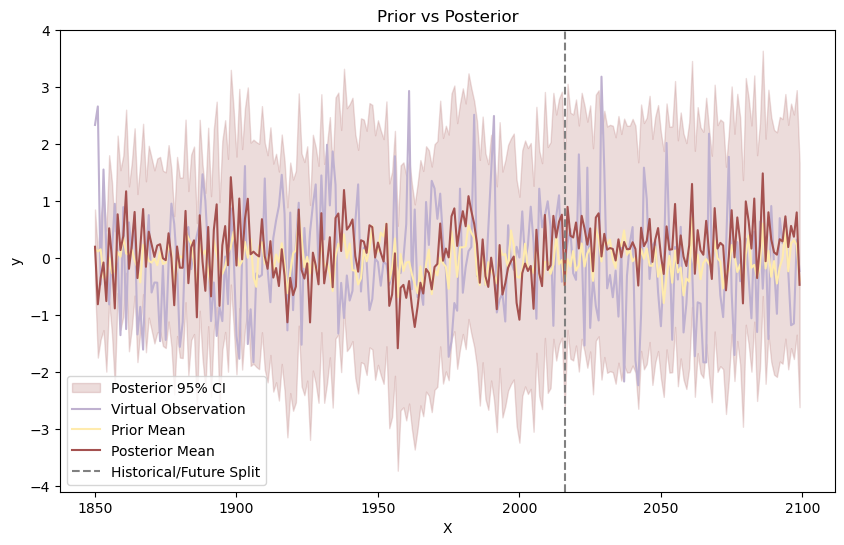

Total log marginal likelihood sum for the kernel structure: -24620.926721802436


-24620.926721802436

In [14]:
def polype3_rq_matern_rbf(best_params):
    custom_poly_kernel = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=[best_params['period1'], best_params['period2'], best_params['period3']])
    original_kernel = (
        C(best_params['constant2']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant3']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant4']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return custom_poly_kernel + original_kernel

pbounds = {
    'period1': (3,7),
    'period2': (3,7),
    'period3': (3,7),
    'rq_alpha': (1e-2, 1e2),
    'matern_length': (1e0, 1e2),
    'noise_level': (1e-6, 1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 1),
    'constant5': (1e-3, 1),
    'rbf_length': (1e-2, 1e2),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 1e2)
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, polype3_rq_matern_rbf)

-24620.926721802436

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.308e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.353e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.277e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 1):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.224e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -1735.633502820097
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 1 - test lml: -841.8154269255672


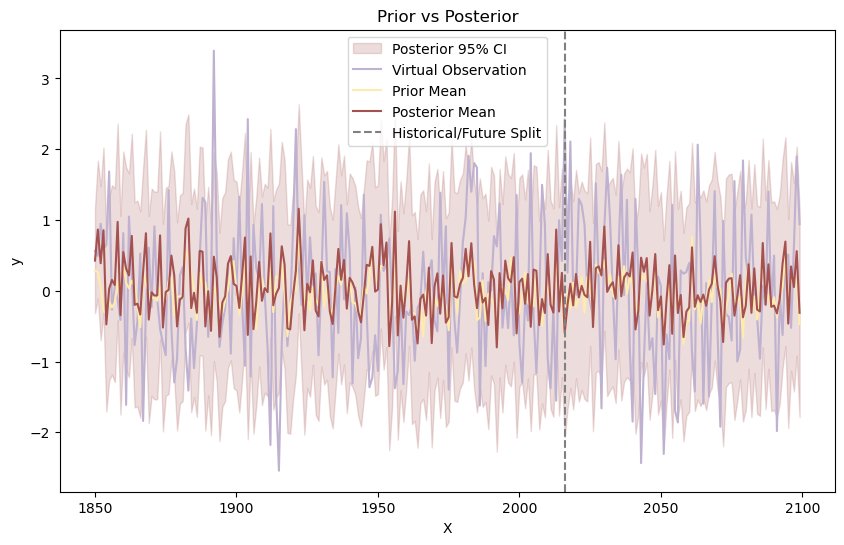

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.139e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.095e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.664e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 2):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -6.915e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1621.7460815953964
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 2 - test lml: -807.9894263658546


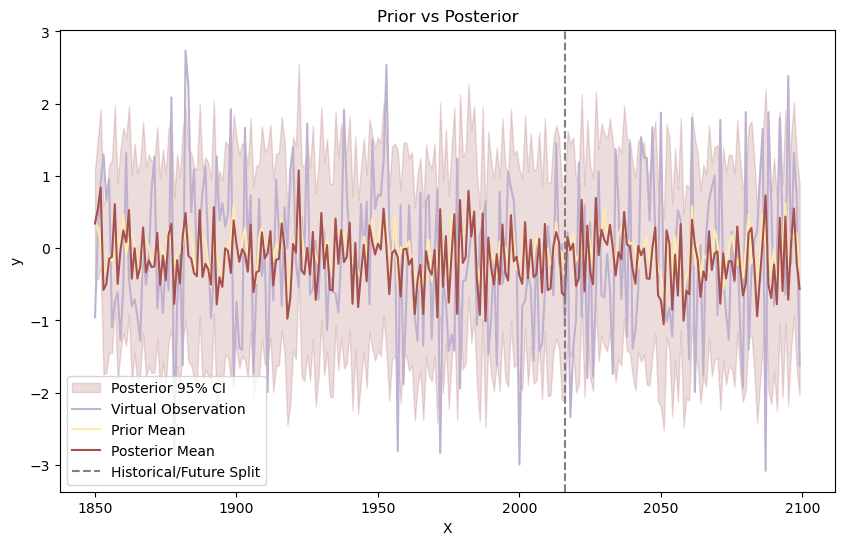

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.436e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.898e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.376e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 3):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -8.361e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -1726.6141997636764
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 3 - test lml: -789.2223069509589


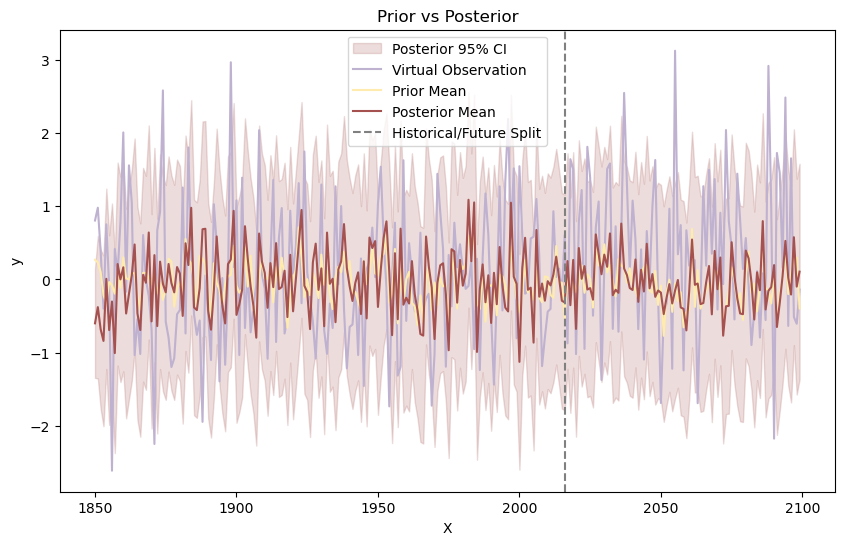

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.062e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.001e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.515e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 4):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -6.877e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1608.9328779773482
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 4 - test lml: -961.970703965688


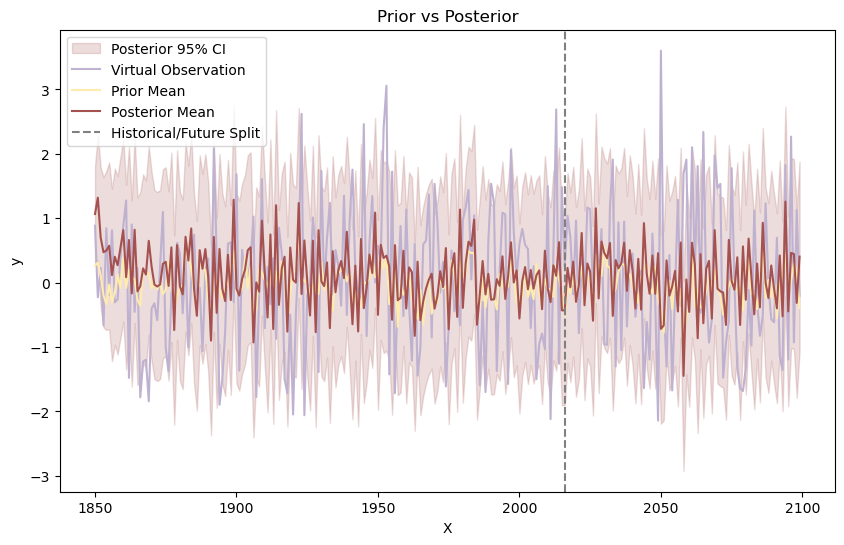

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.117e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.13e+04 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.821e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 5):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.155e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1634.0443189552439
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 5 - test lml: -767.1694968520842


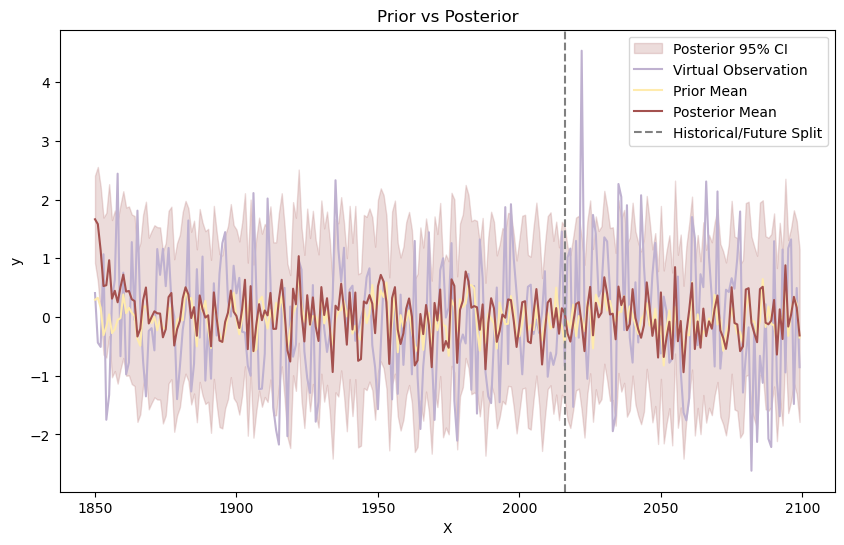

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.273e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.466e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.903e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 6):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.554e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -1683.2555278527743
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 6 - test lml: -840.7337091624288


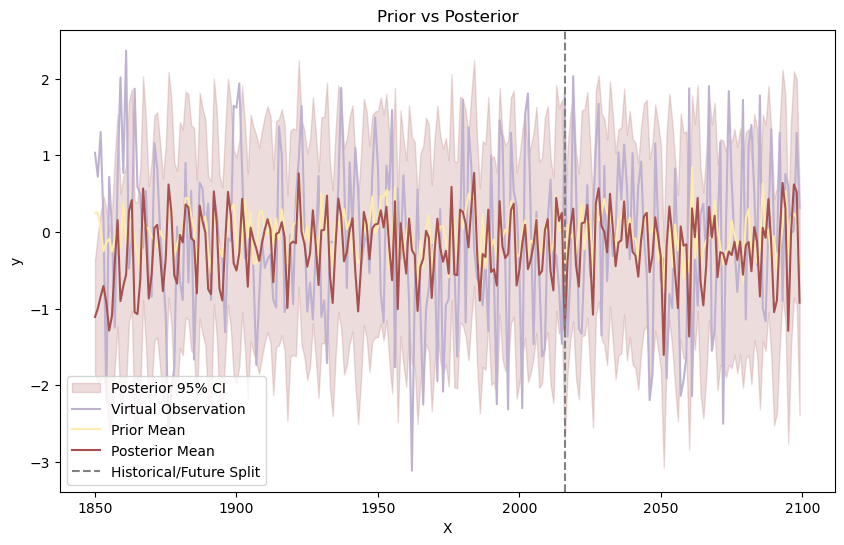

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.127e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.202e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.889e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 7):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.272e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -1673.8411237519533
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 7 - test lml: -916.1934440780506


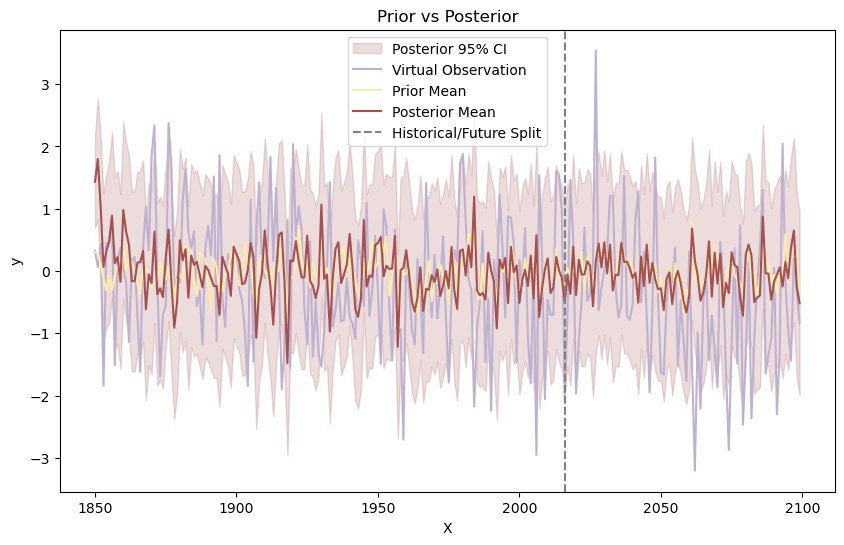

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.209e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.16e+04 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.178e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 8):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.358e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1714.19685199369
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 8 - test lml: -680.8275558391381


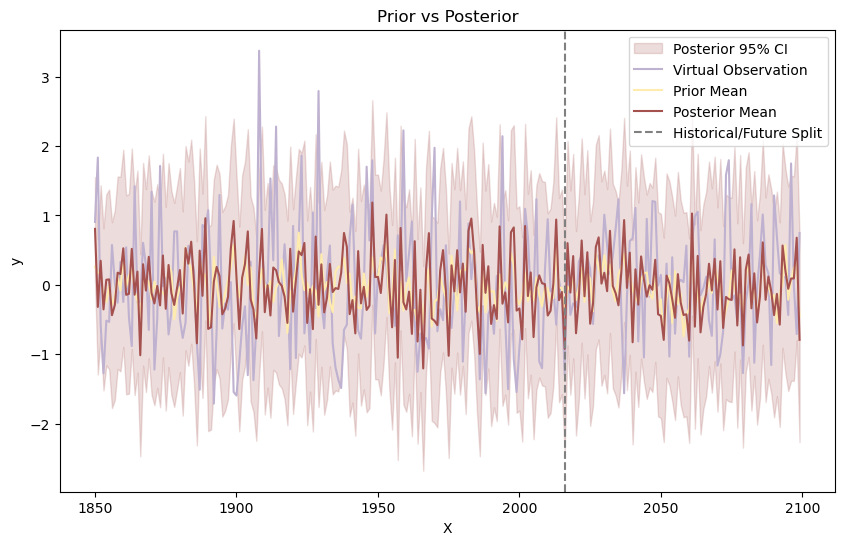

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.053e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -2.953e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.435e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 9):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -6.747e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1589.7086239175728
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 9 - test lml: -1054.5849883213948


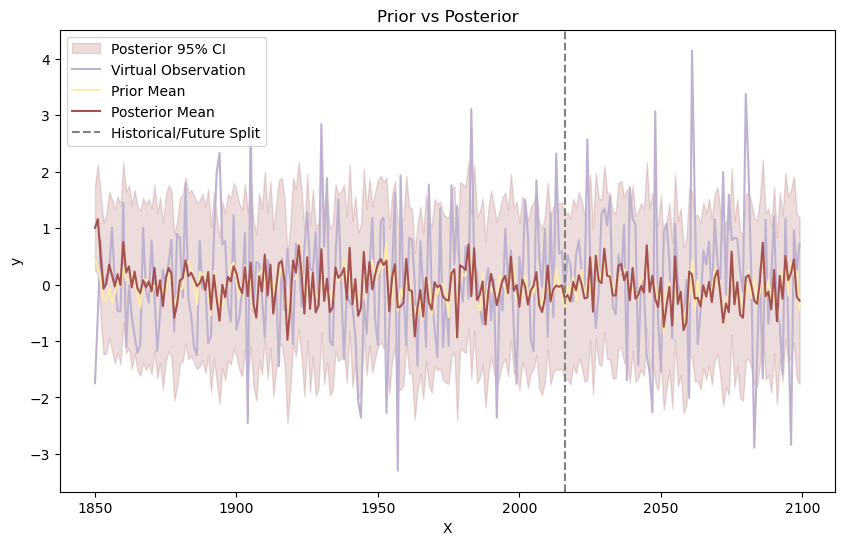

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.173e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.255e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.8e+03  |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 10):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.582e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1620.757523155442
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 10 - test lml: -893.8854748980937


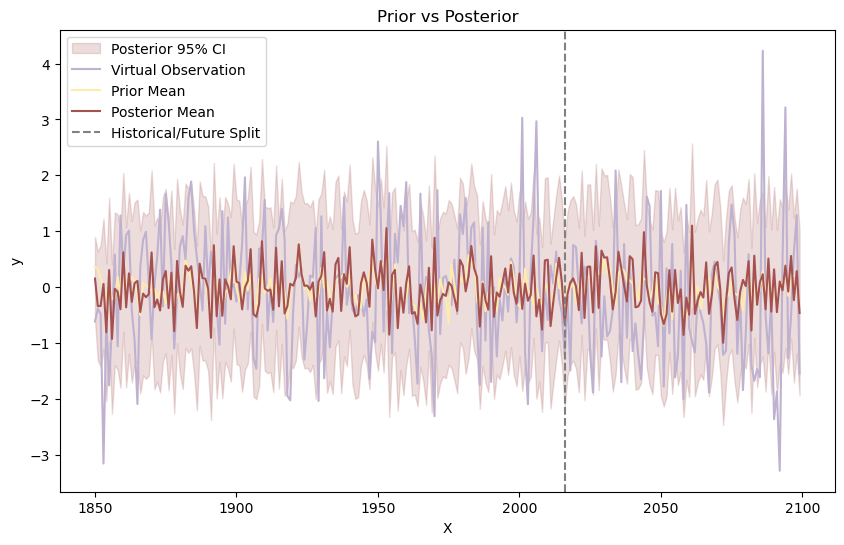

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.055e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -2.954e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.438e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 11):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -6.679e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1593.237180836658
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 11 - test lml: -730.7221980747659


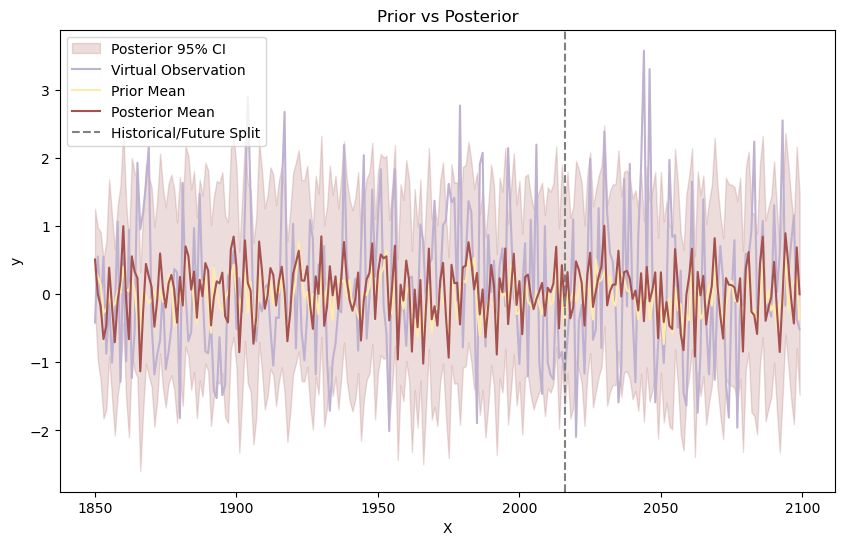

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.318e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.573e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -5.154e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 12):   0%|          | 0/100 [00:12<?, ?it/s]

|  50       | -8.293e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 12 - Best objective function value: -1735.6830302522783
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 12 - test lml: -918.4127565450076


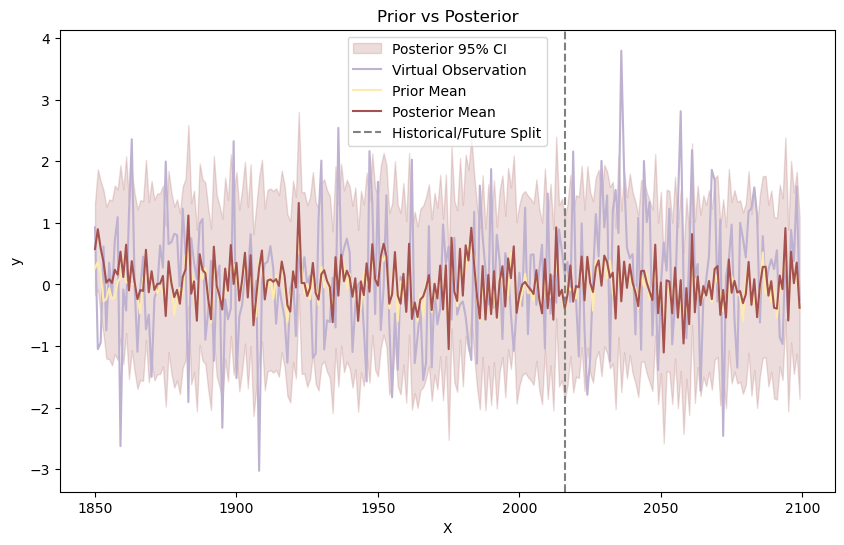

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.141e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.183e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.6e+03  |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 13):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.381e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1597.6873309899468
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 13 - test lml: -859.6788234480589


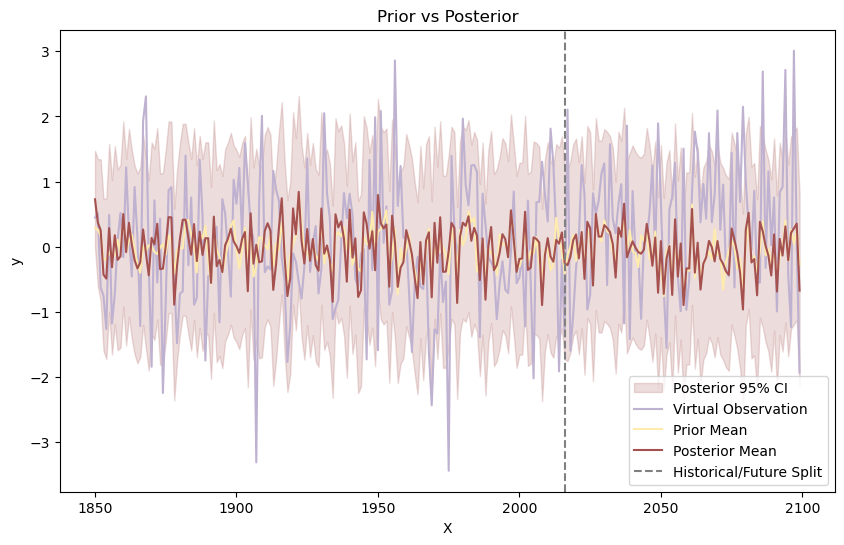

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.151e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.226e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.874e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 14):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.292e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 14 - Best objective function value: -1694.137394941992
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 14 - test lml: -806.0838955532845


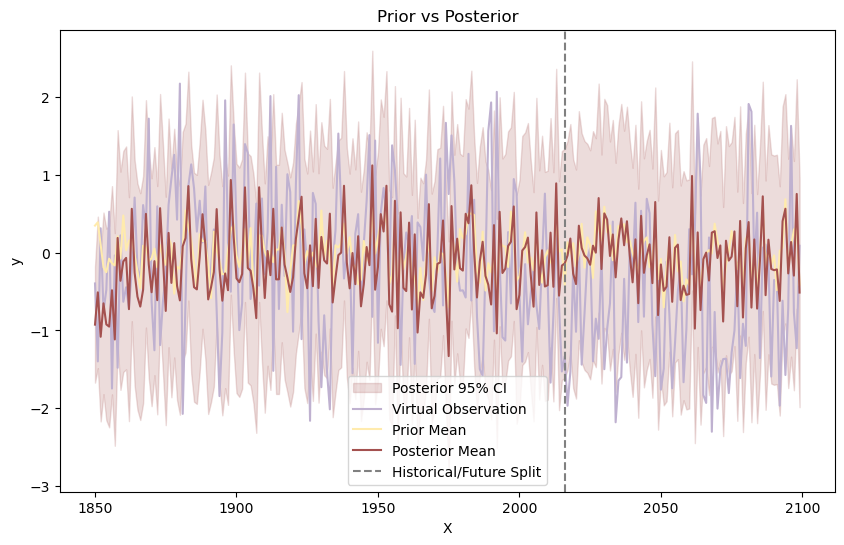

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.312e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.505e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.866e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 15):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.955e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -1636.7461418957214
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 15 - test lml: -750.7961300652505


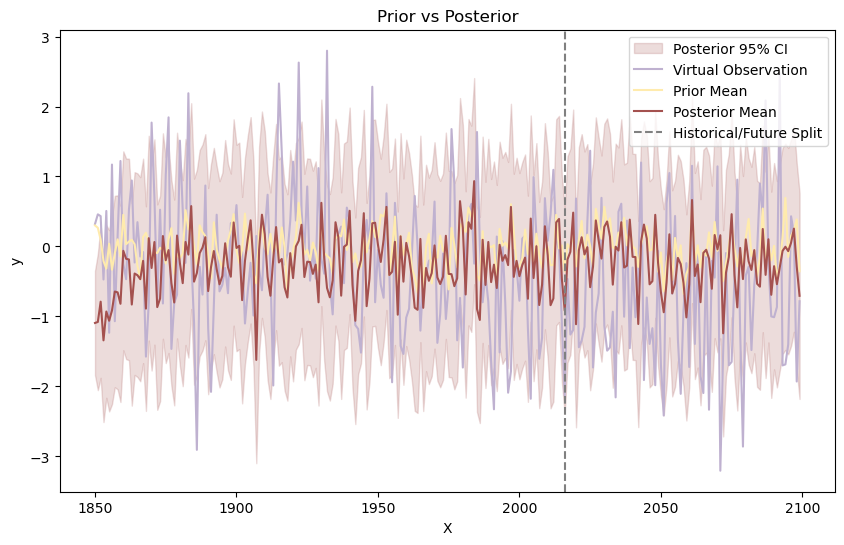

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | constant1 | constant2 | constant3 | constant4 | constant5 | constant6 | matern... | noise_... |    nu     |  period1  |  period2  |  period3  | rbf_le... | rq_alpha  |   rq_ls   |
-------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------------
|  1        | -2.131e+0 |  0.1539   |  0.1585   |  0.9855   |  0.4523   |  0.09385  |  0.1346   |  4.006    |  0.6446   |  1.003    |  5.541    |  5.319    |  5.475    |  3.684    |  0.2656   |  1.952    |
|  2        | -3.085e+0 |  0.553    |  0.8258   |  0.5039   |  0.3441   |  0.38     |  0.3215   |  4.465    |  0.0801   |  2.115    |  6.246    |  3.203    |  5.377    |  9.683    |  0.9864   |  8.2      |
|  3        | -4.548e+0 |  0.6902   |  0.6236   |  0.5996   |  0.3411   |  0.4195   |  0.2305   |  5.93     |  0.9565   |  1.068    |  4.937    |  6.253    |  5.427    |  6.355

Optimization Progress (iteration 16):   0%|          | 0/100 [00:11<?, ?it/s]

|  50       | -7.134e+0 |  0.009512 |  0.7603   |  0.4021   |  0.2557   |  0.2534   |  0.3674   |  9.441    |  0.16     |  2.396    |  6.92     |  5.391    |  3.421    |  8.066    |  0.06212  |  5.811    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1607.7642182887898
Best kernel is: 0.209**2 * CustomPolynomialKernel() + 0.984**2 * CustomPolynomialKernel() + 0.798**2 * CustomPolynomialKernel() + 0.212**2 * RationalQuadratic(alpha=0.541, length_scale=6.4) + 0.64**2 * Matern(length_scale=6.97, nu=0.79) + 0.254**2 * RBF(length_scale=0.66) + WhiteKernel(noise_level=0.894)


Iteration 16 - test lml: -631.5980253381019


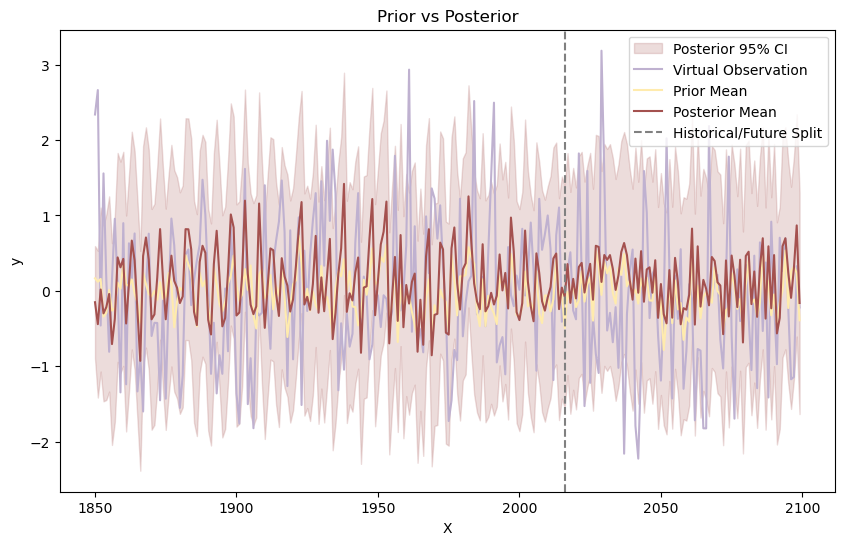

Total log marginal likelihood sum for the kernel structure: -13251.684362383727


-13251.684362383727

In [15]:
def polype3_rq_matern_rbf_true(best_params):
    custom_poly_kernel1 = C(best_params['constant1']) * CustomPolynomialKernel(degree=2, periods=best_params['period1'])
    custom_poly_kernel2 = C(best_params['constant2']) * CustomPolynomialKernel(degree=2, periods=best_params['period2'])
    custom_poly_kernel3 = C(best_params['constant3']) * CustomPolynomialKernel(degree=2, periods=best_params['period3'])
    
    original_kernel = (
        C(best_params['constant4']) * RQ(length_scale=best_params['rq_ls'], alpha=best_params['rq_alpha']) +
        C(best_params['constant5']) * Matern(length_scale=best_params['matern_length'], nu=best_params['nu']) +
        C(best_params['constant6']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    
    return custom_poly_kernel1 + custom_poly_kernel2 + custom_poly_kernel3 + original_kernel

pbounds = {
    'period1':(3,7),
    'period2': (3,7),
    'period3': (3,7),
    'rq_alpha': (1e-2, 1),
    'matern_length': (1e0, 10),
    'noise_level': (1e-6, 1),
    'constant1': (1e-3, 1),
    'constant2': (1e-3, 1),
    'constant3': (1e-3, 1),
    'constant4': (1e-3, 0.5),
    'constant5': (1e-3, 0.5),
    'constant6': (1e-3, 0.5),
    'rbf_length': (1e-2, 10),
    'nu': (0.5, 2.5),
    'rq_ls': (1e-2, 10)
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, polype3_rq_matern_rbf_true)


-13251.684362383727

## original RBF kernel

Starting iteration 1 out of 16


Optimization Progress (iteration 1):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.54e+07 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.837e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.699e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.467e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.056e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.802e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.567e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.219e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.296e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.202e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.347e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.451e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.228e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.433e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 1):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 1 - Best objective function value: -2000.2961874557868
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 1 - test lml: -339.09518291190324


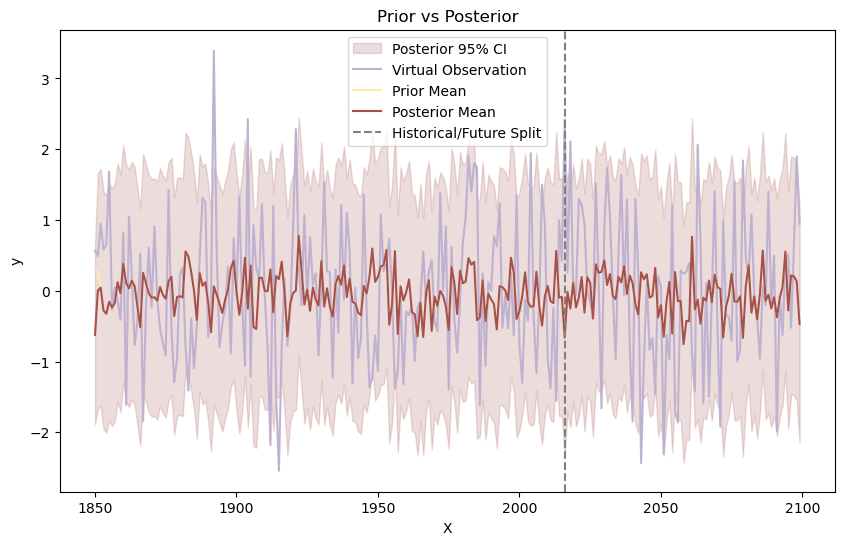

Starting iteration 2 out of 16


Optimization Progress (iteration 2):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.923e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.789e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.674e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.634e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -1.88e+06 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.087e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.727e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.445e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.503e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.428e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.542e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.818e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.077e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.609e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 2):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 2 - Best objective function value: -1978.7018771187409
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 2 - test lml: -356.3281612473323


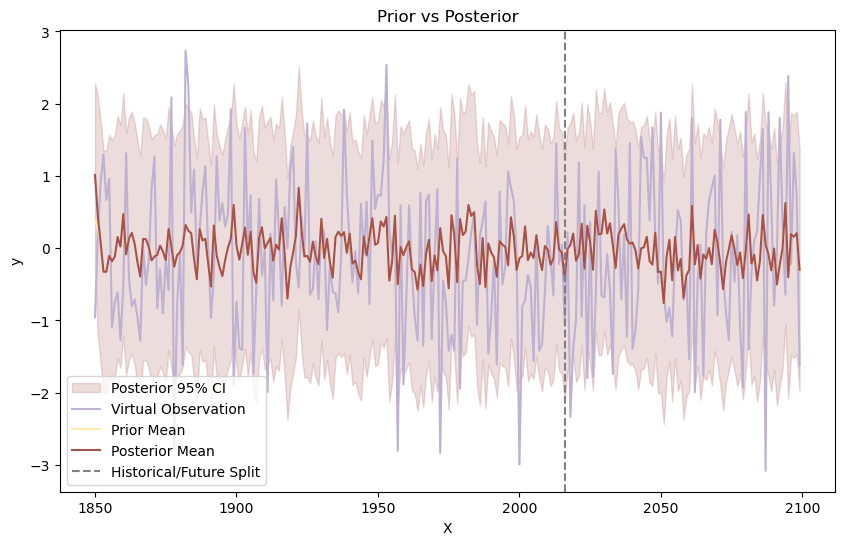

Starting iteration 3 out of 16


Optimization Progress (iteration 3):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.458e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.059e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.956e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.111e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.771e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.33e+07 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.252e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.062e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.913e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.045e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.971e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.981e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.314e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.074e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 3):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 3 - Best objective function value: -2019.4116634767493
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 3 - test lml: -369.3695290753758


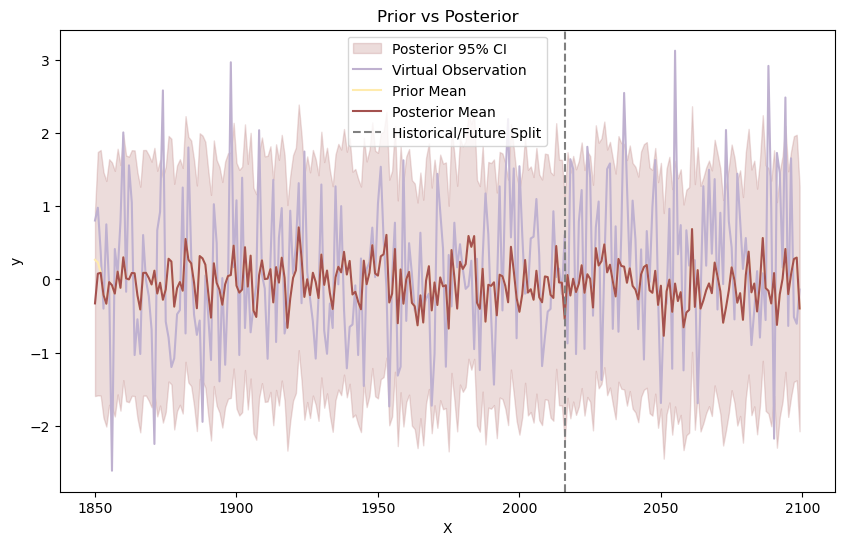

Starting iteration 4 out of 16


Optimization Progress (iteration 4):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.756e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.715e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.601e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.473e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.071e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -3.926e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.579e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.335e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.328e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.32e+07 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.37e+07 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.608e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -1.997e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.445e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 4):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 4 - Best objective function value: -1973.914271957729
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 4 - test lml: -480.0233478130945


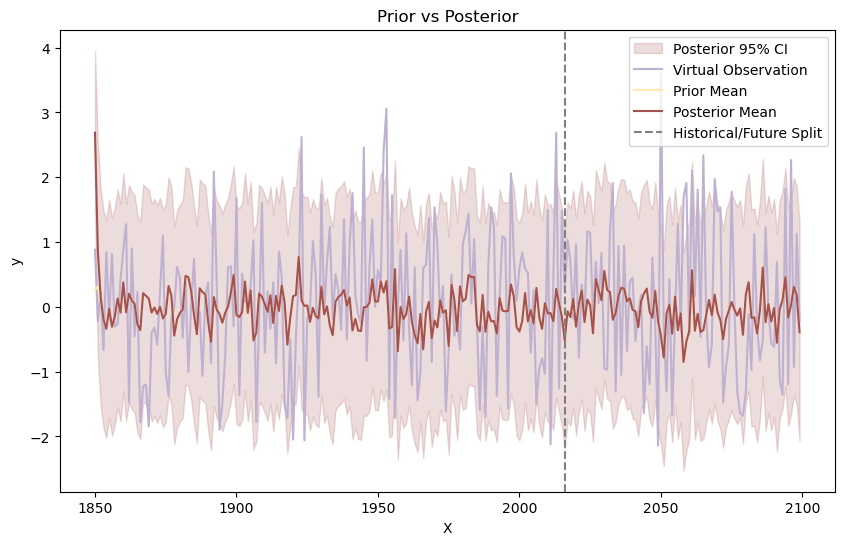

Starting iteration 5 out of 16


Optimization Progress (iteration 5):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.444e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.85e+07 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.717e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.009e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.156e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.37e+07 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.114e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.881e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.863e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.864e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.906e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.909e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.14e+07 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.982e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 5):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 5 - Best objective function value: -1982.9045728940064
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 5 - test lml: -267.2933772925339


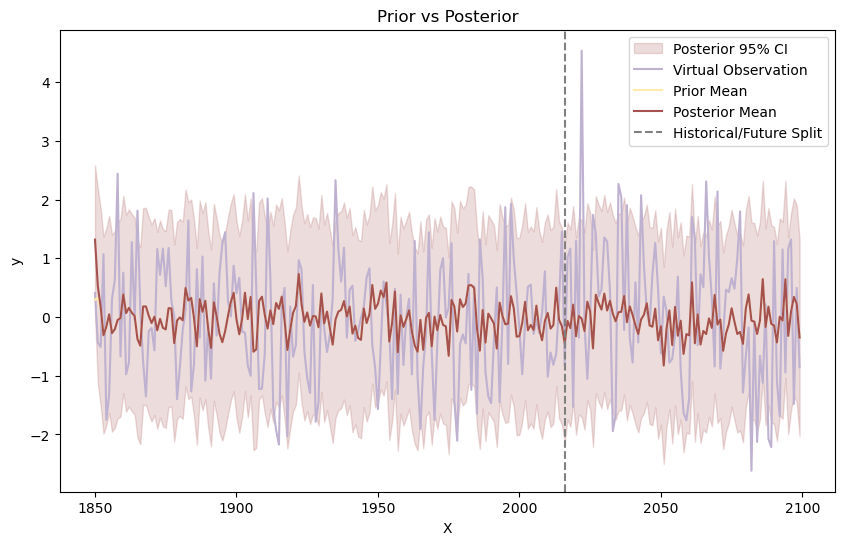

Starting iteration 6 out of 16


Optimization Progress (iteration 6):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.367e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -2.089e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.937e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.997e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.15e+06 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.435e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.127e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.958e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.834e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.944e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.88e+07 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.072e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.405e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.964e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 6):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -1.091e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -5.902e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 6 - Best objective function value: -1994.1225030573842
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 6 - test lml: -306.3957013245868


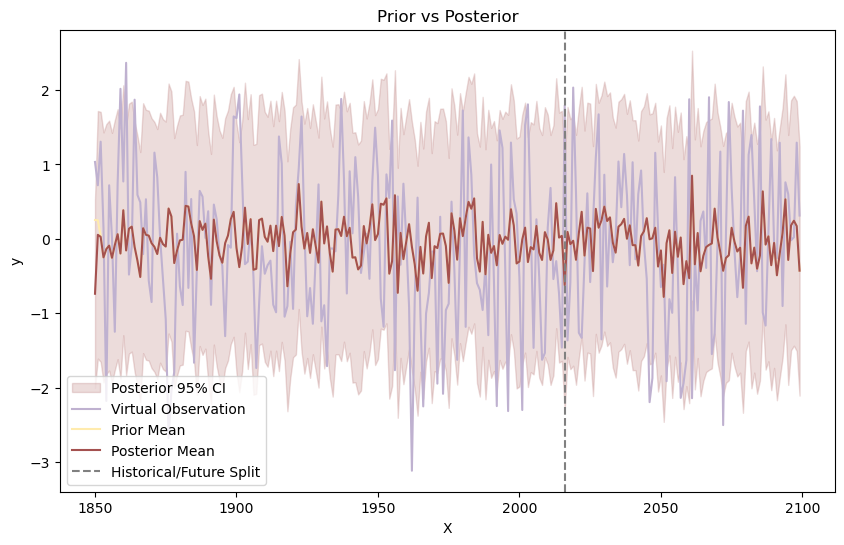

Starting iteration 7 out of 16


Optimization Progress (iteration 7):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.46e+07 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.943e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.821e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.966e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.008e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.267e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.105e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.982e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.784e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.966e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.836e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.865e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.214e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.928e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 7):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.807e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.053e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -5.914e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 7 - Best objective function value: -1984.9299047118375
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 7 - test lml: -357.43257989307097


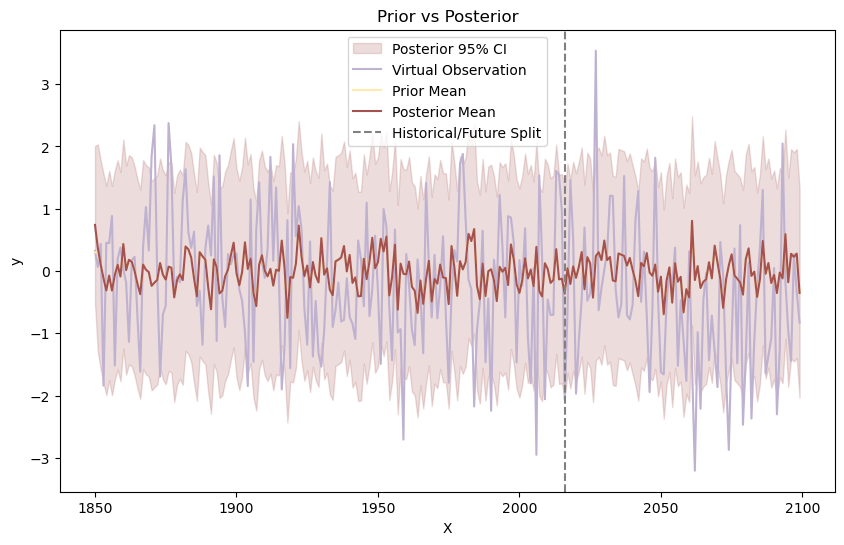

Starting iteration 8 out of 16


Optimization Progress (iteration 8):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.614e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.788e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.668e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.365e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.26e+06 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.661e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.465e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.279e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.242e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.26e+07 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.276e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.134e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.117e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.339e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 8):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.996e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.028e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -6.218e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 8 - Best objective function value: -1998.1599531965835
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 8 - test lml: -294.44580251767434


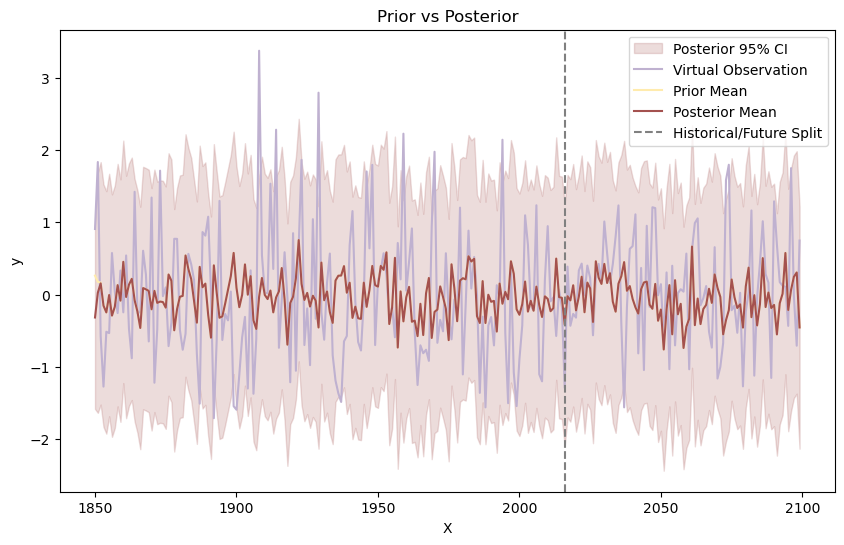

Starting iteration 9 out of 16


Optimization Progress (iteration 9):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.742e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.707e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.595e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.437e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.062e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -3.895e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.541e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.314e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.299e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.299e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.339e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.584e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -1.984e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.41e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 9):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.584e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -9.765e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -5.258e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 9 - Best objective function value: -1964.9256277581003
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 9 - test lml: -463.9173533159117


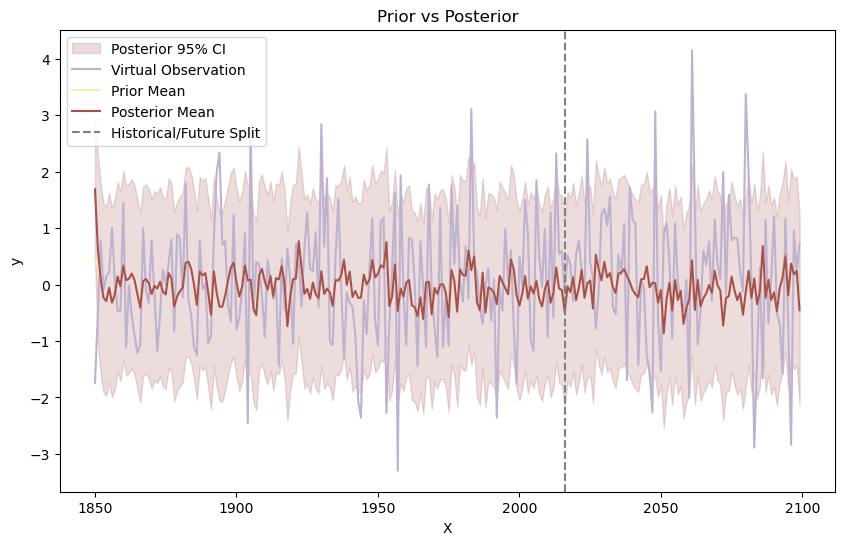

Starting iteration 10 out of 16


Optimization Progress (iteration 10):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.033e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.87e+07 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.736e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.743e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.625e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.216e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.835e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.593e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.623e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.58e+07 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.658e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.814e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.188e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.721e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 10):   0%|          | 0/100 [00:02<?, ?it/s]

An error occurred during optimization: 'x0' must only have one dimension.
Iteration 10 - Best objective function value: -1986.9991722532193
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 10 - test lml: -449.3090773835152


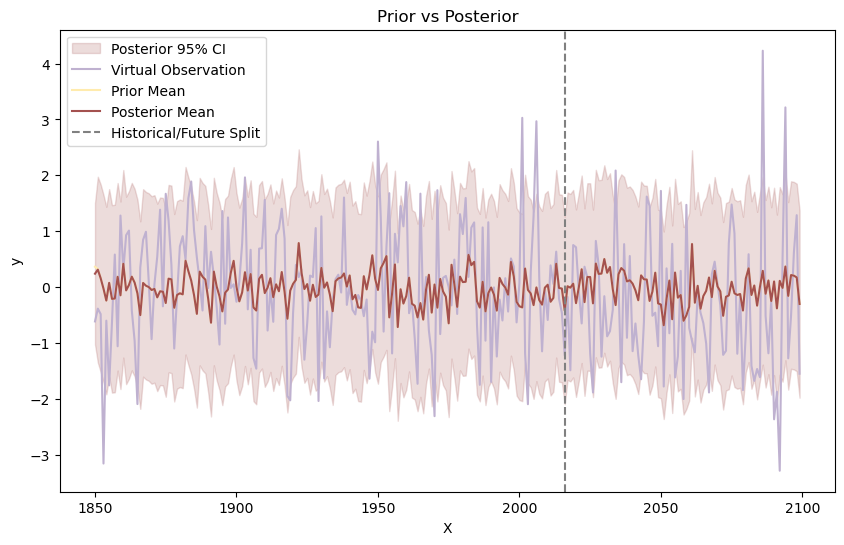

Starting iteration 11 out of 16


Optimization Progress (iteration 11):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.848e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.711e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.6e+07  |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.459e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.041e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -3.902e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.565e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.359e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.314e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.344e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.356e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.596e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -1.984e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.43e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 11):   0%|          | 0/100 [00:02<?, ?it/s]

|  49       | -9.758e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -5.301e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 11 - Best objective function value: -1967.6341452146037
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 11 - test lml: -277.4880043794626


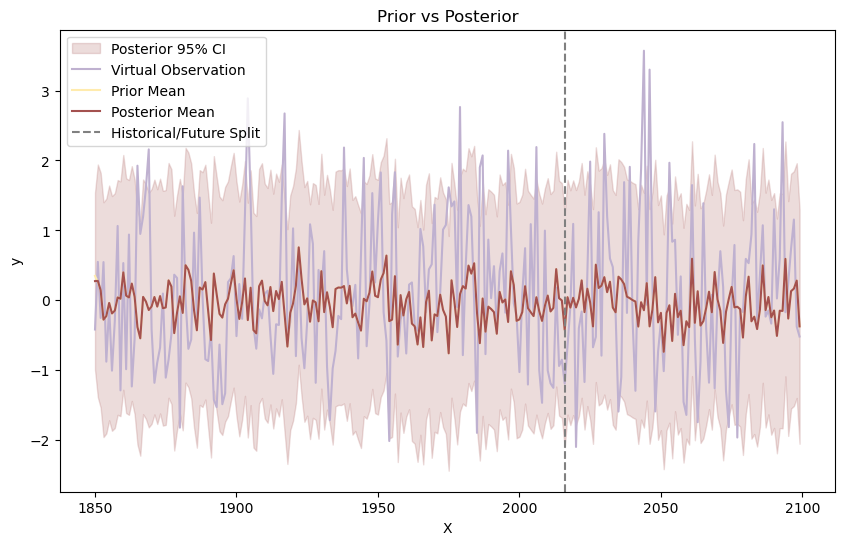

Starting iteration 12 out of 16


Optimization Progress (iteration 12):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.575e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.961e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.845e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -5.283e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.284e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.641e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -5.395e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -6.158e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -5.123e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -6.139e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -5.17e+07 |  0.6902   |  0.6232   |  5.996    |
|  12       | -4.253e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.285e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -5.251e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 12):   0%|          | 0/100 [00:02<?, ?it/s]


Iteration 12 - Best objective function value: -2019.2843684629167
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 12 - test lml: -381.64148253249954


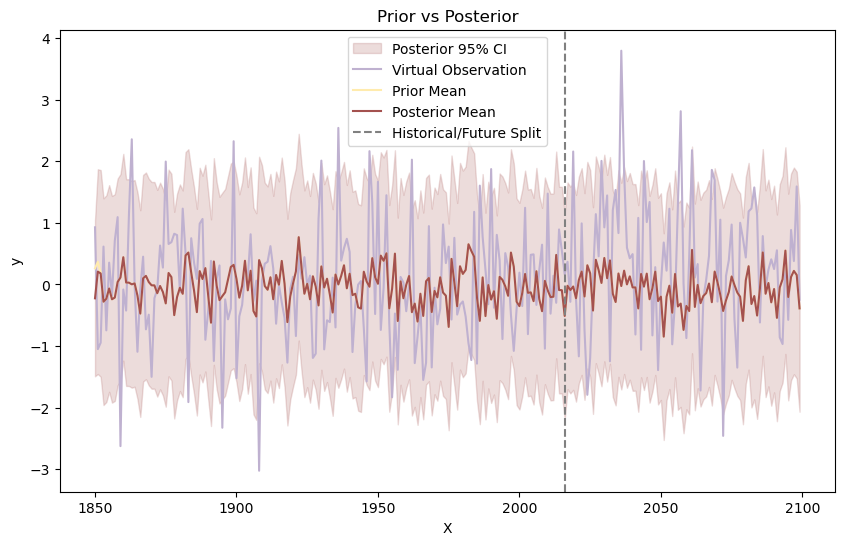

Starting iteration 13 out of 16


Optimization Progress (iteration 13):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.86e+07 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.766e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.665e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.464e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.486e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -3.903e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.572e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.413e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.321e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.398e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.363e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.606e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.033e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.436e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 13):   0%|          | 0/100 [00:02<?, ?it/s]

|  50       | -5.358e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 13 - Best objective function value: -1981.6316345603157
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 13 - test lml: -364.86895566906844


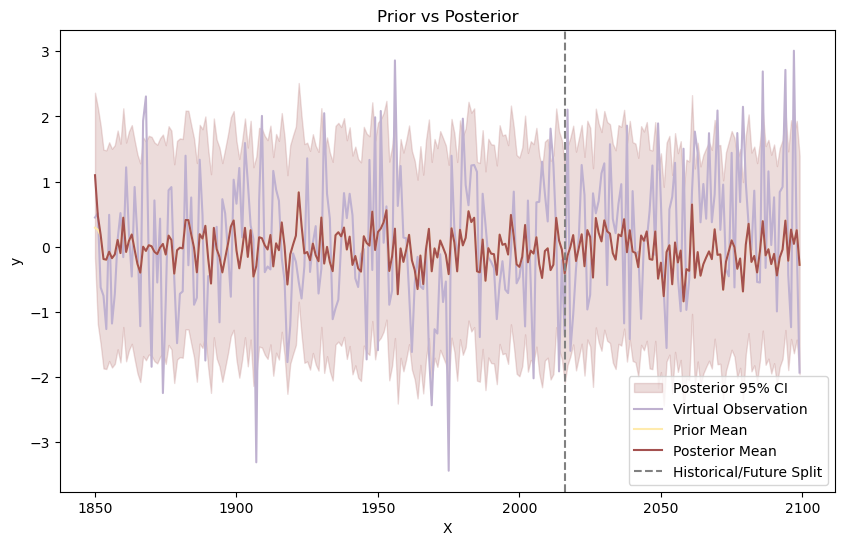

Starting iteration 14 out of 16


Optimization Progress (iteration 14):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -6.351e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.883e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.749e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.798e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.076e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.252e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.904e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.704e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.657e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.683e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.697e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.876e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.18e+07 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.77e+07 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 14):   0%|          | 0/100 [00:02<?, ?it/s]


Iteration 14 - Best objective function value: -1995.4259493246998
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)
Iteration 14 - test lml: -371.8181043181132


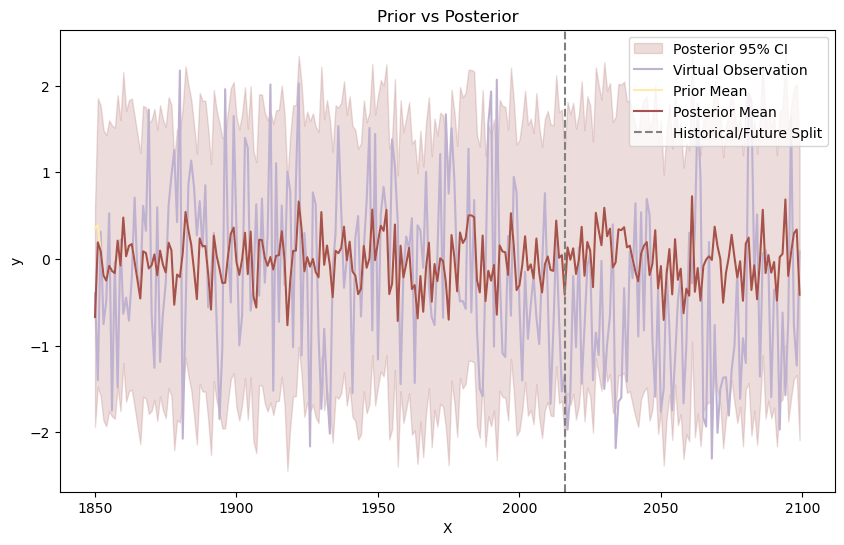

Starting iteration 15 out of 16


Optimization Progress (iteration 15):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.985e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.939e+0 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.811e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.624e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -3.087e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.102e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.736e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.524e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.485e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.509e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.525e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.856e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.262e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.597e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 15):   0%|          | 0/100 [00:02<?, ?it/s]

|  48       | -2.851e+0 |  0.2483   |  0.6635   |  3.333    |
|  49       | -1.136e+0 |  0.89     |  0.3875   |  2.336    |
|  50       | -5.474e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 15 - Best objective function value: -2005.9463207703432
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 15 - test lml: -272.1297361806892


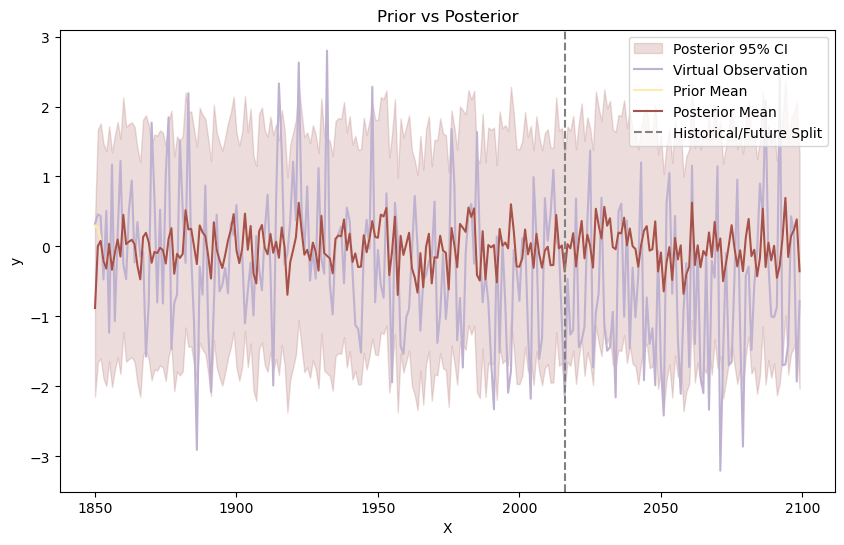

Starting iteration 16 out of 16


Optimization Progress (iteration 16):   0%|          | 0/100 [00:00<?, ?it/s]

|   iter    |  target   | consta... | noise_... | rbf_le... |
-------------------------------------------------------------
|  1        | -5.937e+0 |  0.1539   |  0.1577   |  9.855    |
|  2        | -1.73e+07 |  0.9046   |  0.1861   |  2.684    |
|  3        | -1.617e+0 |  0.3347   |  0.6446   |  2.522    |
|  4        | -4.503e+0 |  0.6356   |  0.5798   |  6.192    |
|  5        | -2.354e+0 |  0.3684   |  0.2582   |  1.952    |
|  6        | -4.016e+0 |  0.553    |  0.8256   |  5.039    |
|  7        | -4.607e+0 |  0.6879   |  0.7595   |  6.427    |
|  8        | -5.508e+0 |  0.3856   |  0.0801   |  8.077    |
|  9        | -4.381e+0 |  0.8117   |  0.05083  |  5.947    |
|  10       | -5.489e+0 |  0.9683   |  0.9862   |  8.2      |
|  11       | -4.415e+0 |  0.6902   |  0.6232   |  5.996    |
|  12       | -3.726e+0 |  0.6819   |  0.8387   |  4.606    |
|  13       | -2.017e+0 |  0.5482   |  0.9565   |  2.847    |
|  14       | -4.477e+0 |  0.4849   |  0.8131   |  6.072    |
|  15   

Optimization Progress (iteration 16):   0%|          | 0/100 [00:02<?, ?it/s]

|  50       | -5.433e+0 |  0.1068   |  0.3373   |  7.317    |
An error occurred during optimization: 'x0' must only have one dimension.
Iteration 16 - Best objective function value: -1984.2269927741522
Best kernel is: 0.856**2 * RBF(length_scale=0.947) + WhiteKernel(noise_level=0.427)


Iteration 16 - test lml: -260.91770919439233


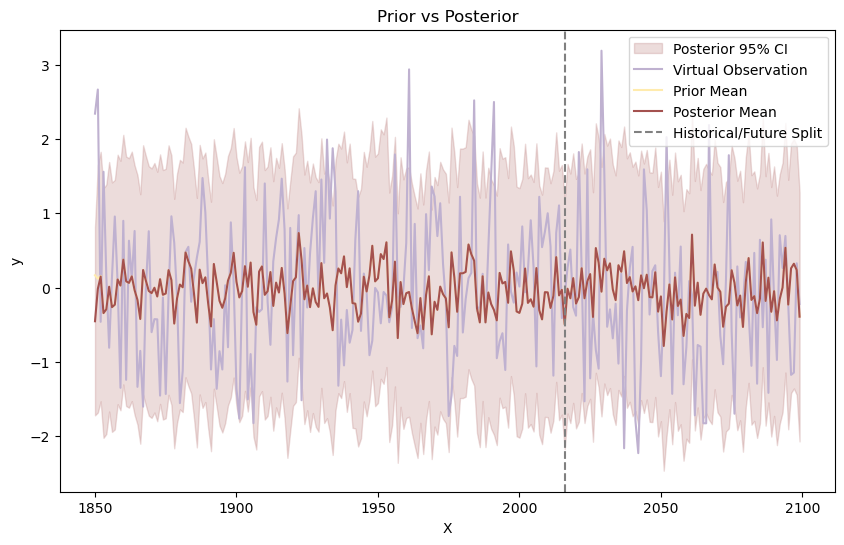

Total log marginal likelihood sum for the kernel structure: -5612.474105049223


-5612.474105049223

In [35]:
def rbf(best_params):
    combined_kernel = (
        C(best_params['constant_rbf']) * RBF(length_scale=best_params['rbf_length']) +
        WhiteKernel(noise_level=best_params['noise_level'])
    )
    return combined_kernel

pbounds = {
    'rbf_length': (1e-2, 10),     # RBF 核函数的 length_scale
    'noise_level': (1e-6, 1),      # WhiteKernel 的噪声水平
    'constant_rbf': (1e-3, 1),     # RBF 核函数的常数乘积项
}

kernel_selection(mod_ids, Nobs, rainfall_yearly, pbounds, rbf)

-5612.474105049223